## Crossover of FRP sum (MW) and Pollutants levels in a time series template over the years or single year

### Portugal

#### All Years

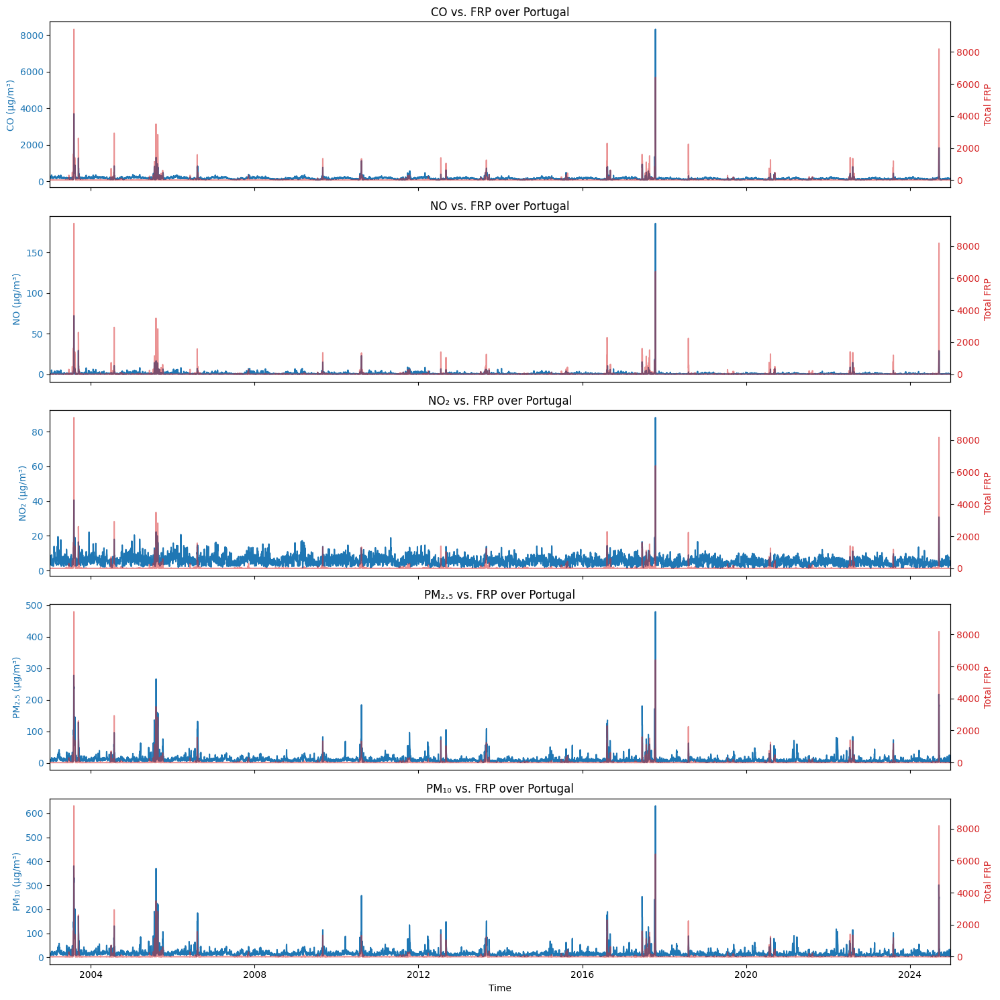

In [1]:
# All Years - Portugal

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Correct units for plotting (CO now in µg/m³)
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Portugal
    frp = ds['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Portugal')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

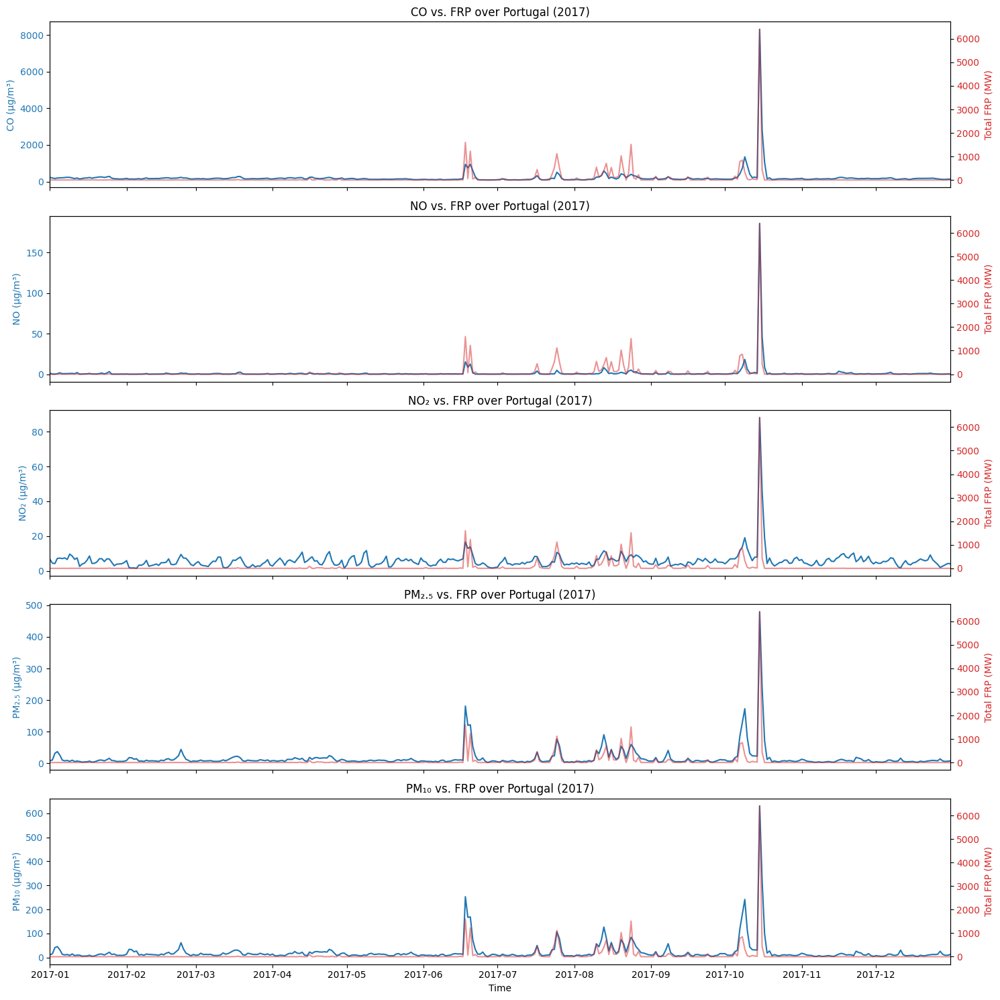

In [2]:
# Certain Year - Portugal

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2017

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Units for each pollutant (CO now in µg/m³)
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Portugal
    frp = ds['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Portugal'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Chosen Year all together

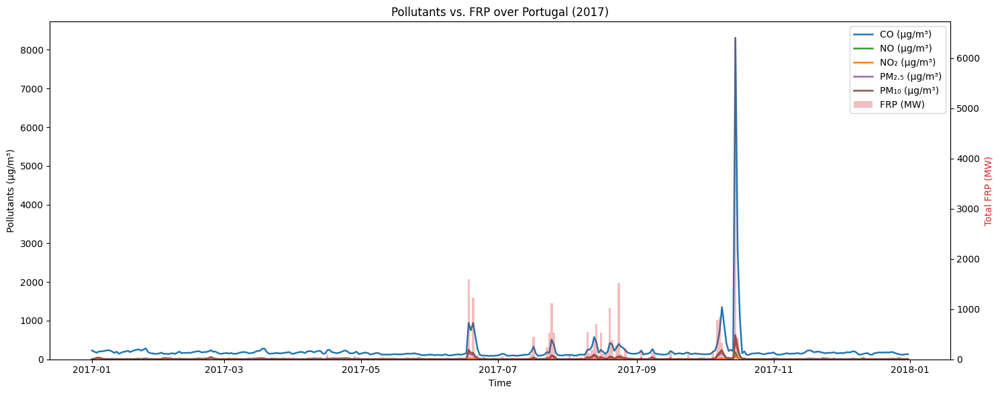

In [3]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# --- Settings ---
selected_year = 2017

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',   # converted from mg/m³
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Colors for pollutants
colors = {
    'CO': 'tab:blue',
    'NO': 'tab:green',
    'NO₂': 'tab:orange',
    'PM₂.₅': 'tab:purple',
    'PM₁₀': 'tab:brown'
}

# --- Create one figure ---
fig, ax = plt.subplots(figsize=(15, 6))
ax2 = ax.twinx()  # secondary axis for FRP

frp_plotted = False  # so we only plot FRP once

# --- Loop over pollutants ---
for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    if len(ds.time) == 0:
        continue

    # Spatial average
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO from mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Plot pollutant line
    unit = pollutant_units[pollutant_name]
    ax.plot(ds.time, pollutant, label=f'{pollutant_name} ({unit})',
            color=colors[pollutant_name], linewidth=1.8)

    # Plot FRP only once (as bars)
    if not frp_plotted and 'frp_sum_Portugal' in ds:
        frp = ds['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])
        ax2.bar(ds.time, frp, width=1.0, color='tab:red', alpha=0.3, label='FRP (MW)')
        frp_plotted = True

# --- Axis formatting ---
ax.set_ylabel("Pollutants (µg/m³)", color='black')
ax2.set_ylabel("Total FRP (MW)", color='tab:red')

# Force both y-axes to start at zero
ax.set_ylim(bottom=0)
ax2.set_ylim(bottom=0)

# Title
title = "Pollutants vs. FRP over Portugal"
if selected_year is not None:
    title += f" ({selected_year})"
ax.set_title(title)

# Legend (combine both axes)
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2, loc='upper right')

ax.set_xlabel("Time")
plt.tight_layout()
plt.show()


### Italy

#### All Years

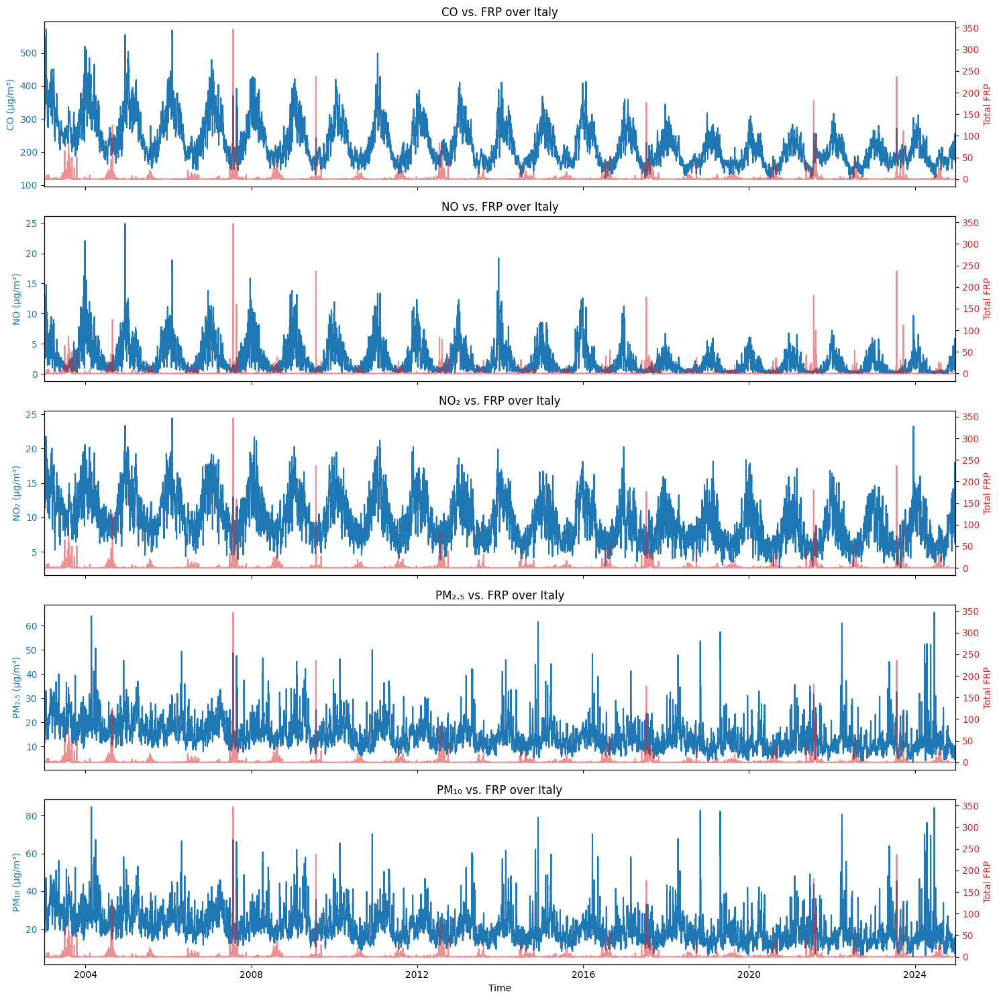

In [4]:
# All Years - Italy

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Italy
    frp = ds['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Italy')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

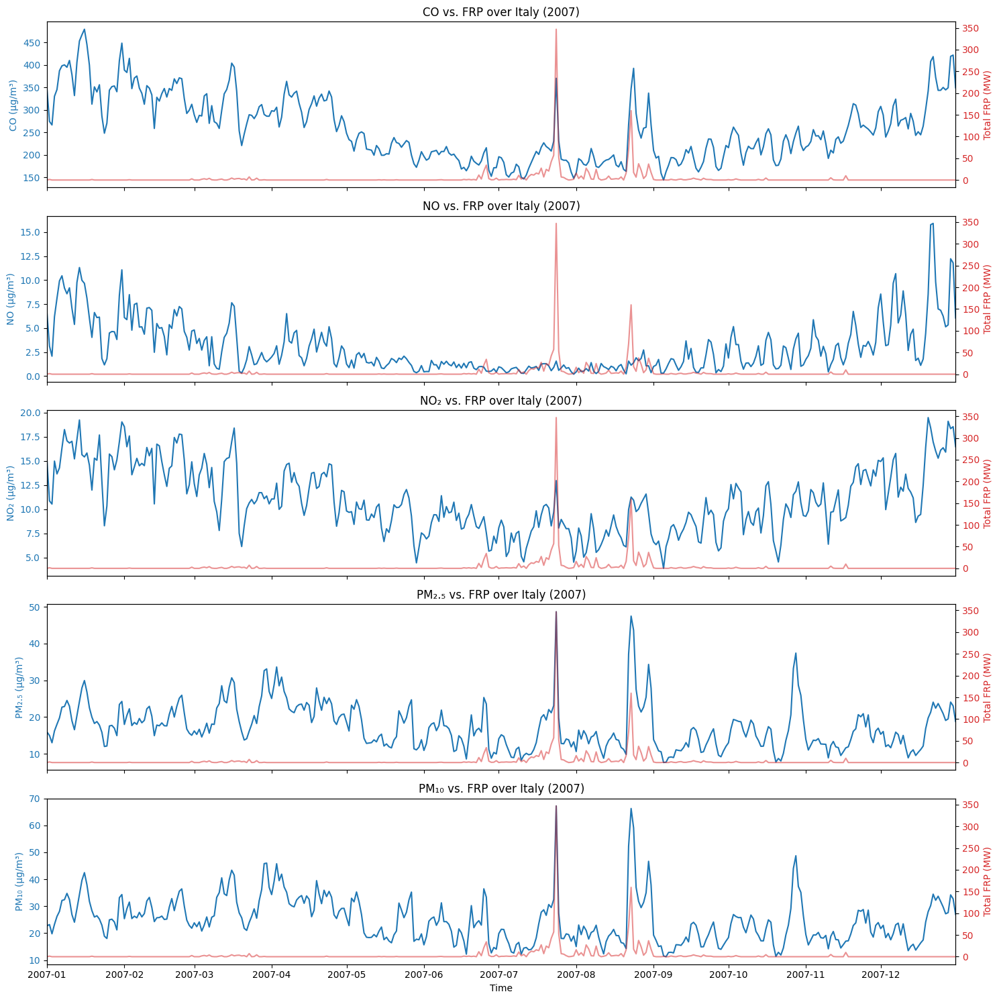

In [5]:
# Certain Year - Italy

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2007

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Italy
    frp = ds['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Italy'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Spain

#### All Years

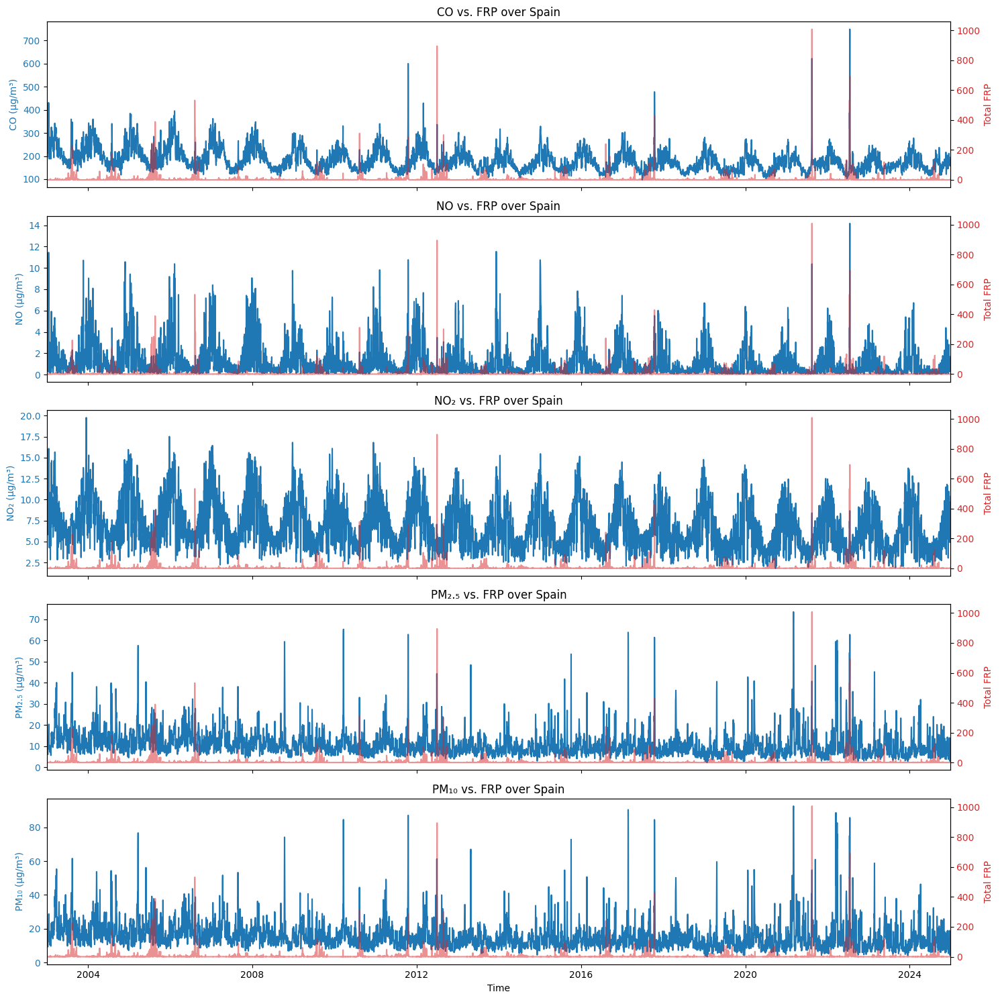

In [6]:
# All Years - Spain

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Spain
    frp = ds['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Spain')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

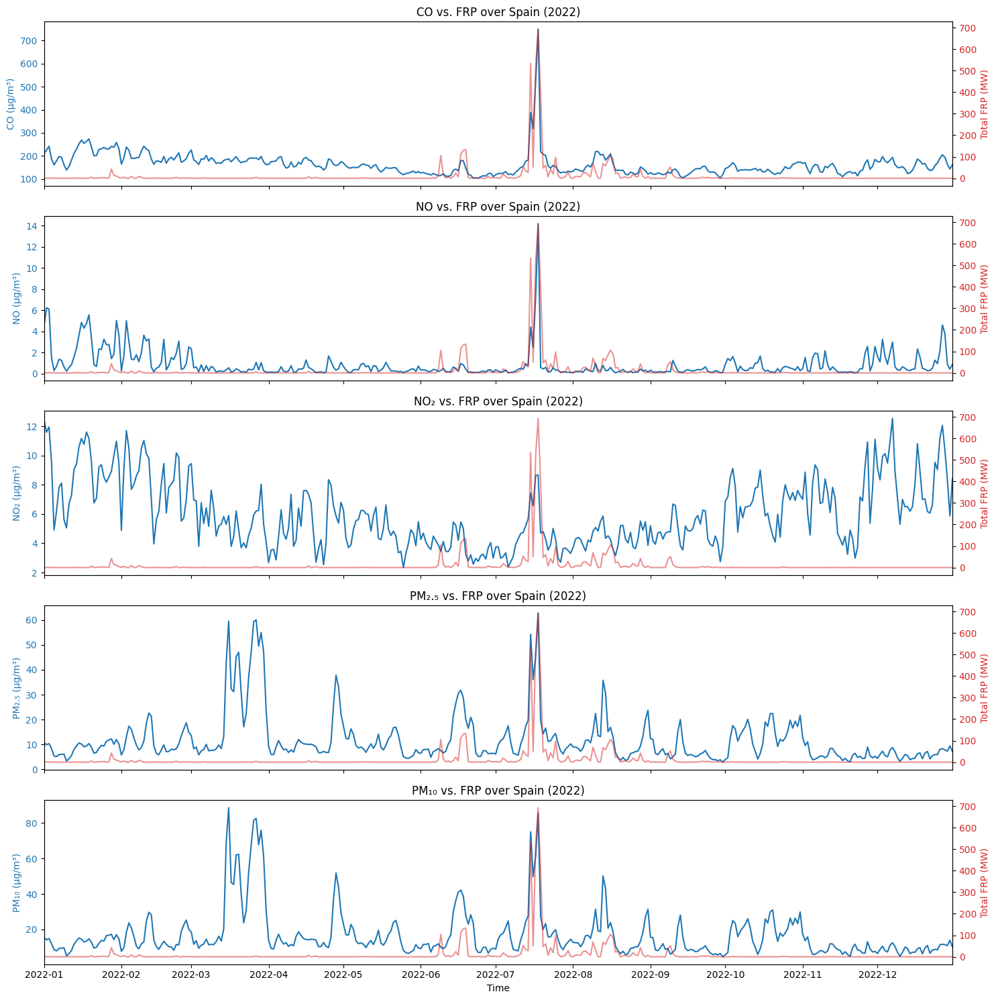

In [7]:
# Certain Year - Spain

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2022

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Spain
    frp = ds['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Spain'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Greece

#### All Years

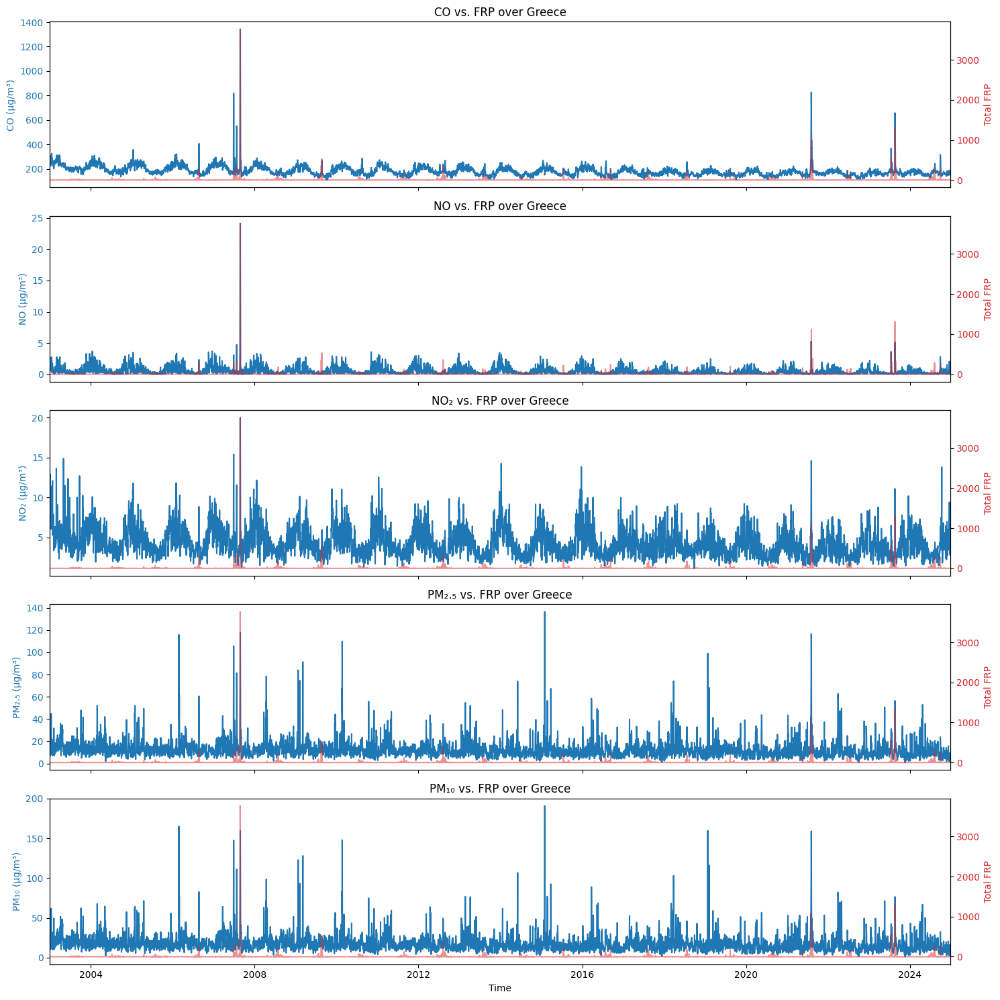

In [8]:
# All Years - Greece

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Greece
    frp = ds['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Greece')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

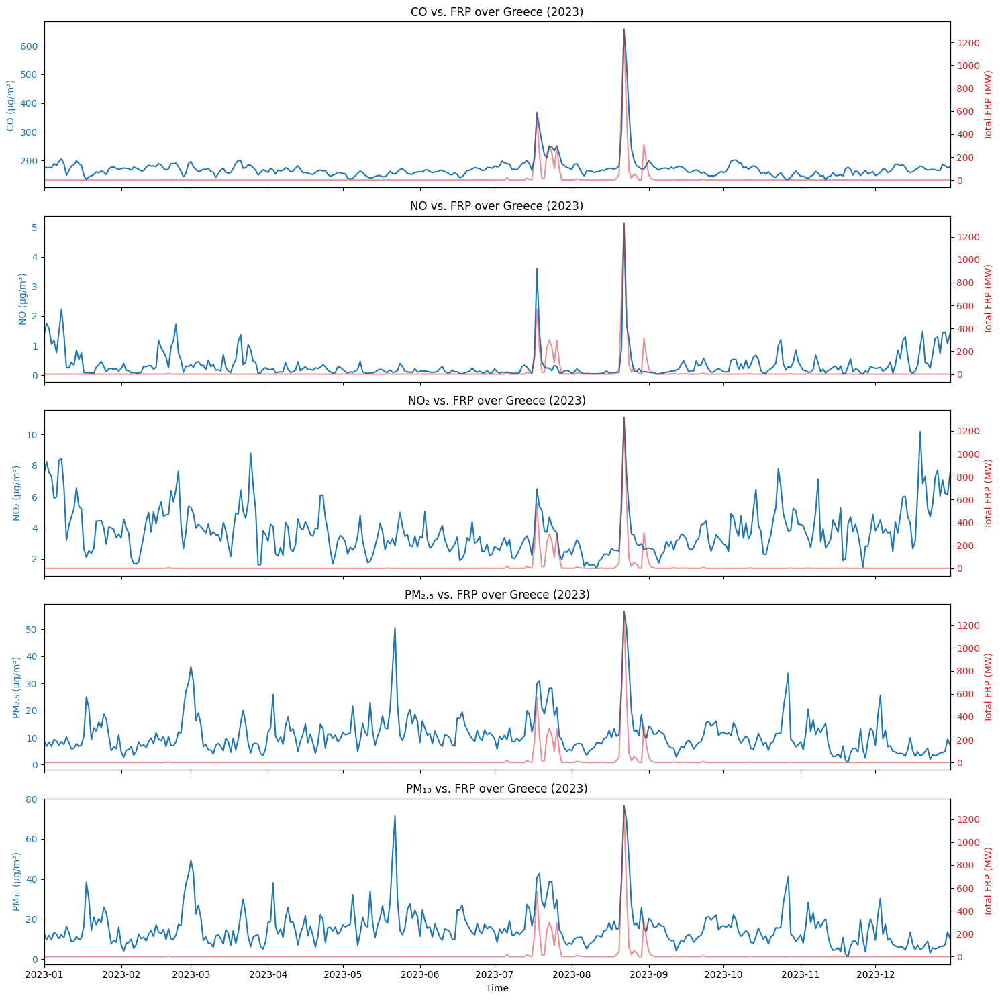

In [9]:
# Certain Year - Greece

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2023

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Greece
    frp = ds['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Greece'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Iberia

#### All Years

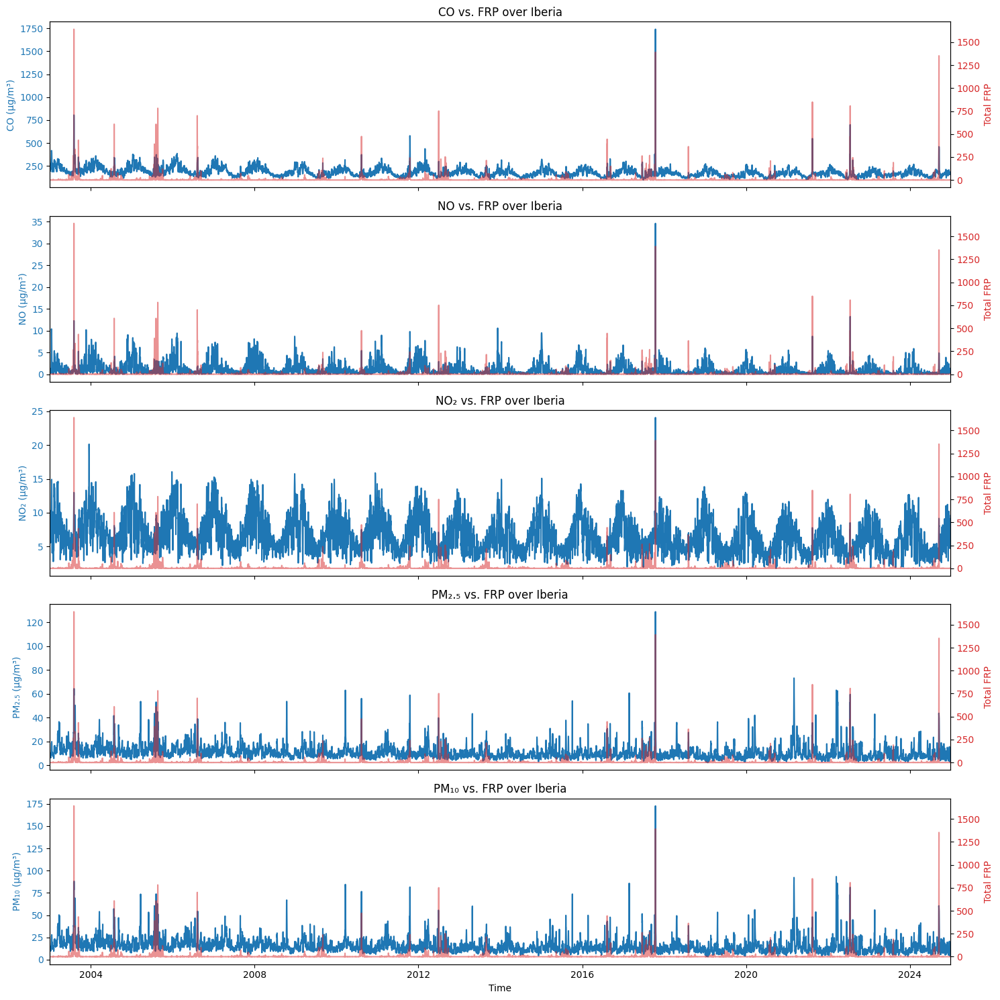

In [10]:
# All Years - Iberia

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Correct units for plotting (CO now in µg/m³)
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Iberia
    frp = ds['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Iberia')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

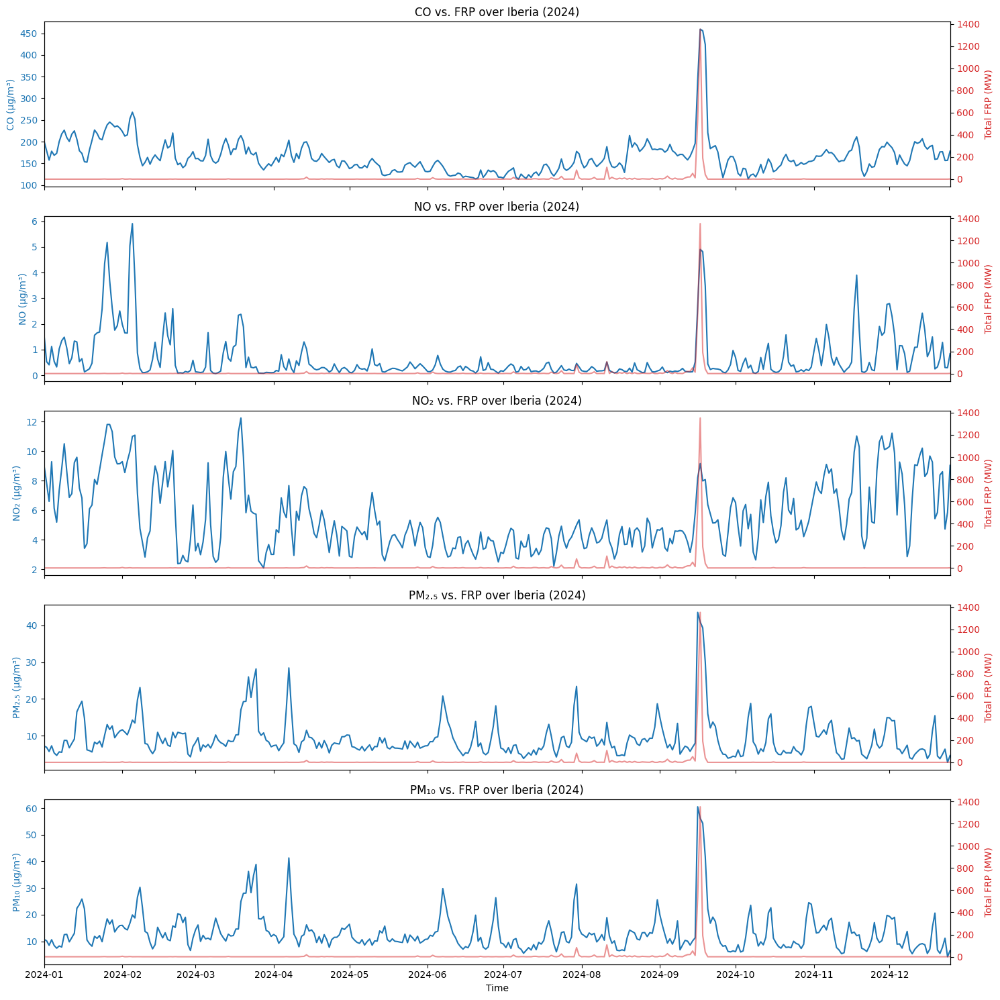

In [11]:
# Certain Year - Iberia

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2024

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Units for each pollutant (CO now in µg/m³)
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Iberia
    frp = ds['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Iberia'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


## Crossover of FRP (fire foci - count) and Pollutants levels in a time series template over the years or single year

### Portugal

#### All Years

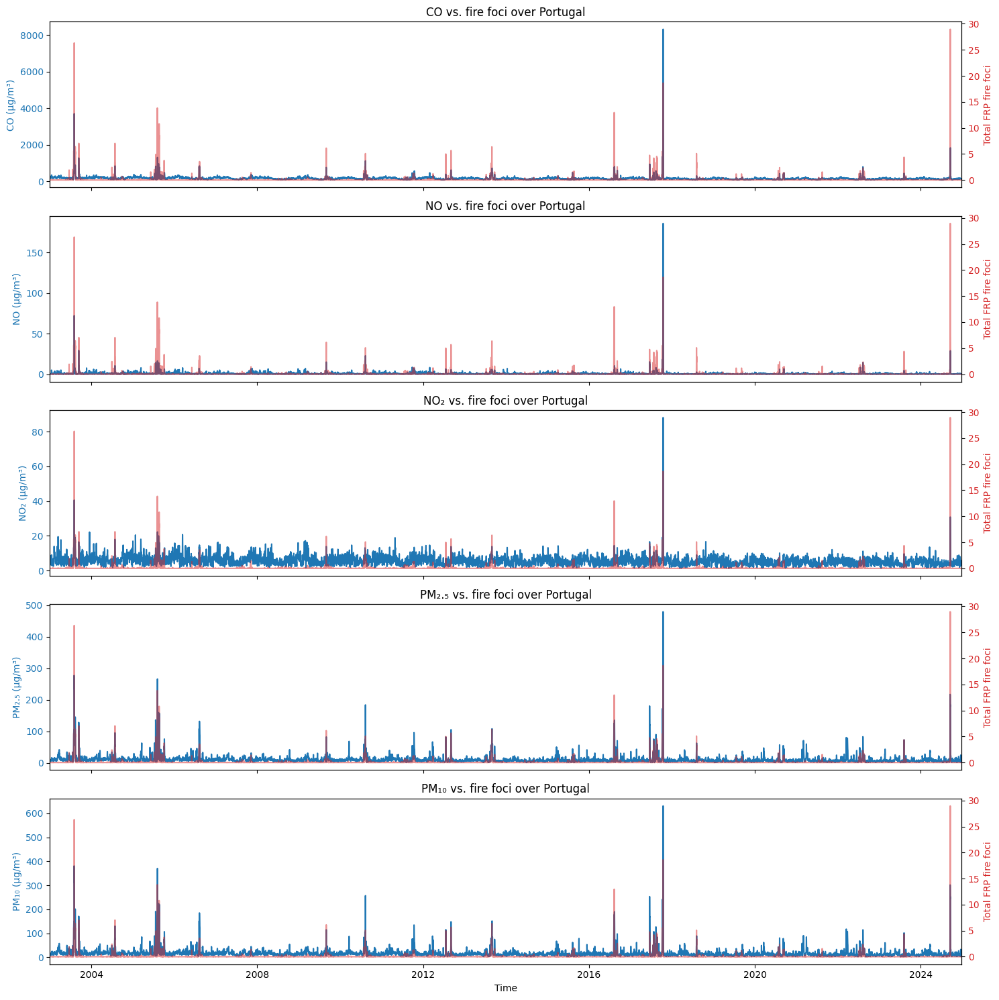

In [12]:
# All Years - Portugal

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Portugal
    frp = ds['frp_count_Portugal'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Portugal')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

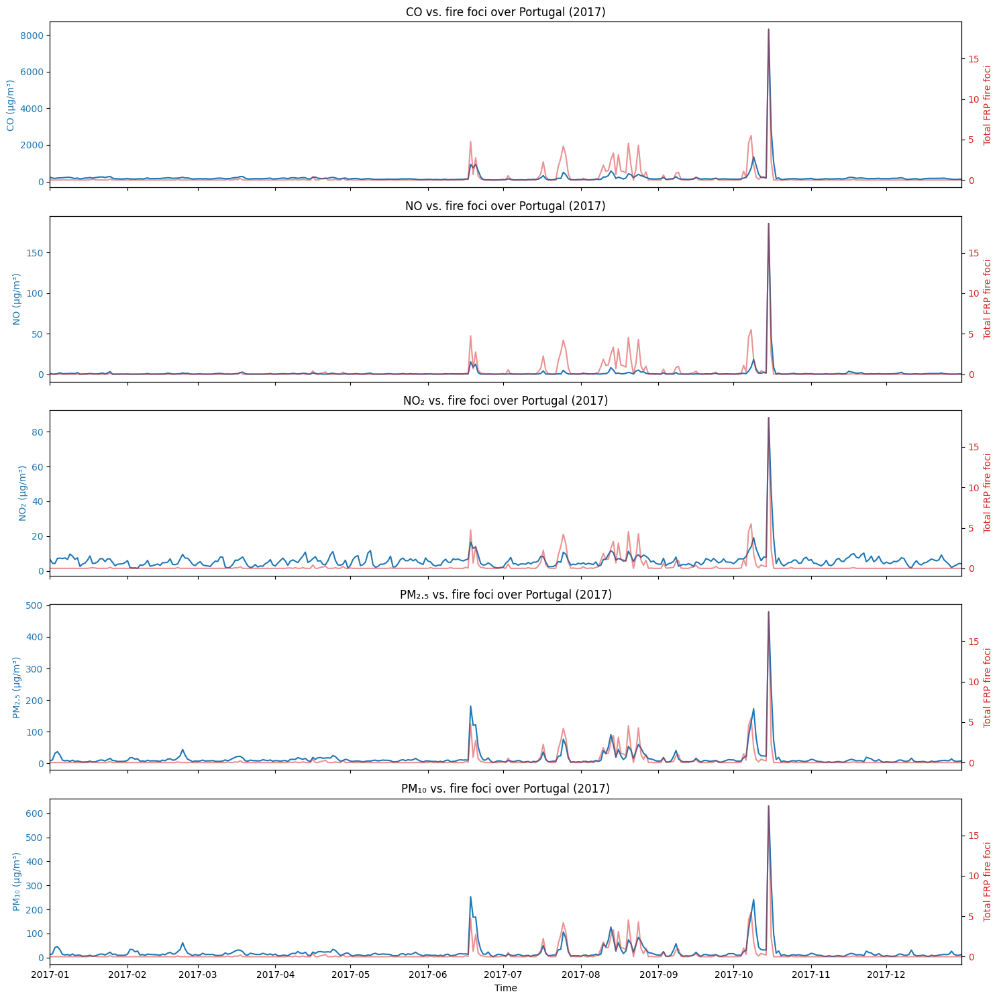

In [13]:
# Certain Year - Portugal

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2017

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Portugal
    frp = ds['frp_count_Portugal'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Portugal'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Italy

#### All Years

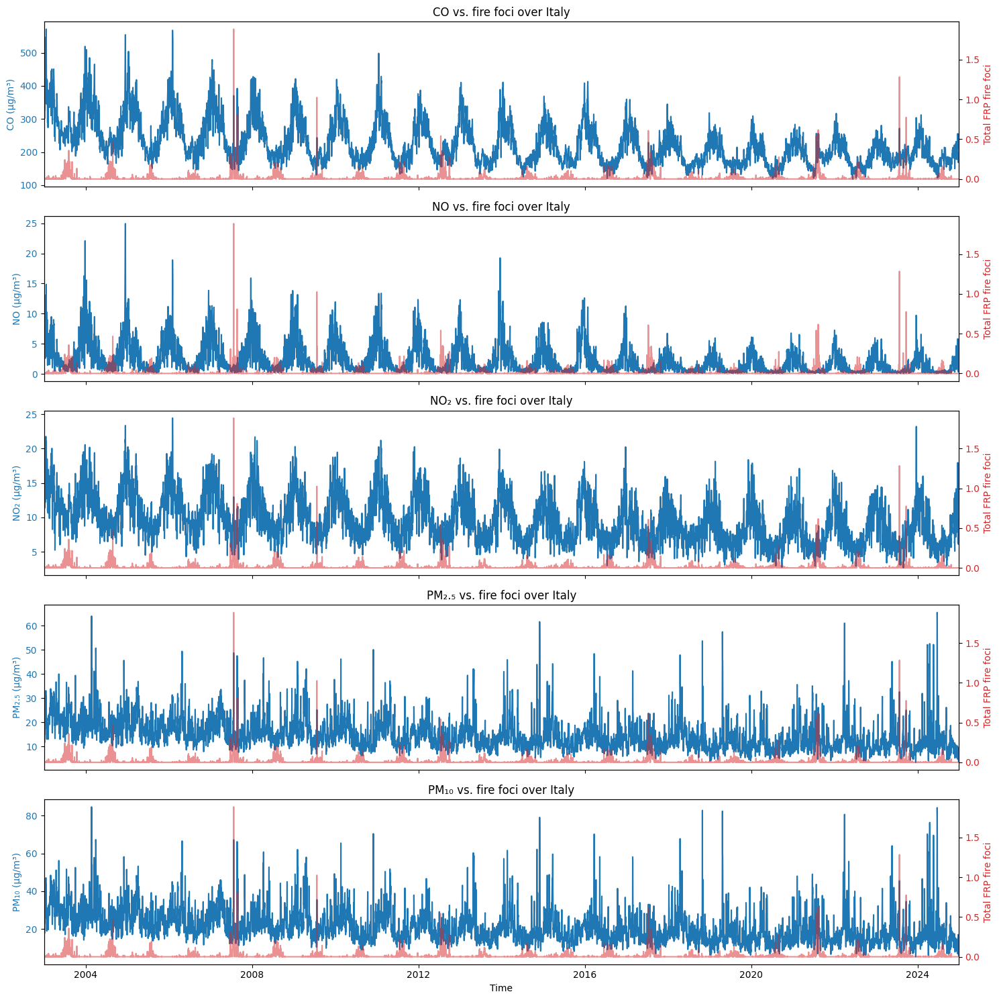

In [14]:
# All Years - Italy

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Italy
    frp = ds['frp_count_Italy'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Italy')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

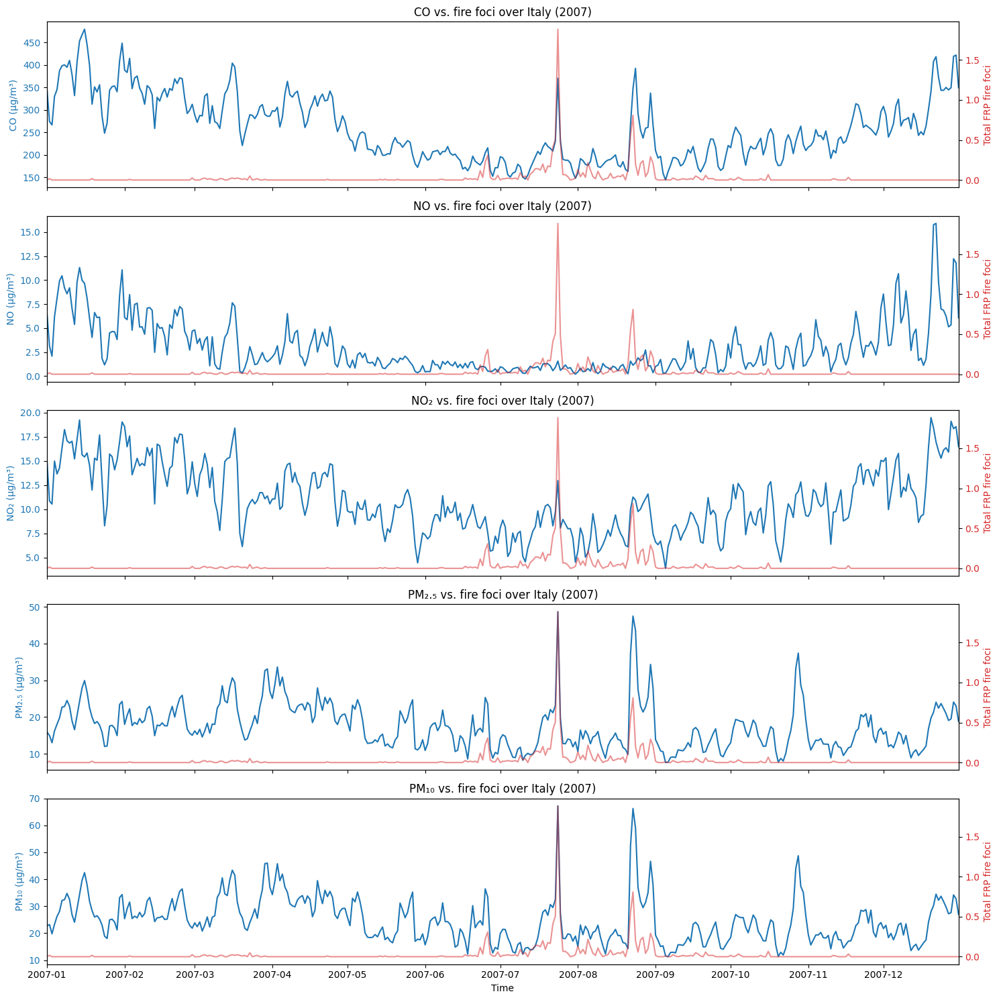

In [15]:
# Certain Year - Italy

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2007

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000    

    # Daily total count FRP over Italy
    frp = ds['frp_count_Italy'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Italy'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Spain

#### All Years

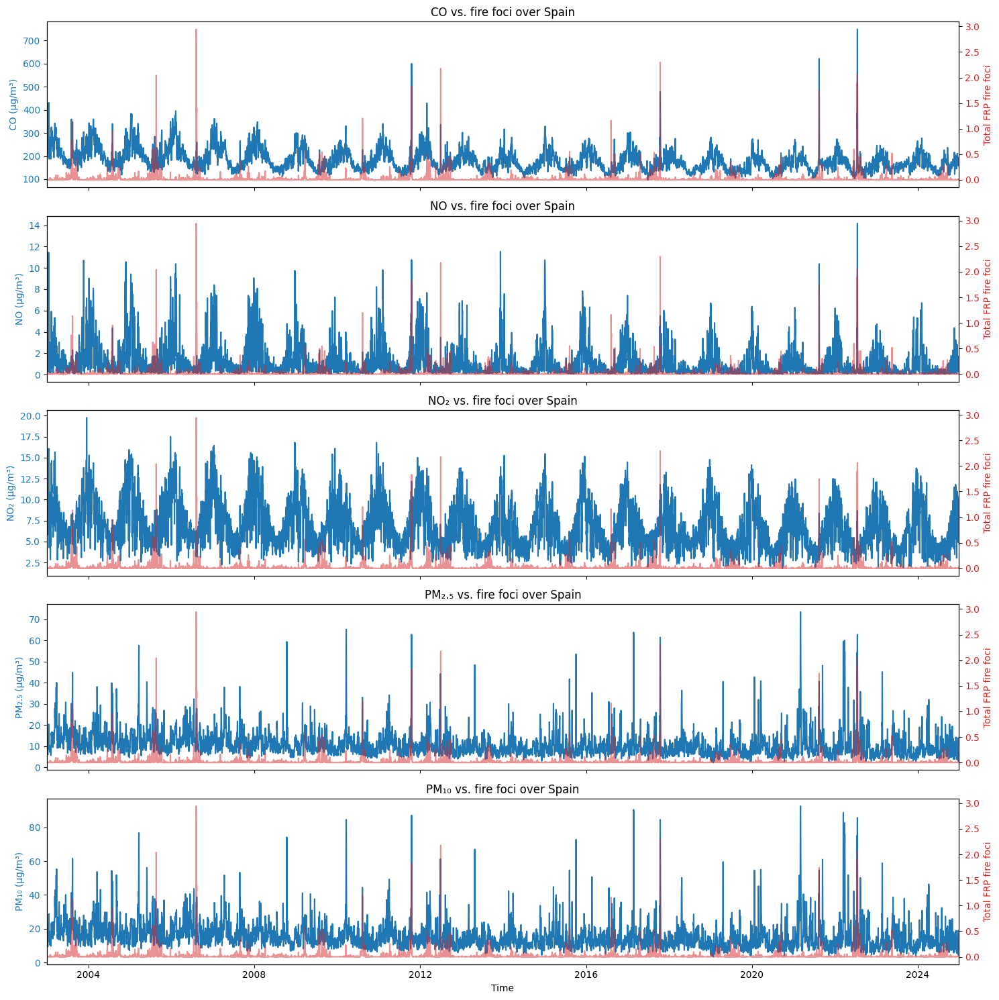

In [16]:
# All Years - Spain

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Spain
    frp = ds['frp_count_Spain'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Spain')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

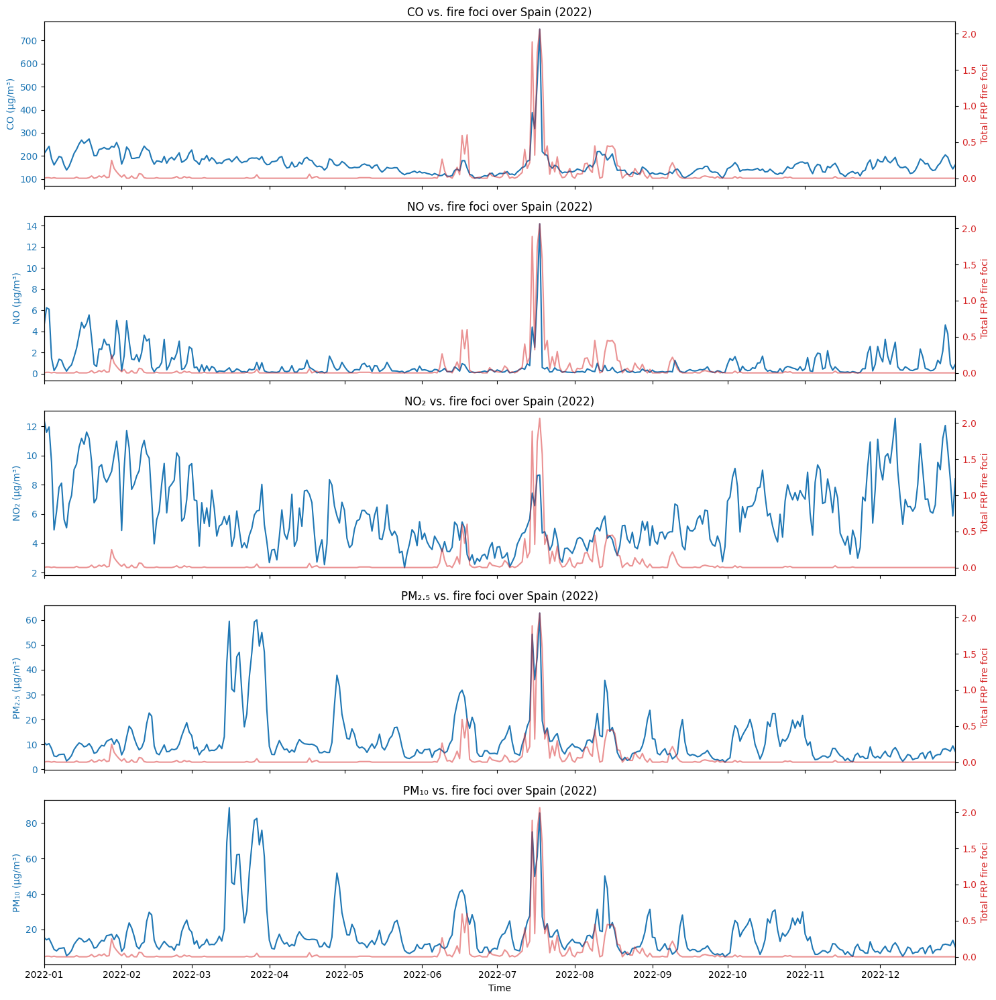

In [17]:
# Certain Year - Spain

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2022

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Spain
    frp = ds['frp_count_Spain'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Spain'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Greece

#### All Years

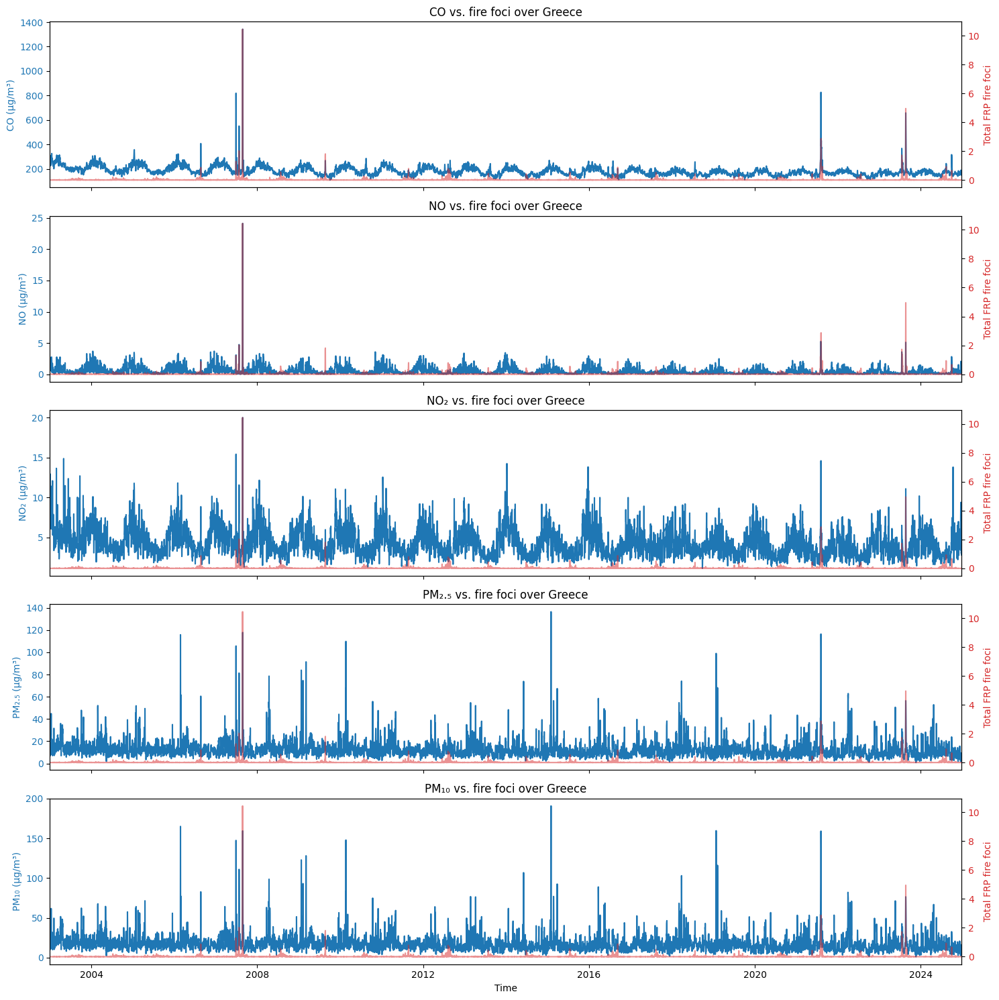

In [18]:
# All Years - Greece

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Greece
    frp = ds['frp_count_Greece'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Greece')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

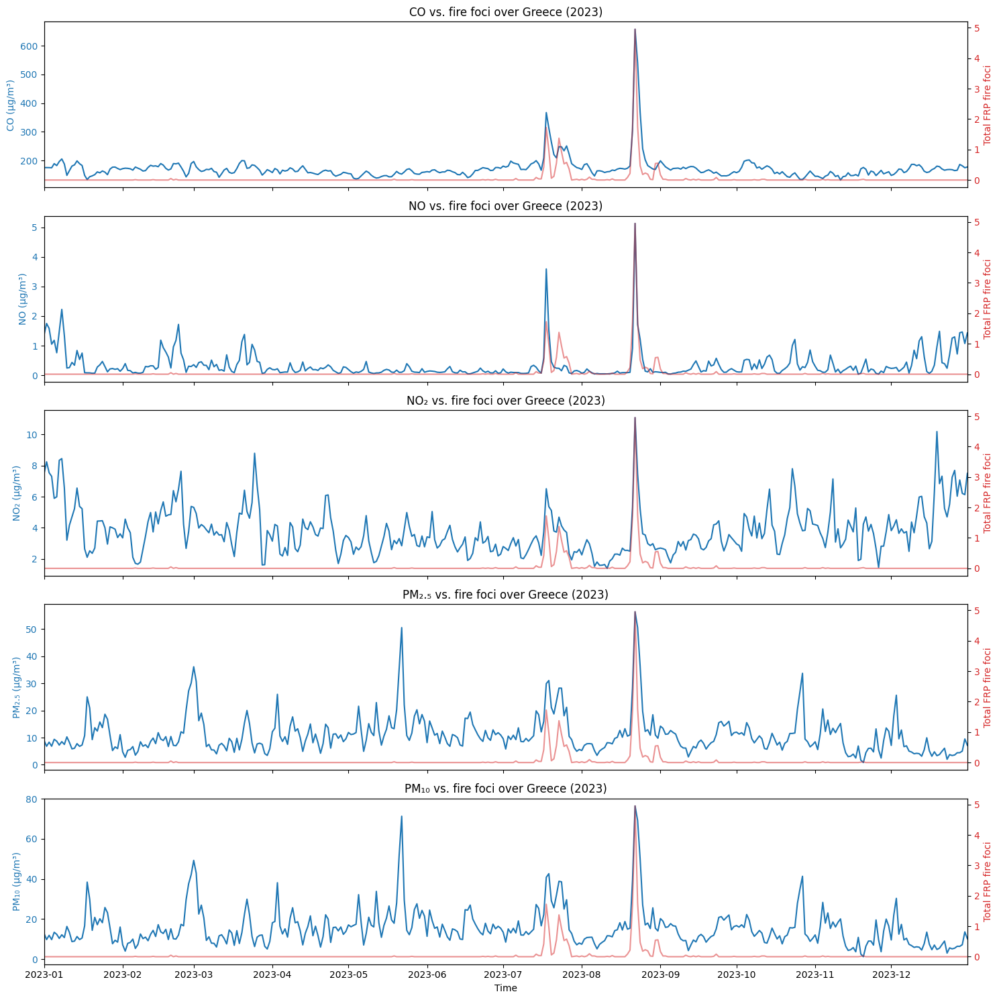

In [19]:
# Certain Year - Greece

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2023

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over greece
    frp = ds['frp_count_Greece'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Greece'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Iberia

#### All Years

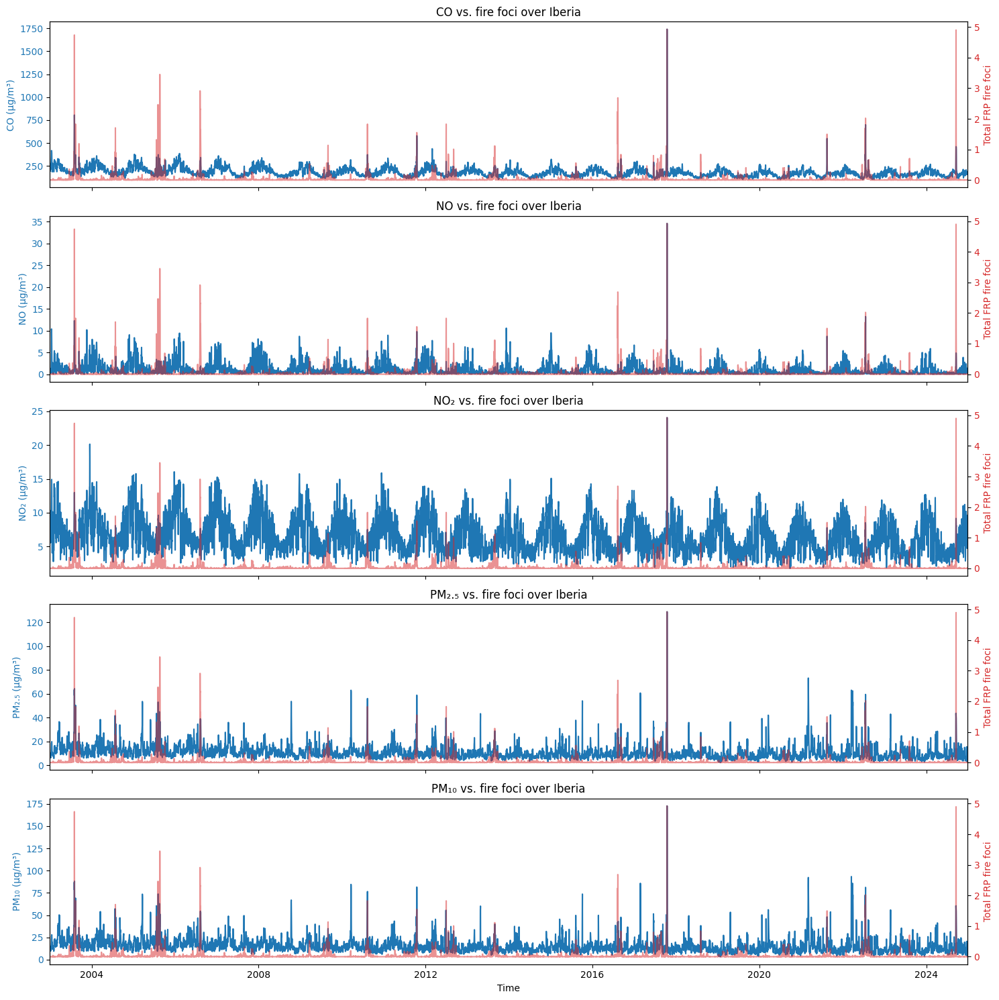

In [20]:
# All Years - Iberia

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Iberia
    frp = ds['frp_count_Iberia'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Iberia')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

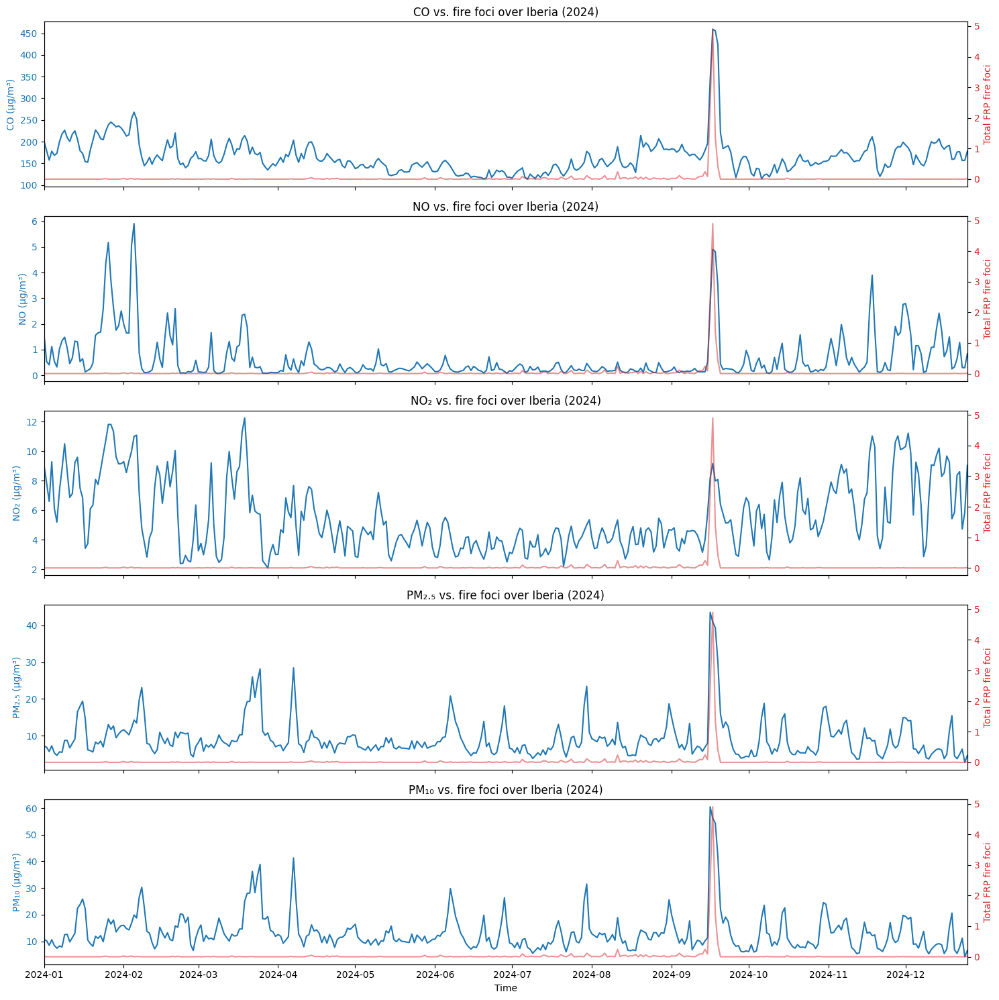

In [21]:
# Certain Year - Iberia

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2024

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Iberia
    frp = ds['frp_count_Iberia'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Iberia'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


## Air pollutants levels on days with different labels

### Portugal

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)


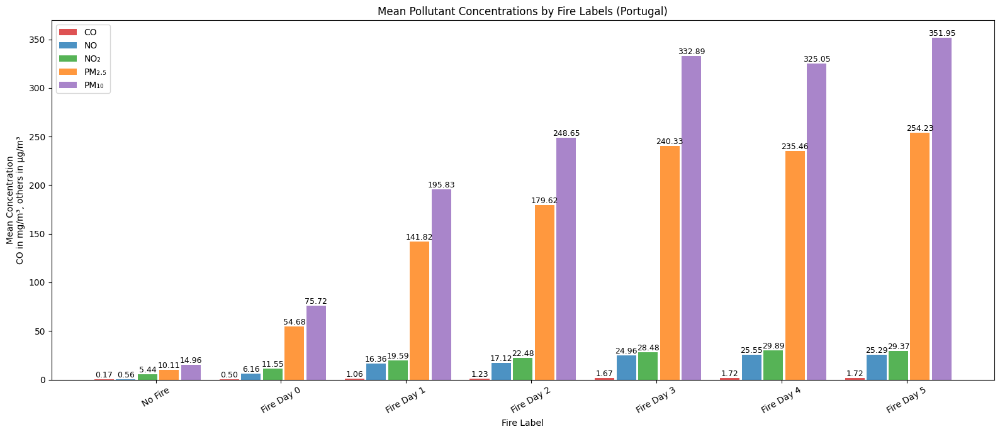

In [22]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"  
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Portugal'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Portugal)")

# Move legend to left
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)


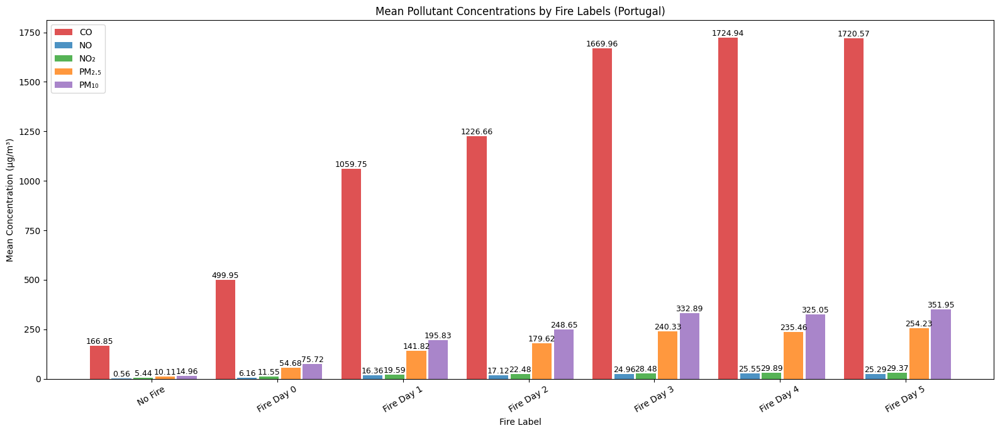

In [23]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Portugal'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Portugal)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Italy

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)


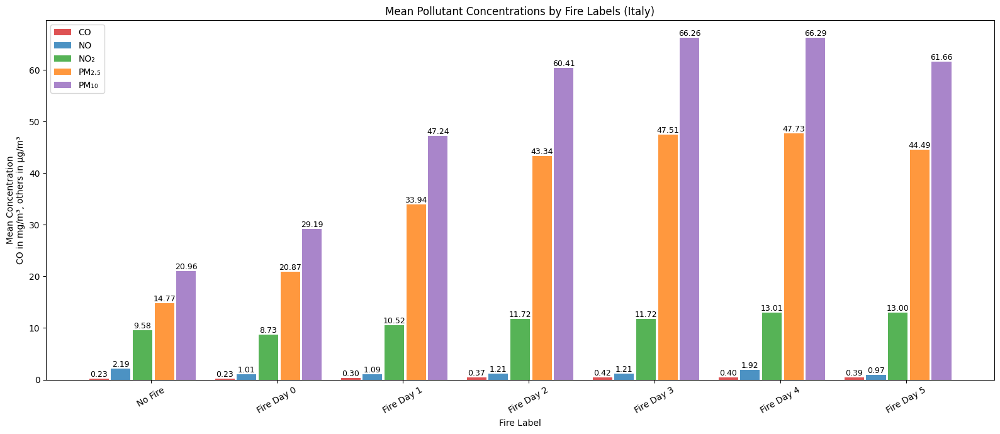

In [24]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Italy'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Italy)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)


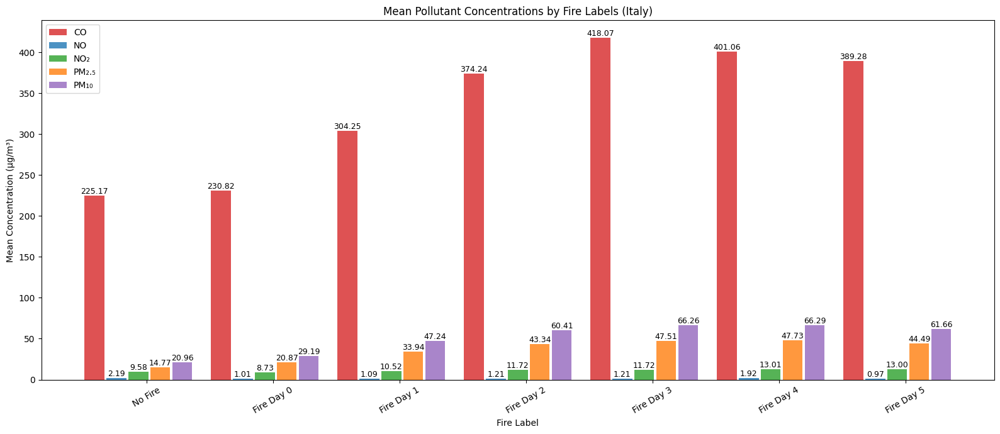

In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc" 
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Italy'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Italy)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Spain

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)


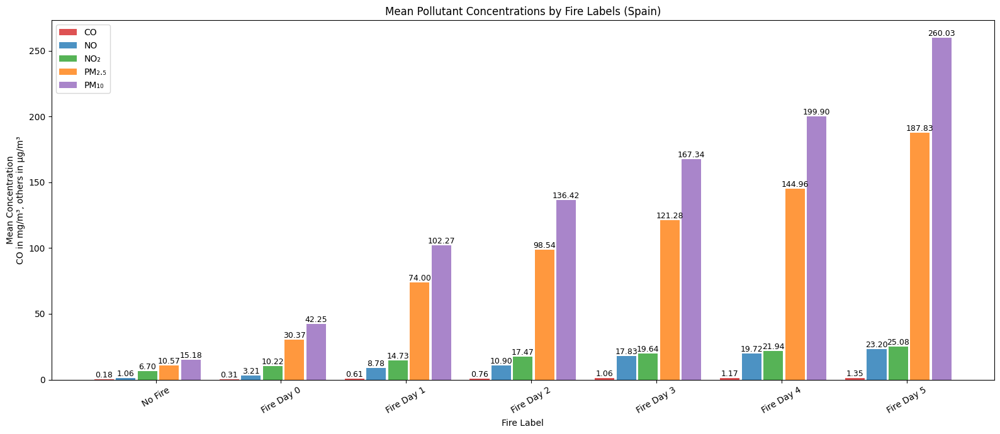

In [26]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Spain'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Spain)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)


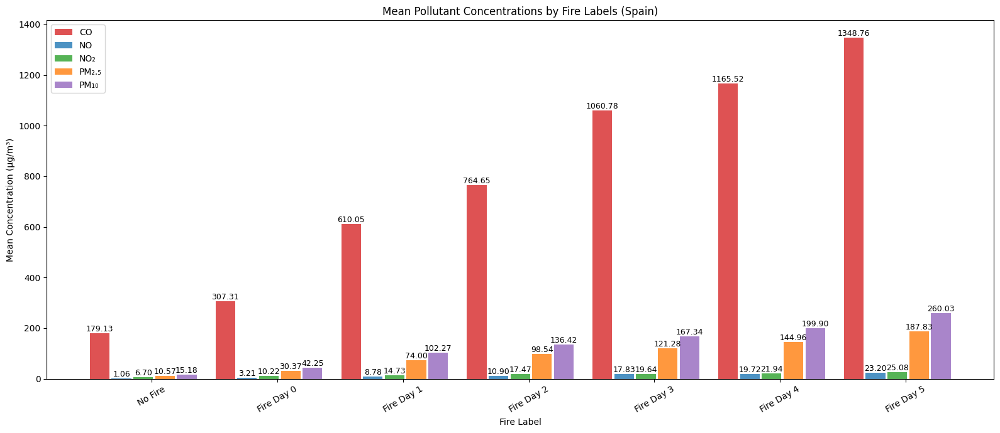

In [27]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"    
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Spain'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Spain)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Greece

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)


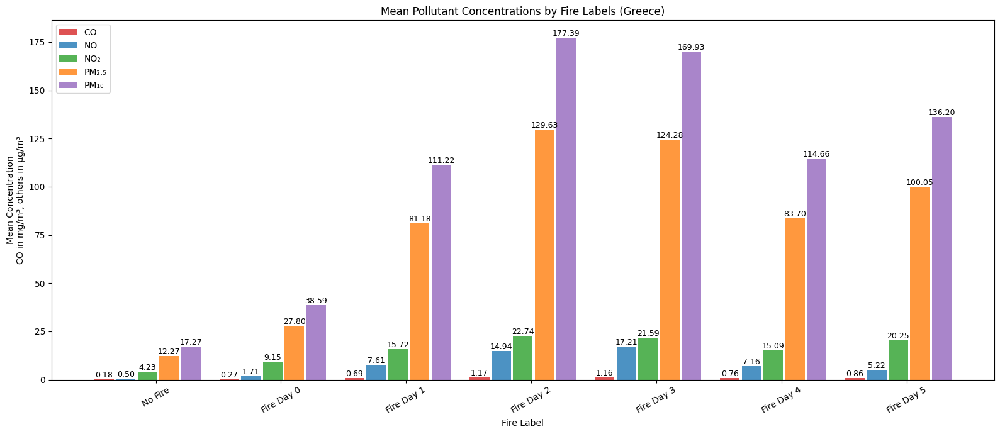

In [28]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"    
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Greece'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Greece)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\491345396.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\491345396.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\491345396.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\491345396.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\491345396.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)


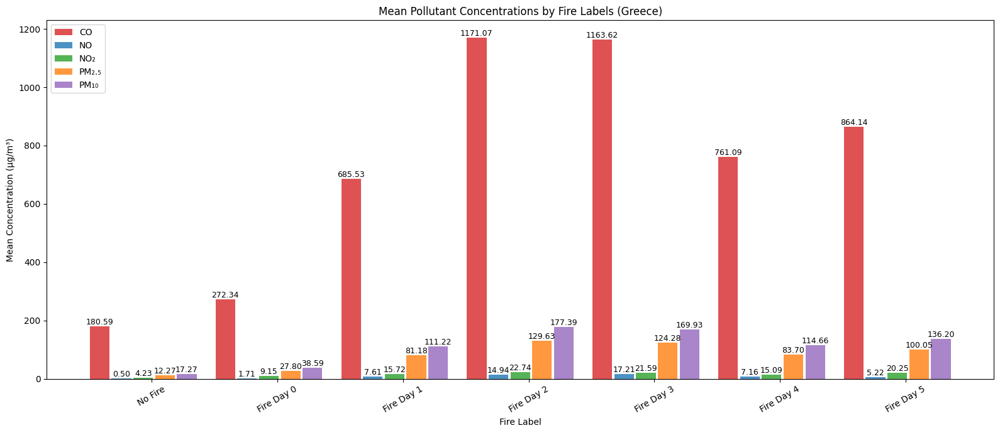

In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"  
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Greece'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Greece)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Iberia

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)


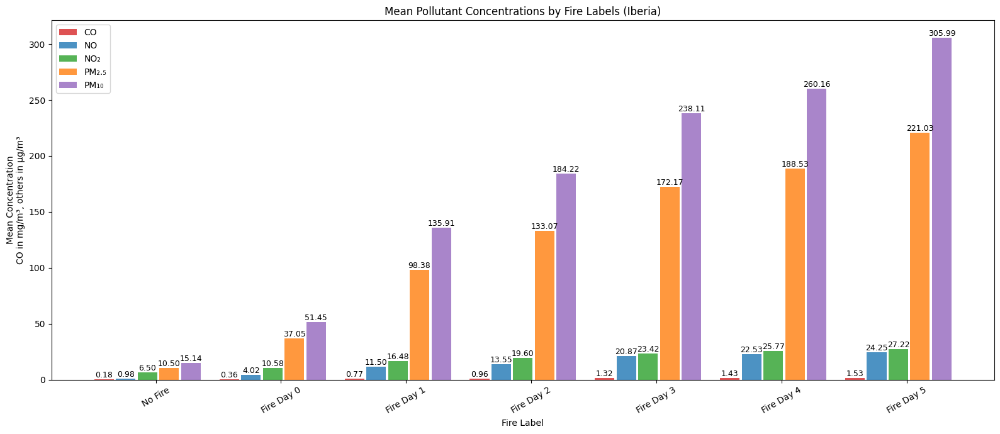

In [30]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"     
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Iberia'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Iberia)")

# Move legend to left
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()

C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_32476\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)


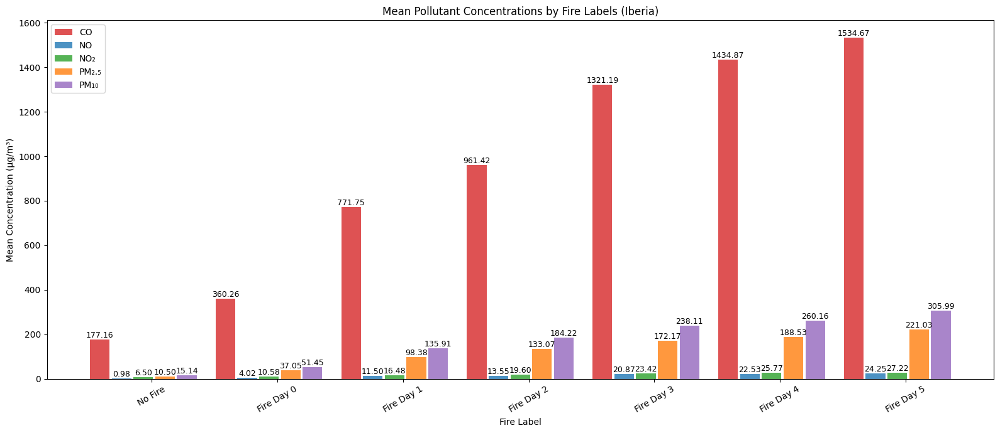

In [3]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Iberia'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Iberia)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


## Crossover of Meteo and FRP or Pollutants - Timeseries

### Portugal

#### All Years


Plotting: Total Precipitation (mm) (mean)


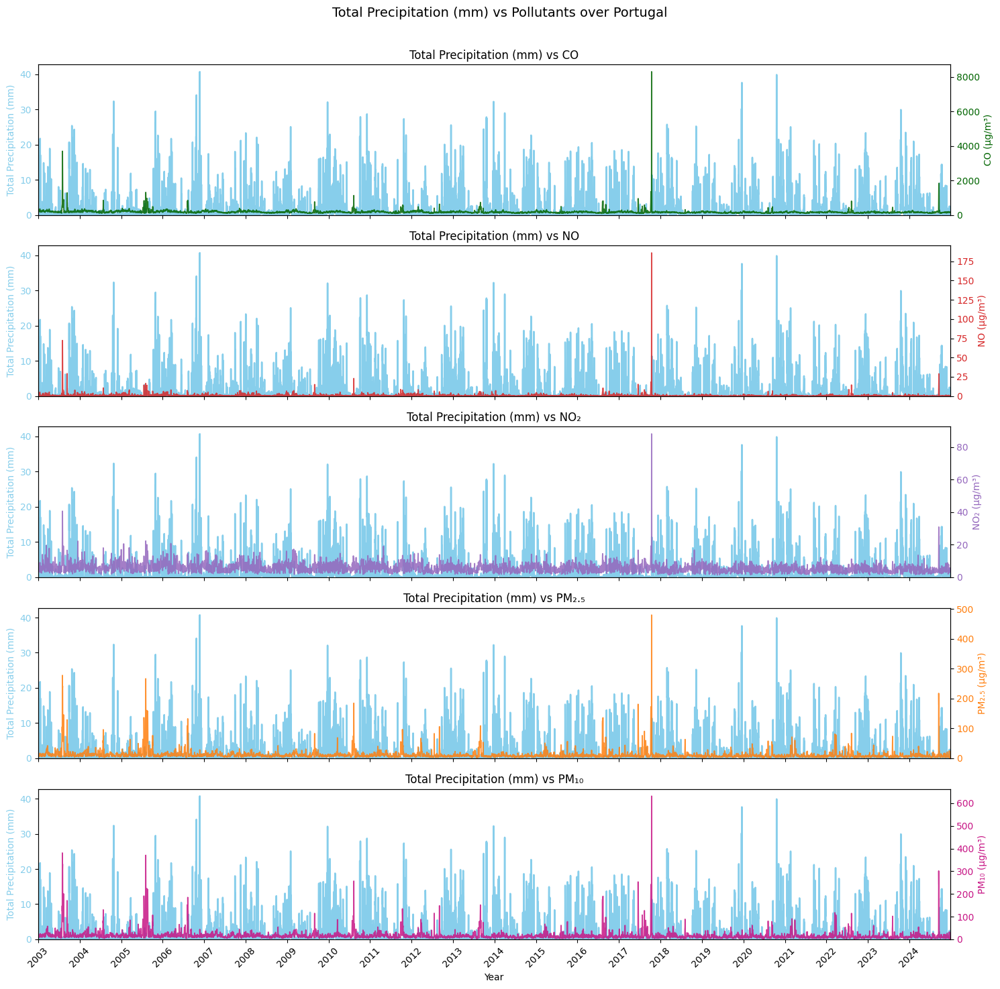


Plotting: Max Temperature (°C) (mean)


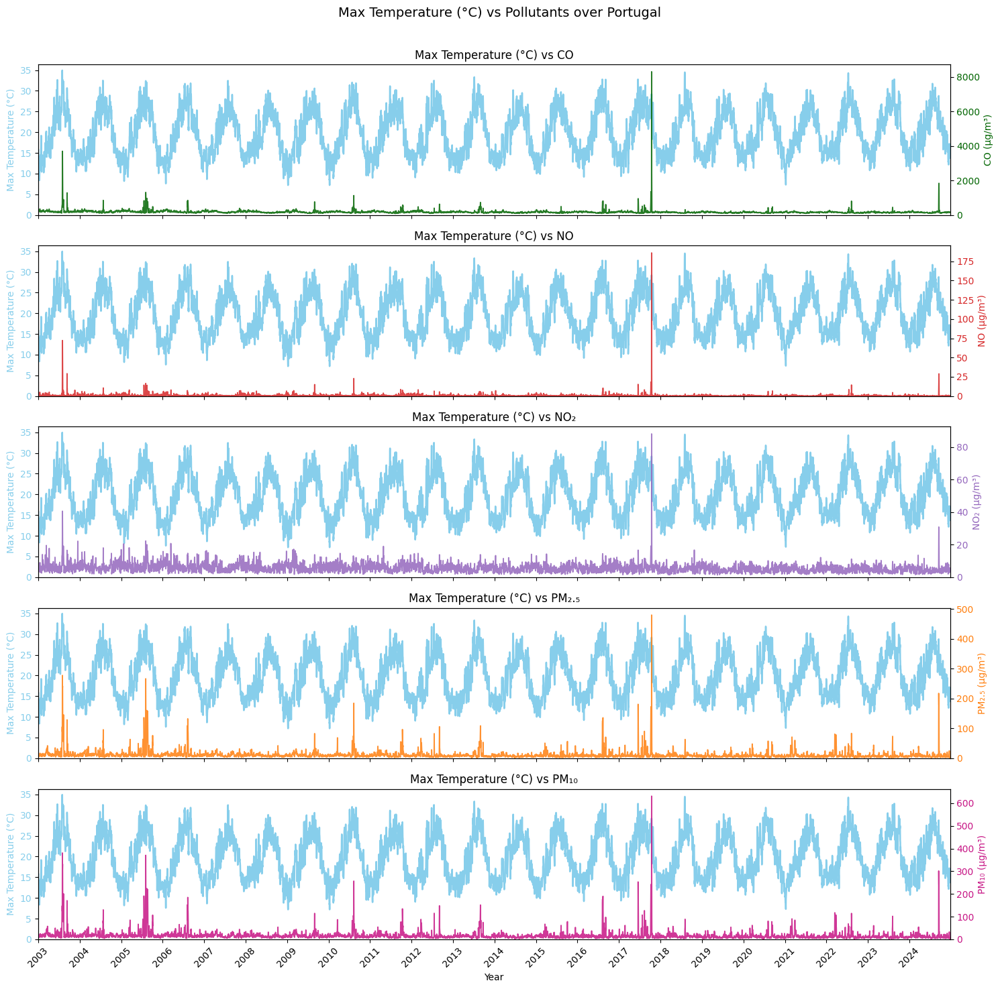


Plotting: Max Wind Speed (m/s) (mean)


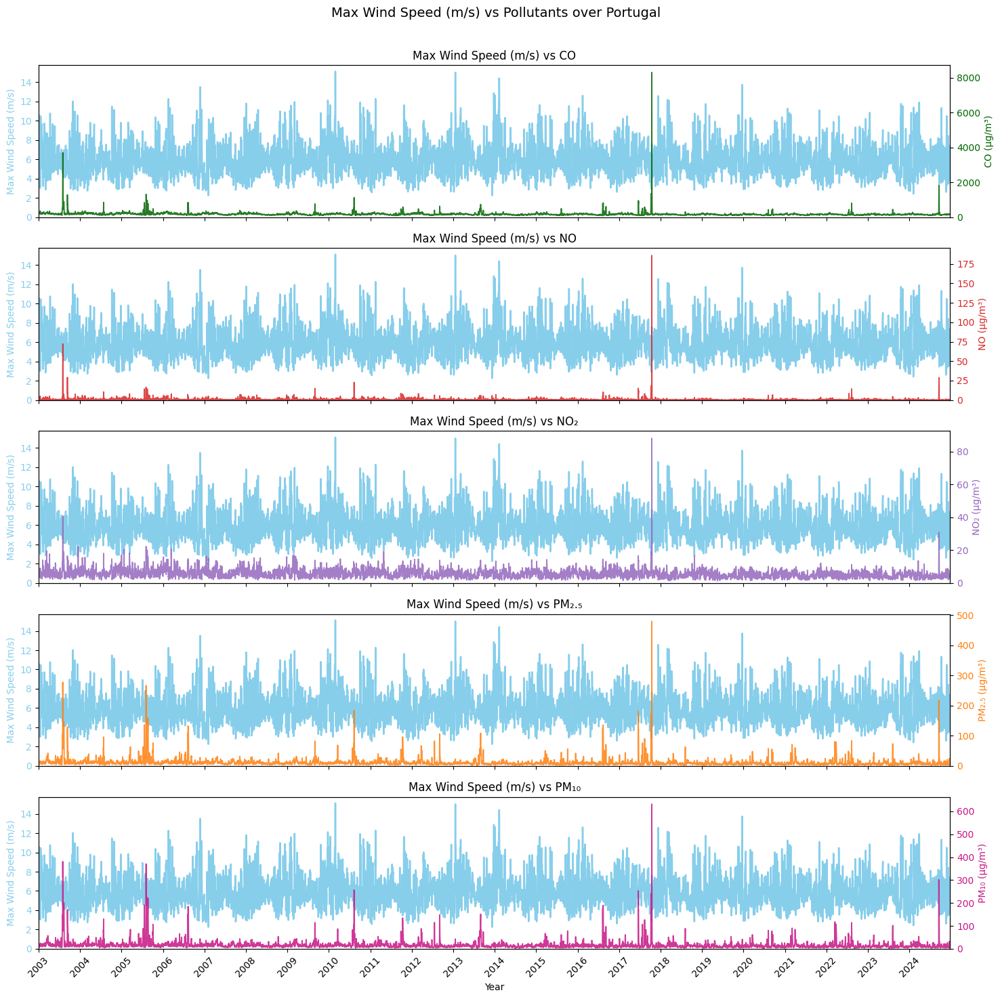

In [40]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Portugal')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (m) (mean)


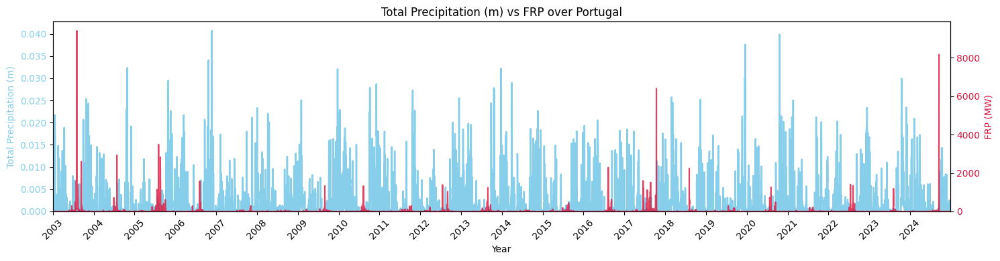


Plotting: Max Temperature (°C) (mean)


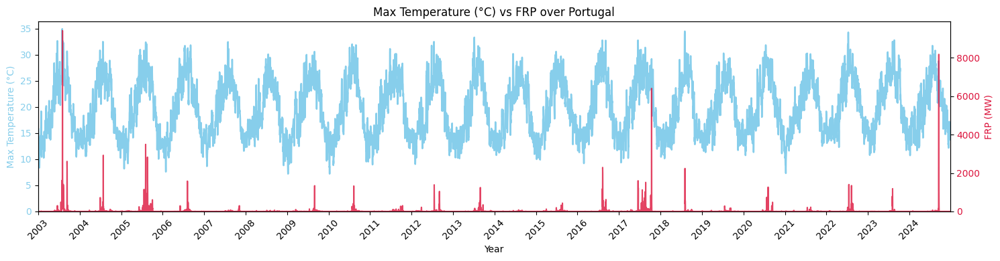


Plotting: Max Wind Speed (m/s) (mean)


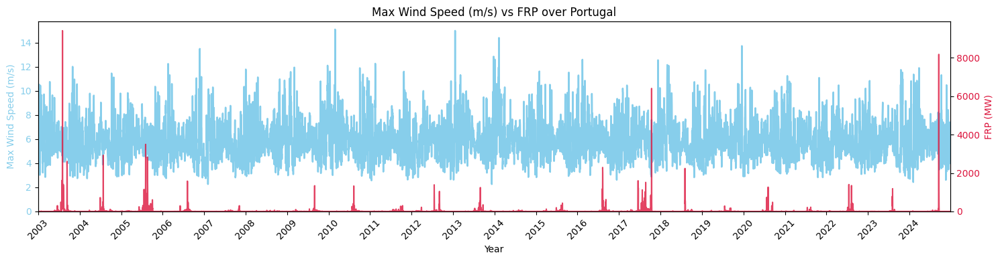

In [ ]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Portugal')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (mm) (mean) for 2017


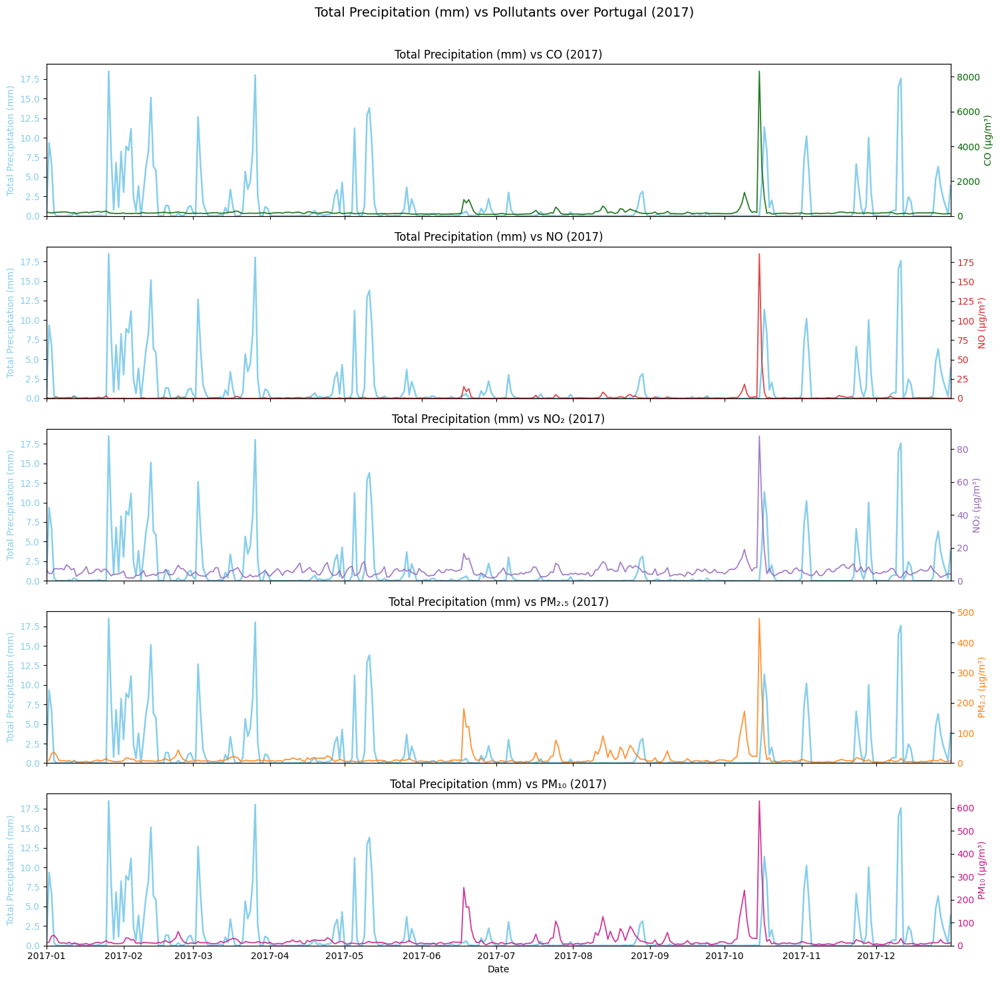


Plotting Max Temperature (°C) (mean) for 2017


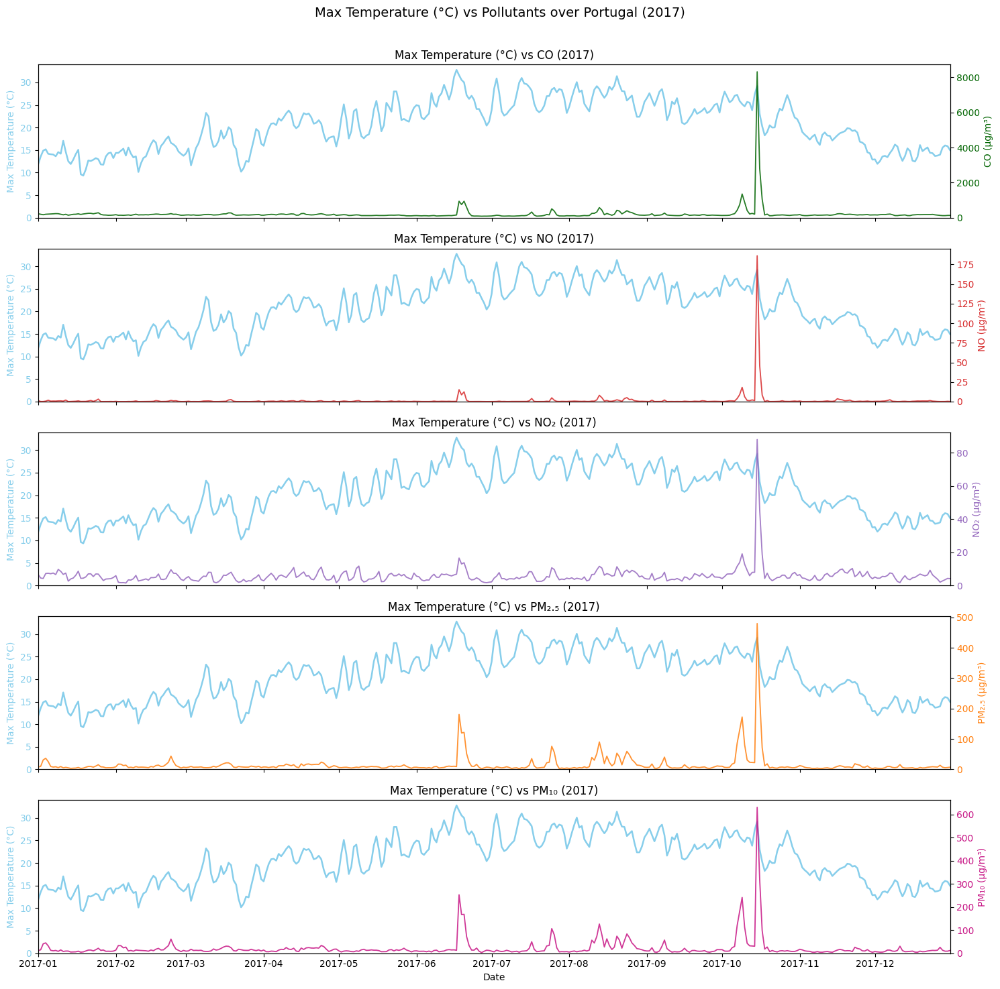


Plotting Max Wind Speed (m/s) (mean) for 2017


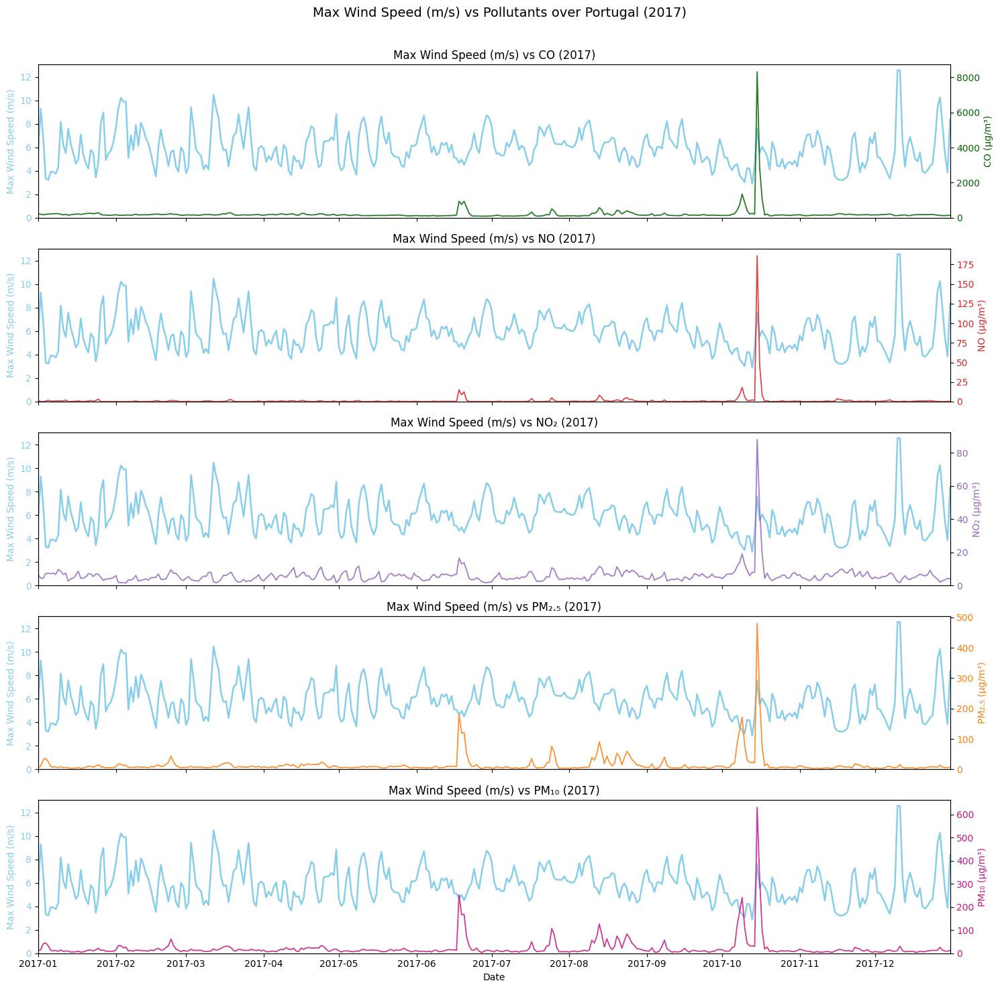

In [39]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Portugal ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (mm) (mean) for 2017


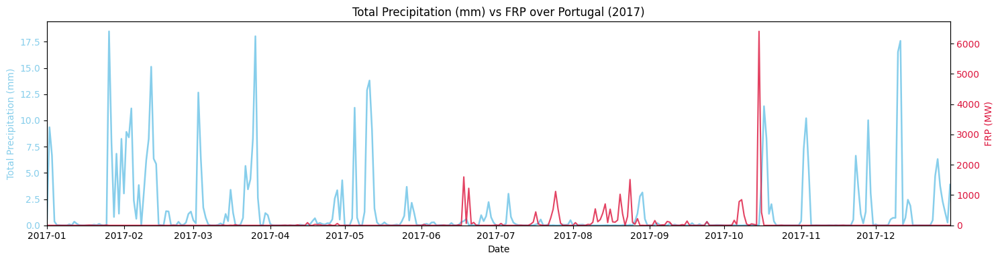


Plotting Max Temperature (°C) (mean) for 2017


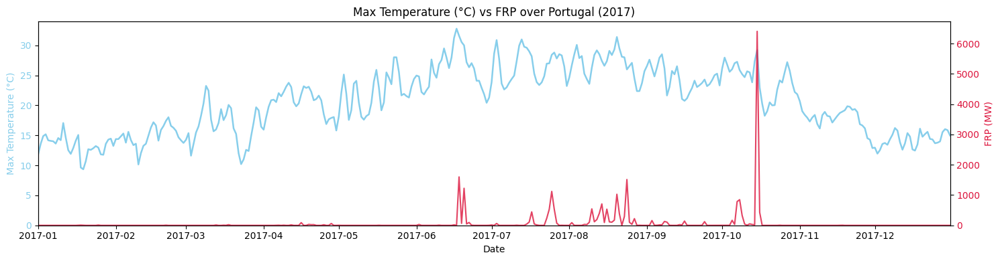


Plotting Max Wind Speed (m/s) (mean) for 2017


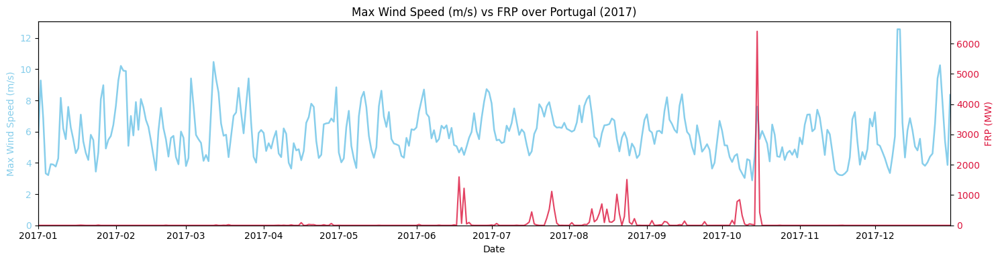

In [38]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Portugal ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Spain

#### All Years


Plotting: Total Precipitation (mm) (mean)


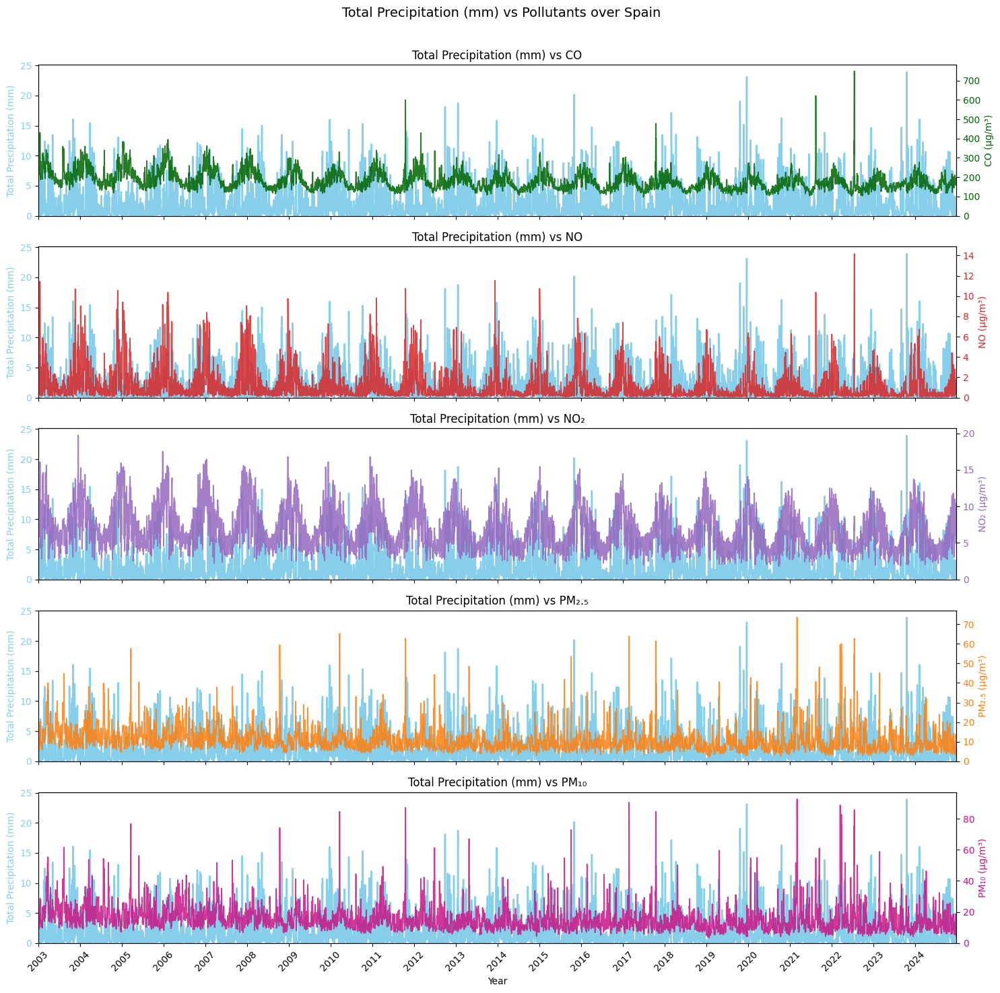


Plotting: Max Temperature (°C) (mean)


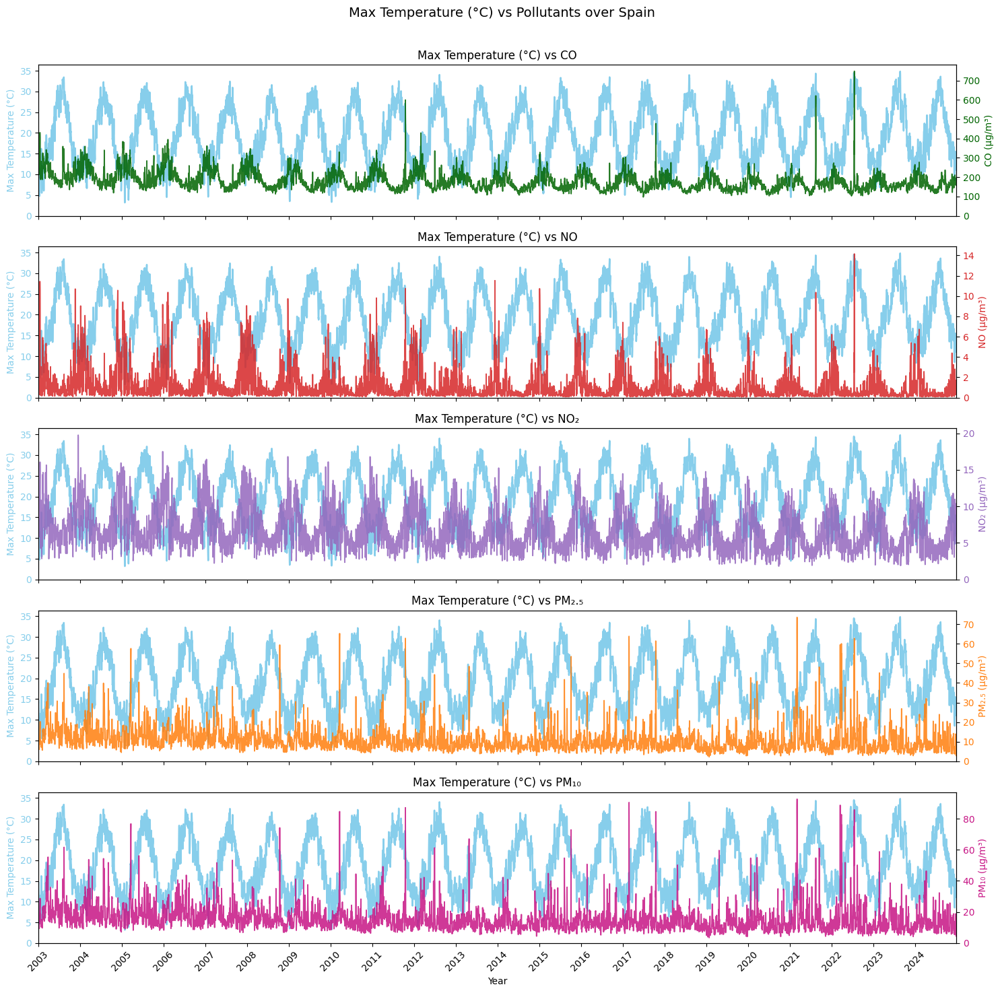


Plotting: Max Wind Speed (m/s) (mean)


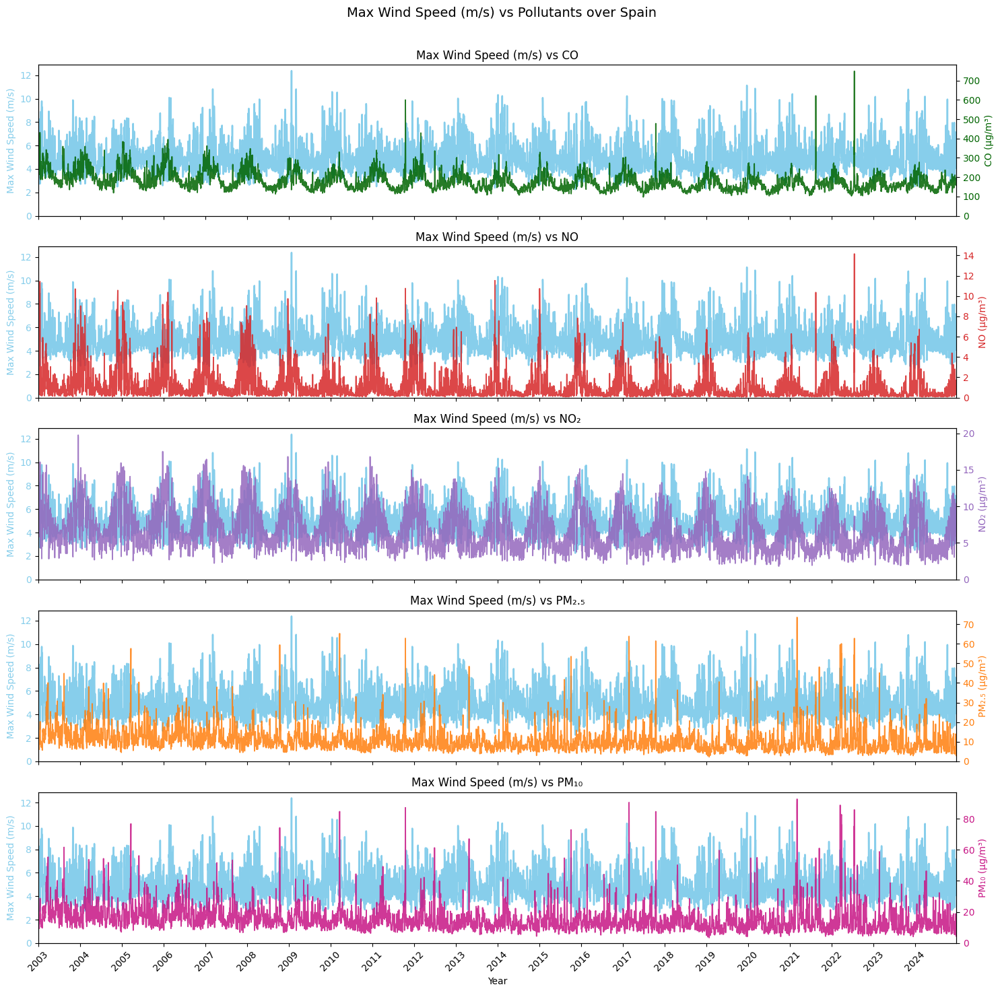

In [37]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Spain')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (mm) (mean)


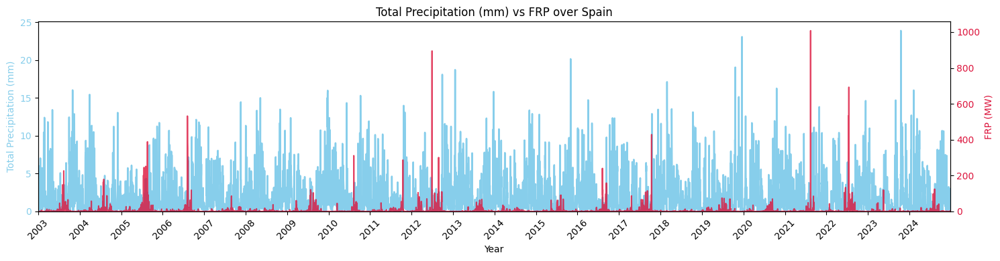


Plotting: Max Temperature (°C) (mean)


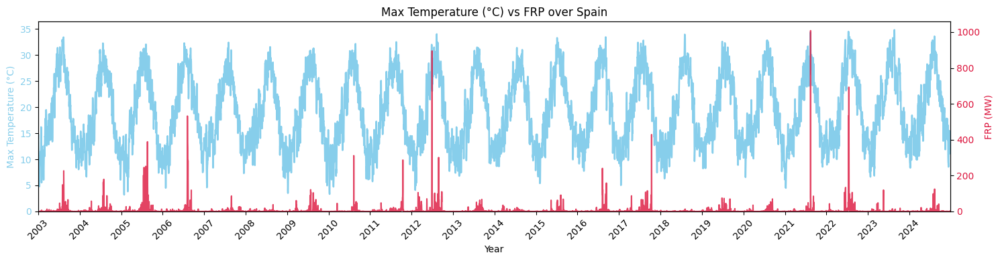


Plotting: Max Wind Speed (m/s) (mean)


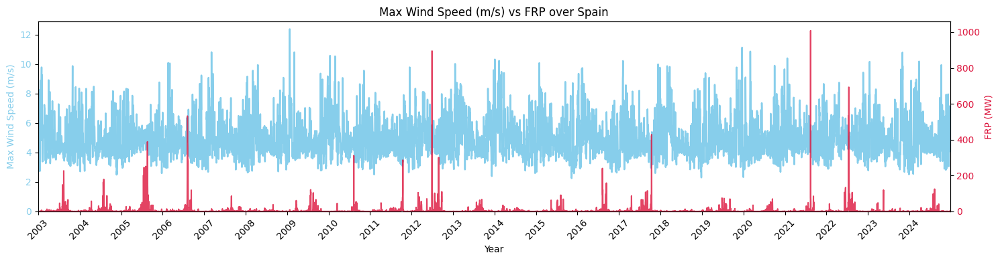

In [36]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Spain')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (mm) (mean) for 2022


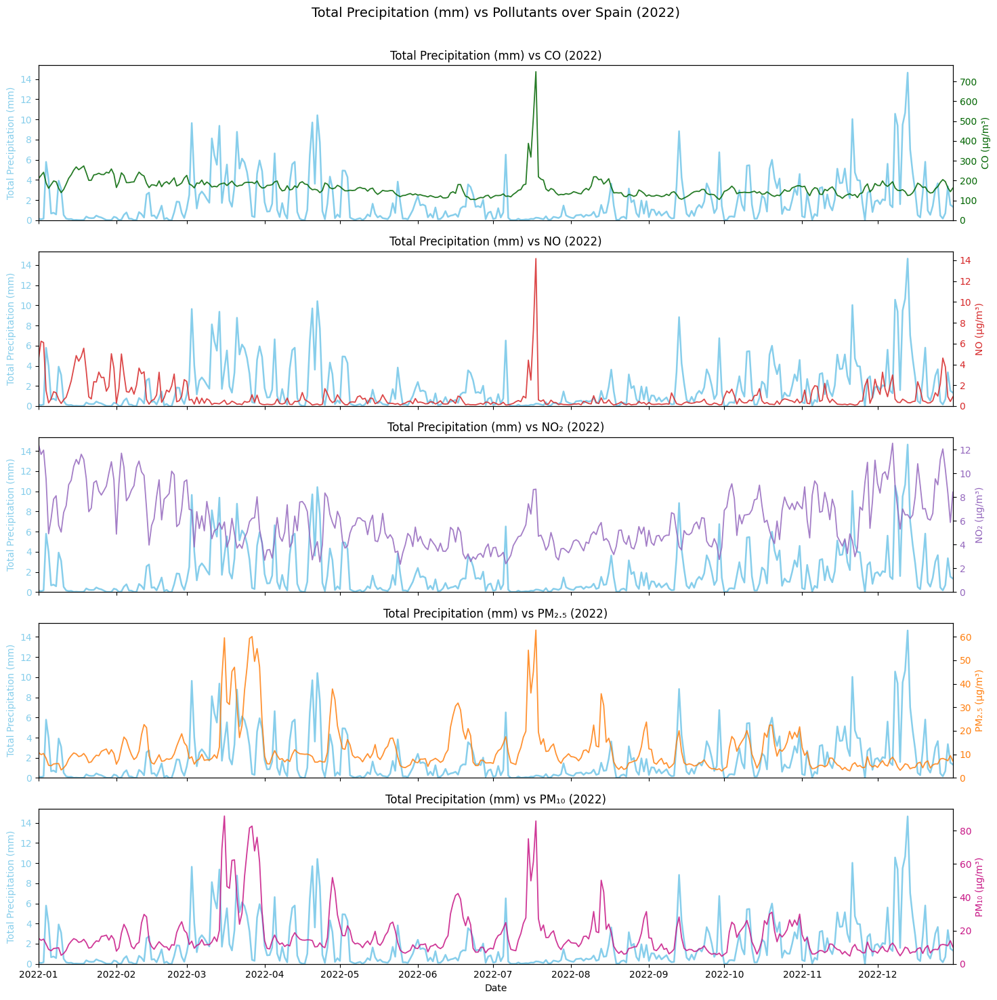


Plotting Max Temperature (°C) (mean) for 2022


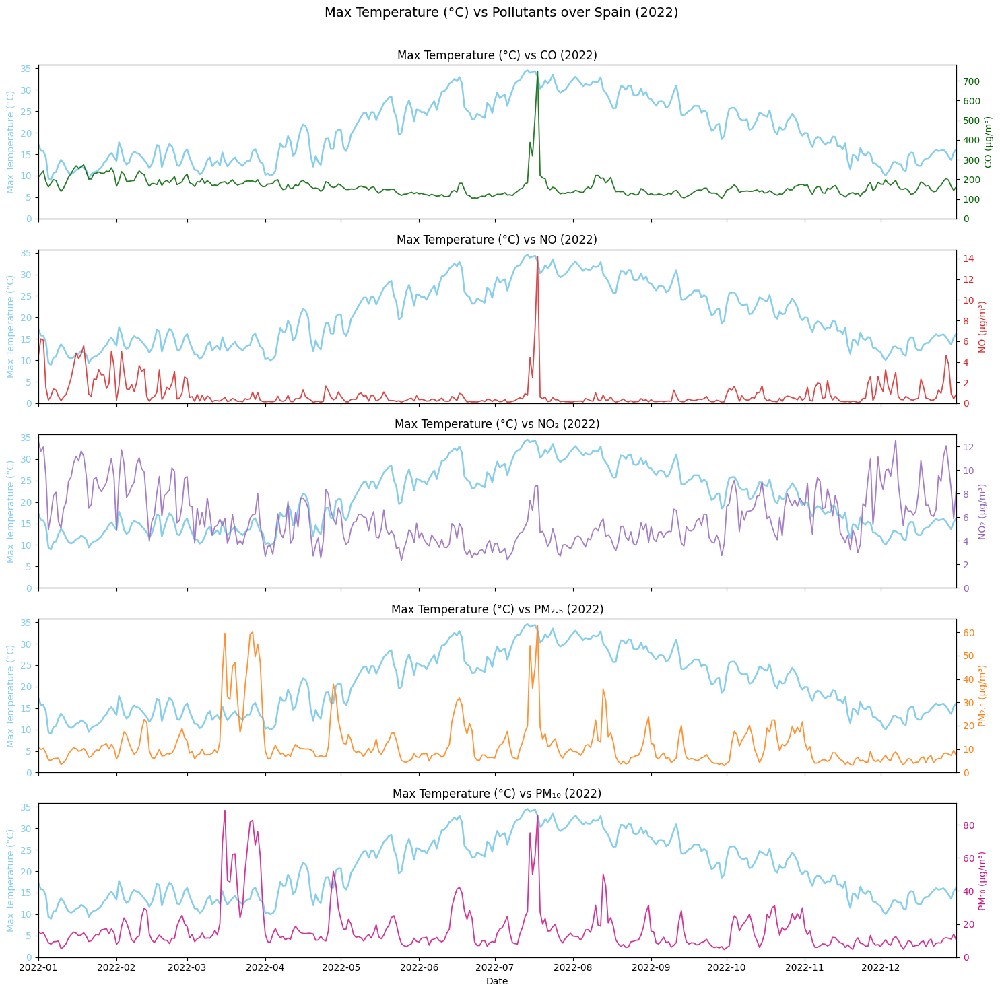


Plotting Max Wind Speed (m/s) (mean) for 2022


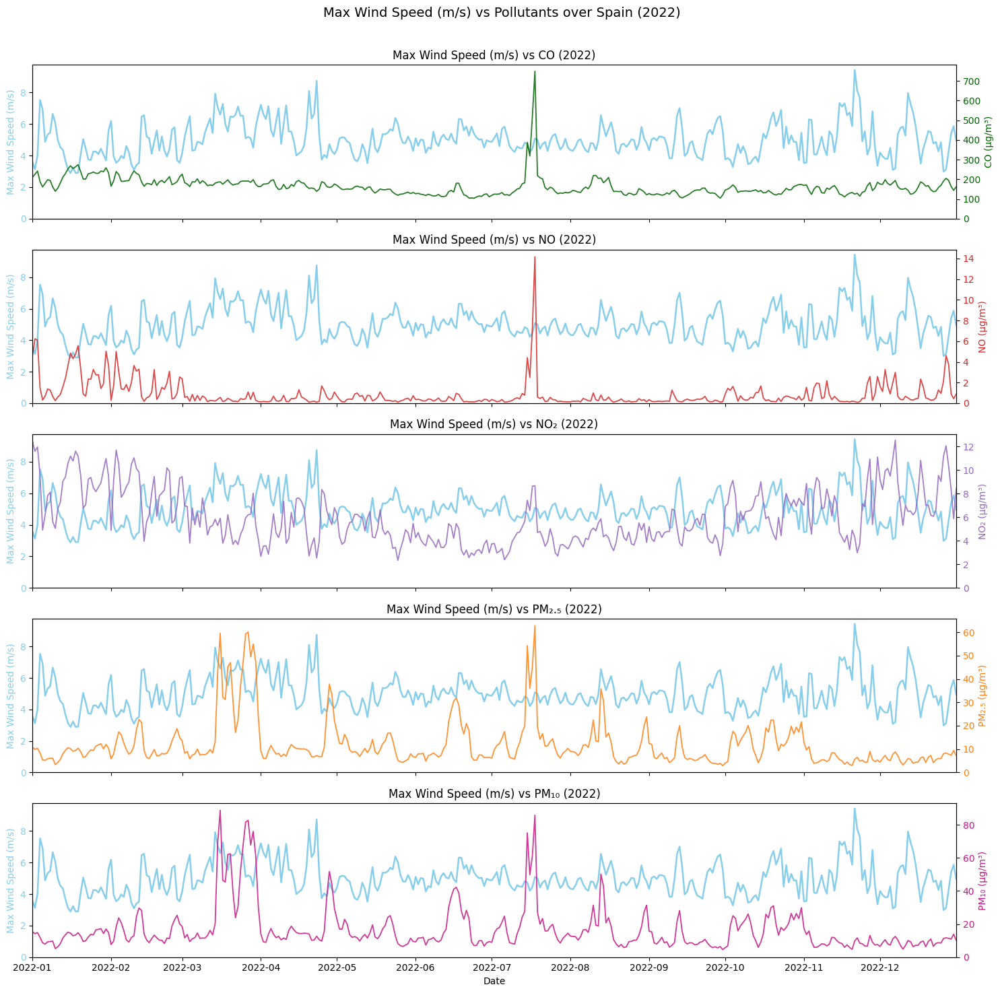

In [35]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2022  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Spain ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (mm) (mean) for 2022


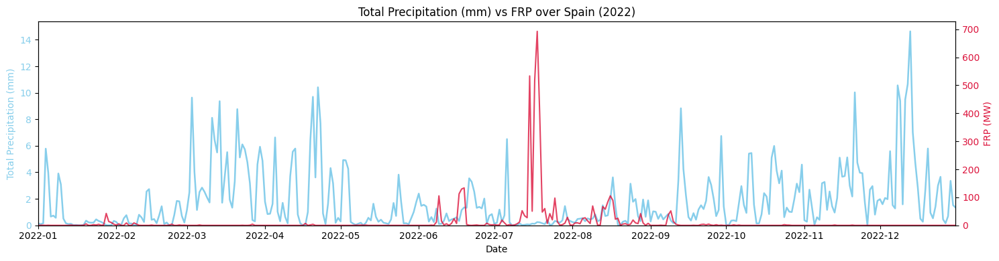


Plotting Max Temperature (°C) (mean) for 2022


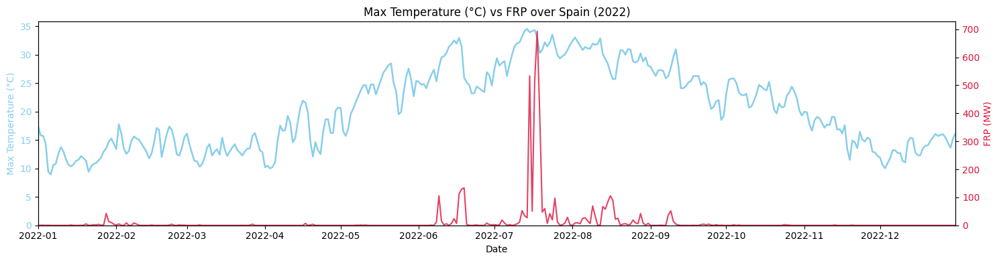


Plotting Max Wind Speed (m/s) (mean) for 2022


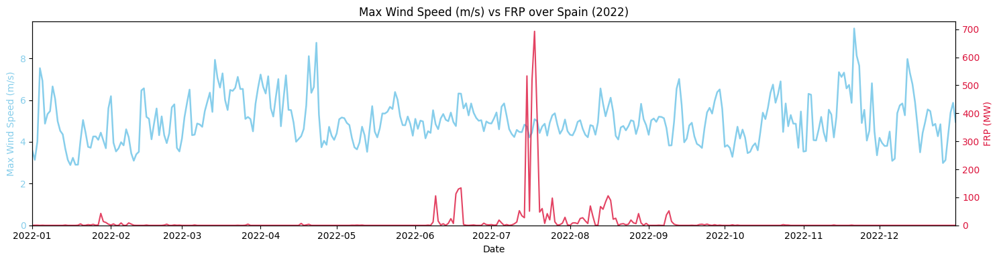

In [34]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2022  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Spain ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Iberia

#### All Years


Plotting: Total Precipitation (mm) (mean)


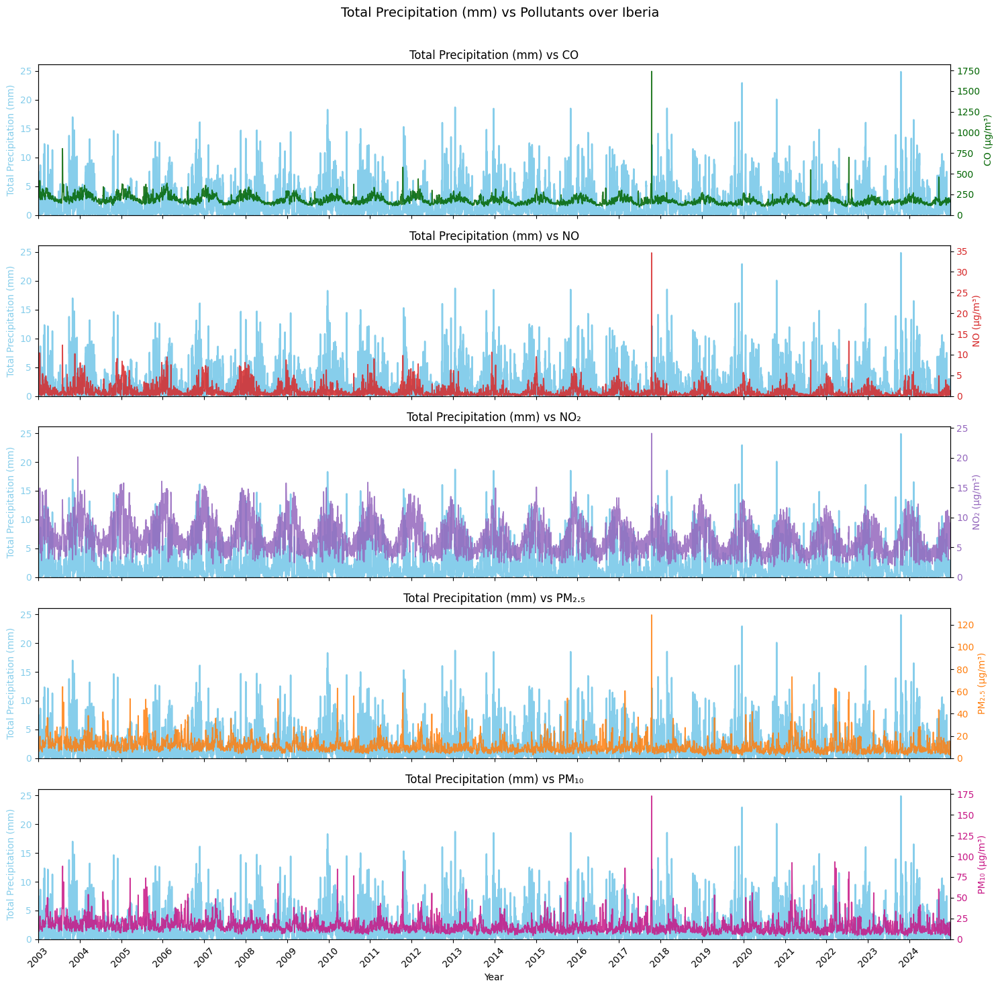


Plotting: Max Temperature (°C) (mean)


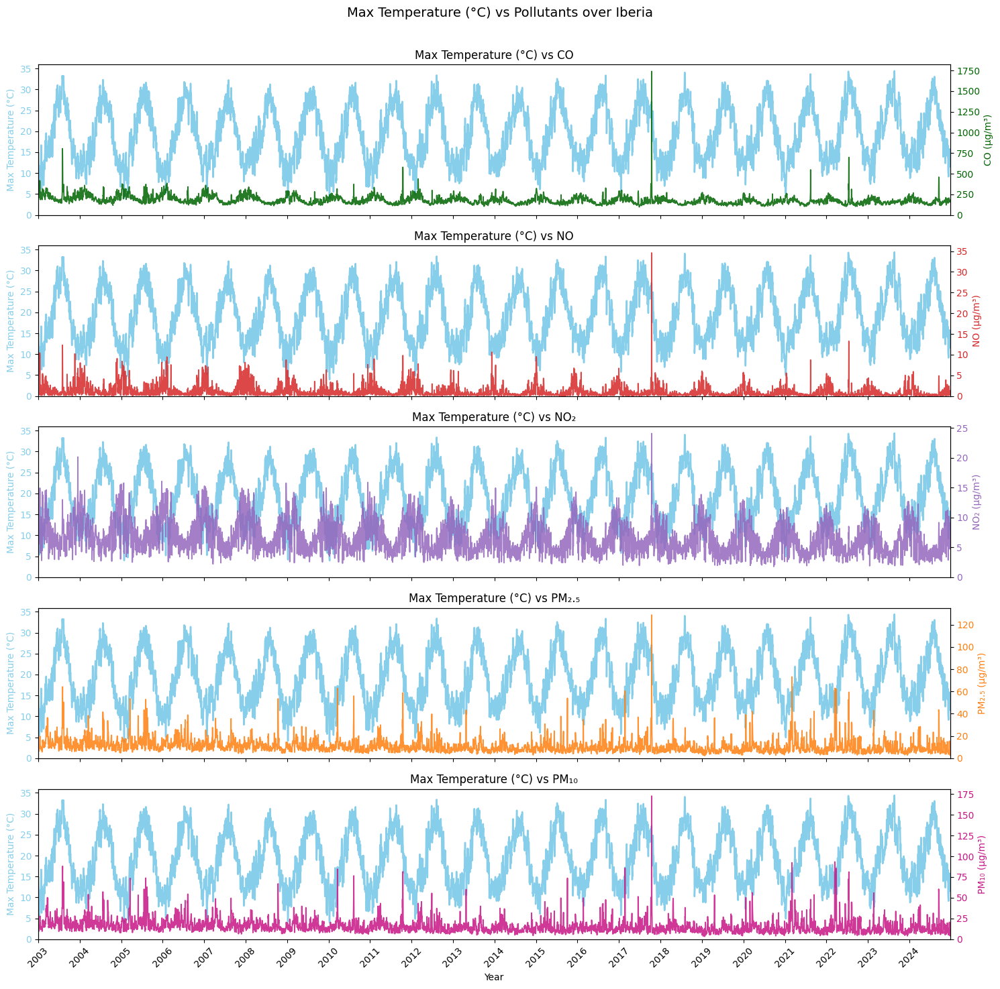


Plotting: Max Wind Speed (m/s) (mean)


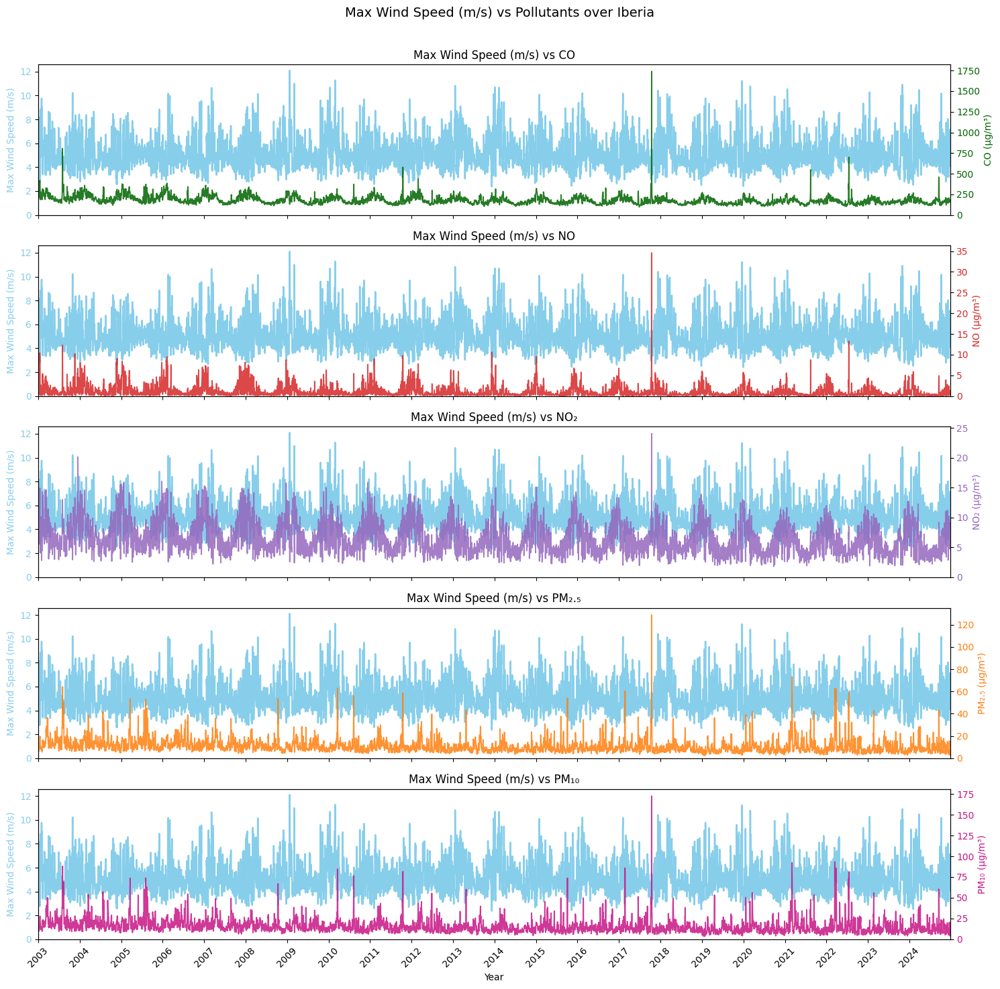

In [41]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Iberia')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (mm) (mean)


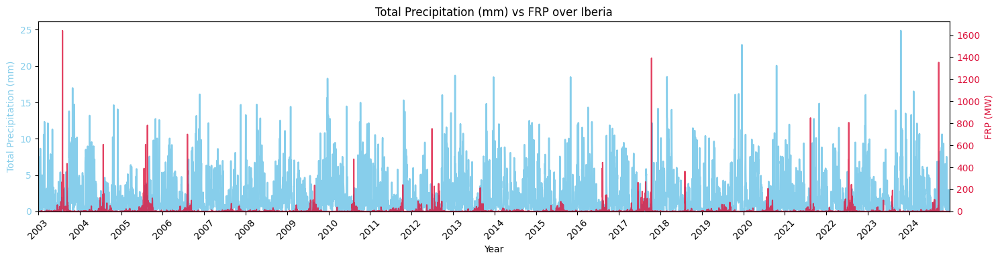


Plotting: Max Temperature (°C) (mean)


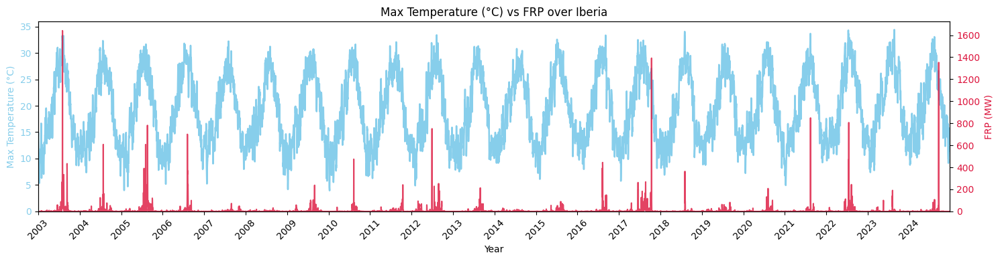


Plotting: Max Wind Speed (m/s) (mean)


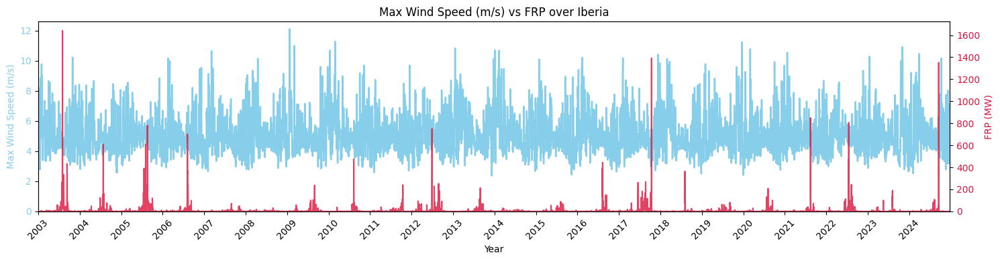

In [42]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Iberia')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (mm) (mean) for 2017


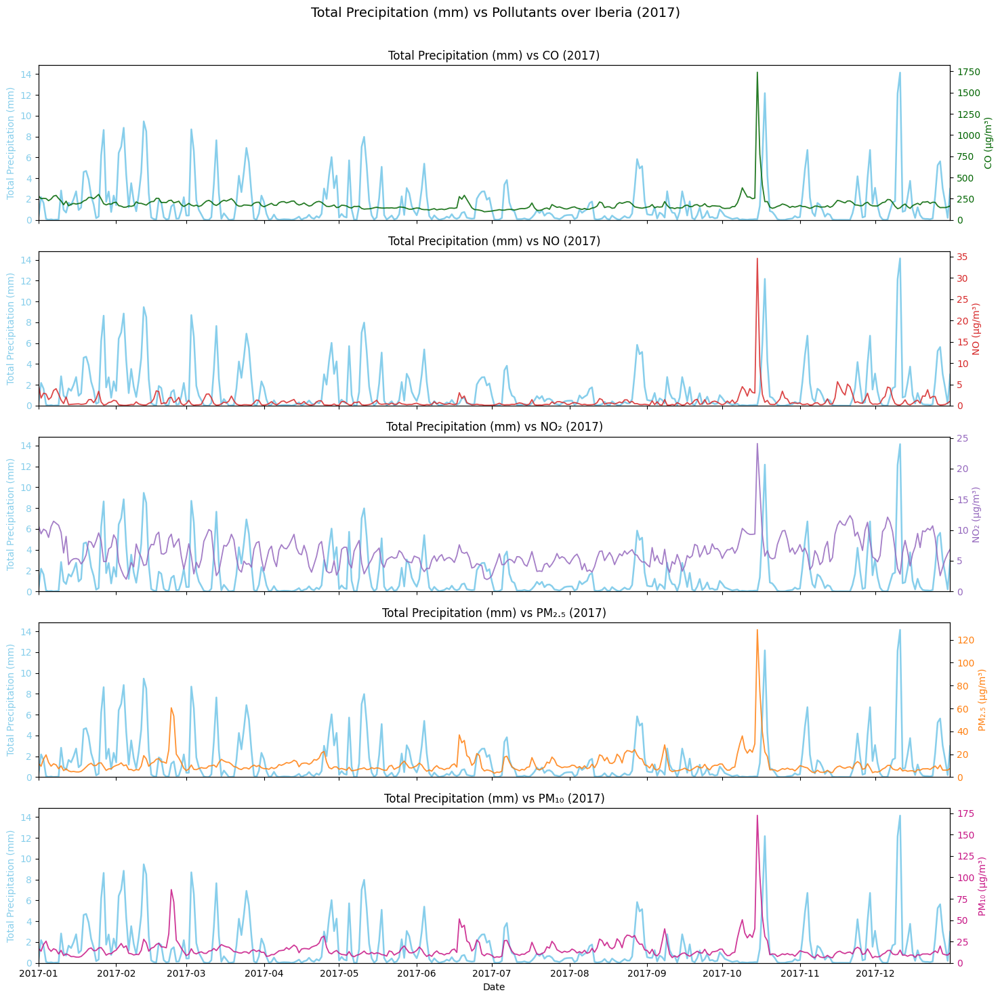


Plotting Max Temperature (°C) (mean) for 2017


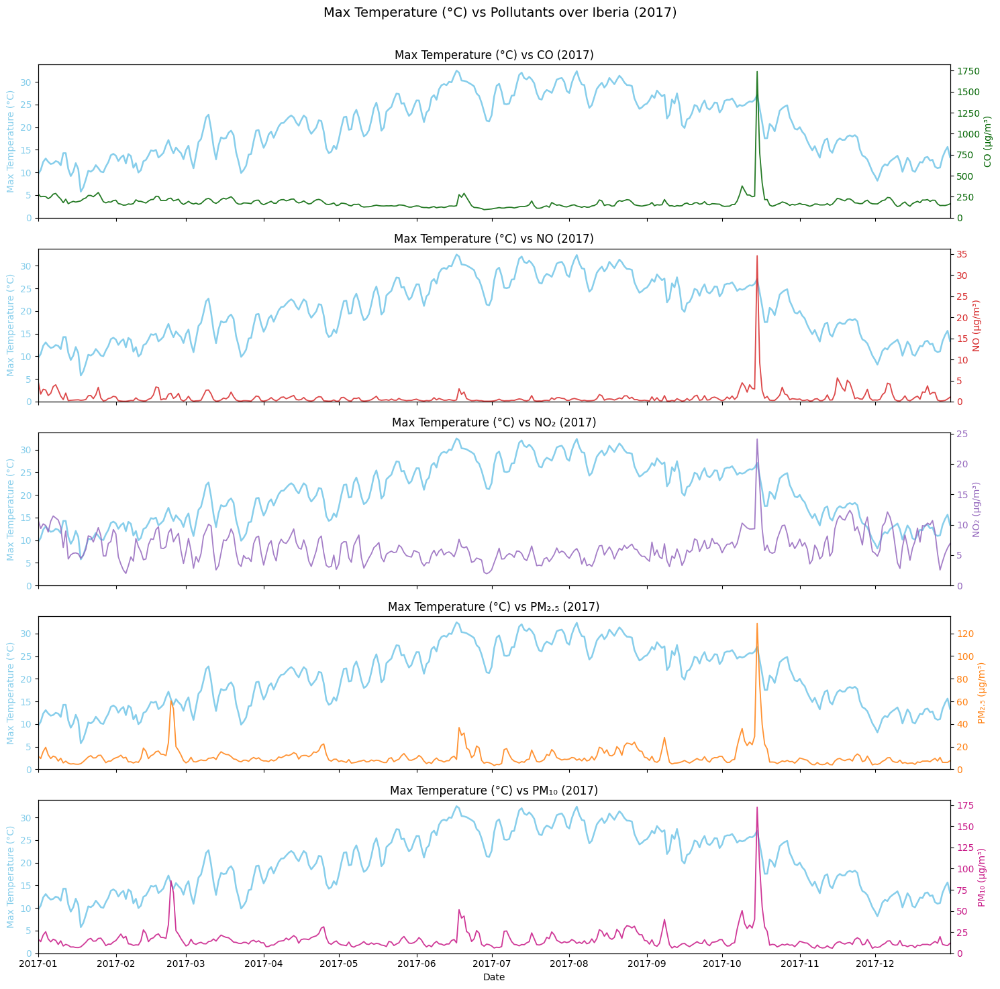


Plotting Max Wind Speed (m/s) (mean) for 2017


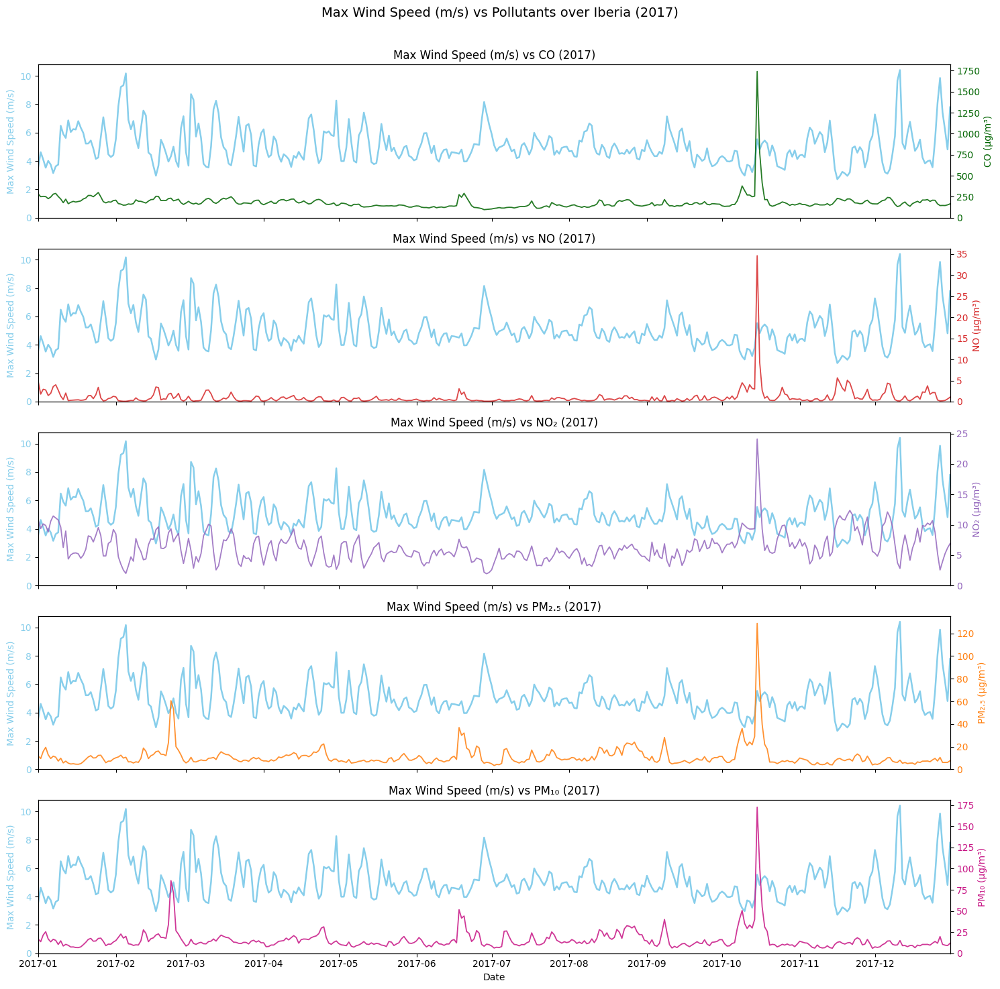

In [44]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Iberia ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (mm) (mean) for 2017


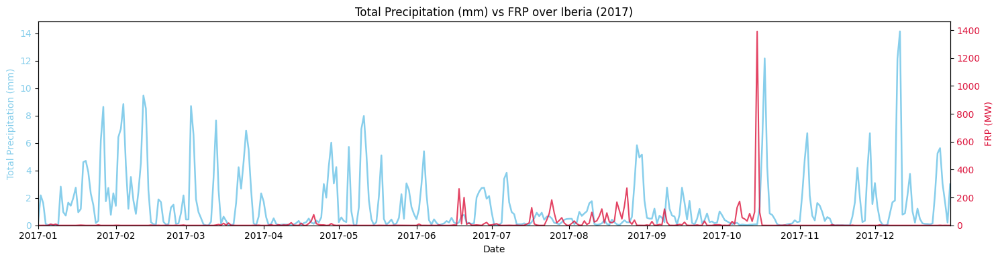


Plotting Max Temperature (°C) (mean) for 2017


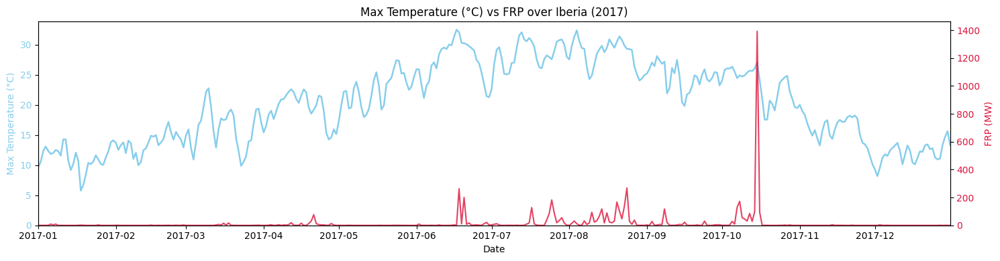


Plotting Max Wind Speed (m/s) (mean) for 2017


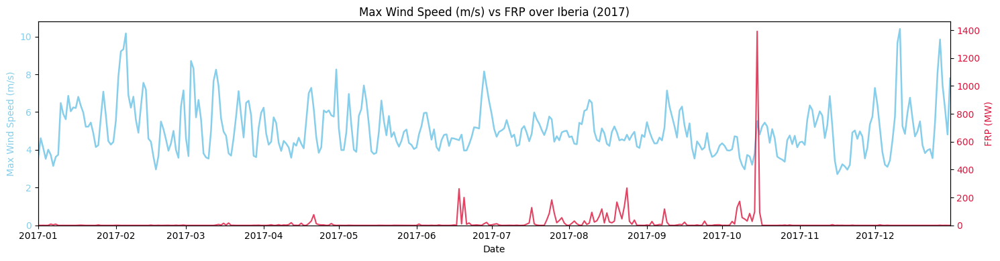

In [45]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Iberia ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Italy

#### All Years


Plotting: Total Precipitation (mm) (mean)


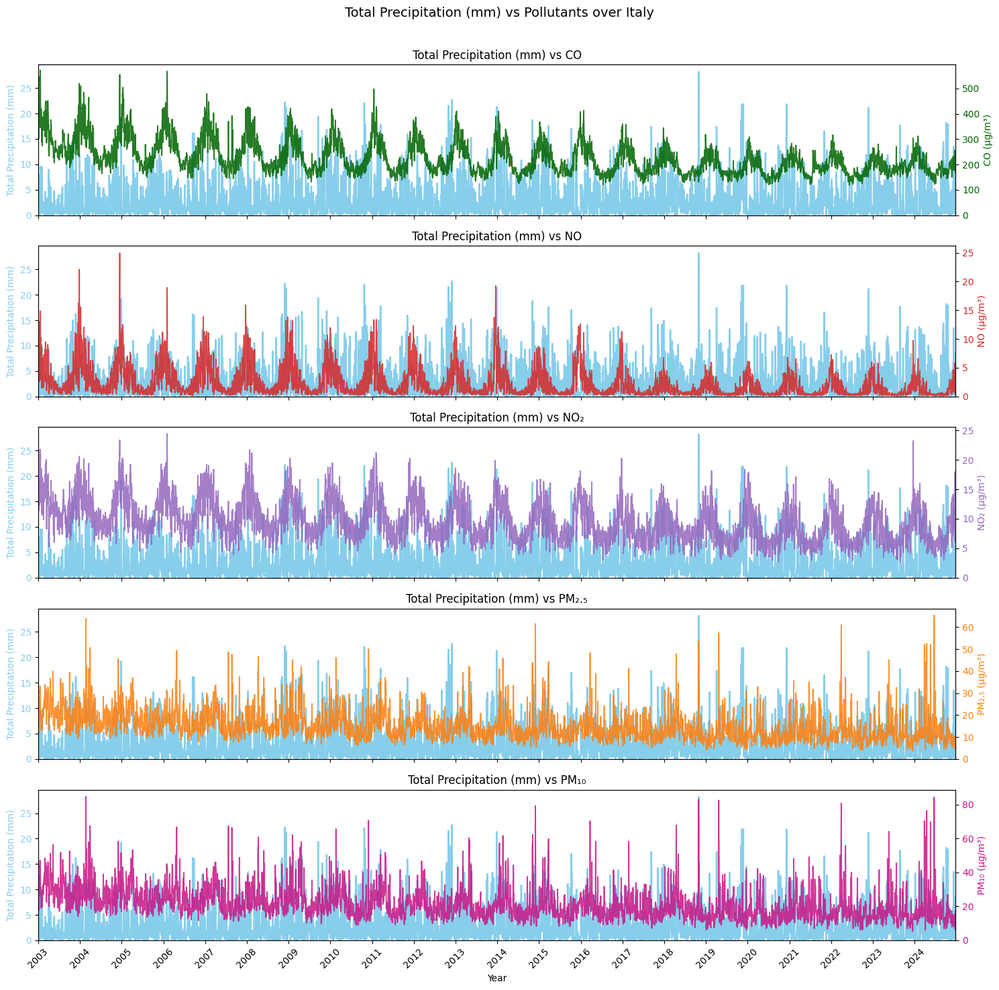


Plotting: Max Temperature (°C) (mean)


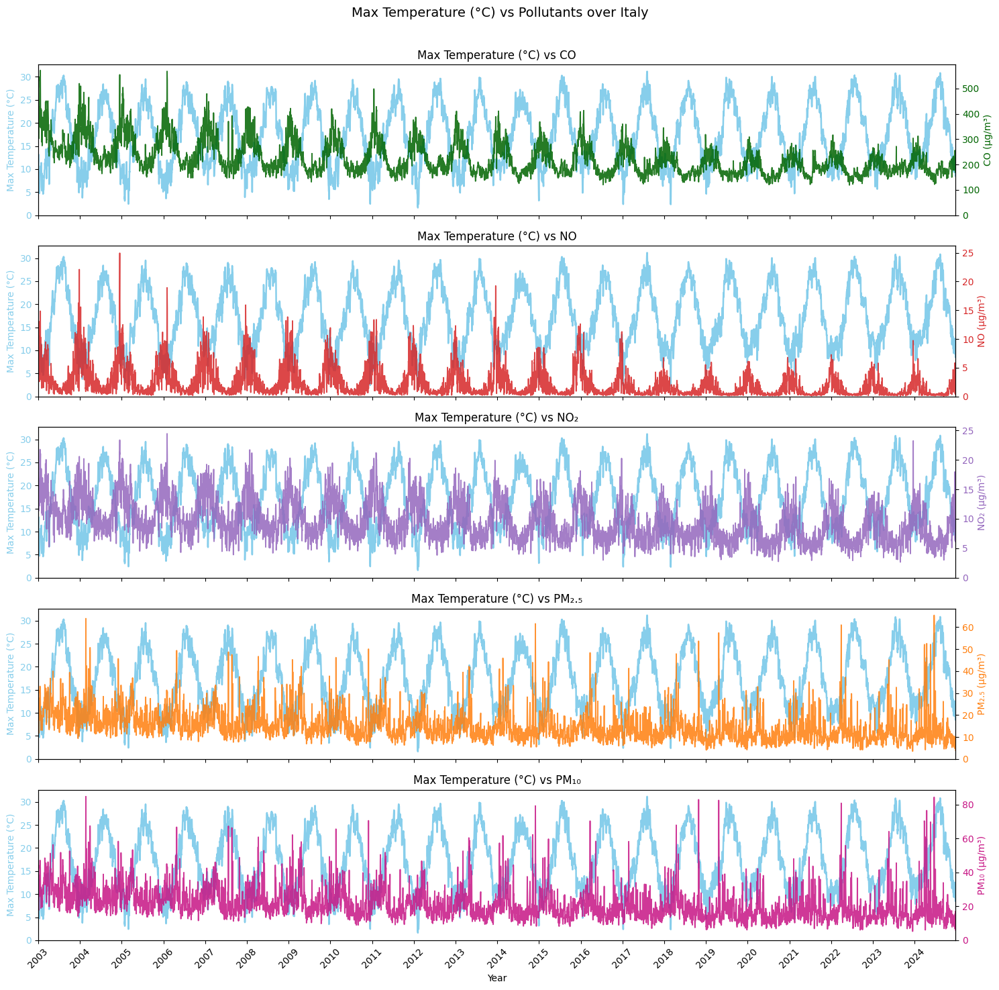


Plotting: Max Wind Speed (m/s) (mean)


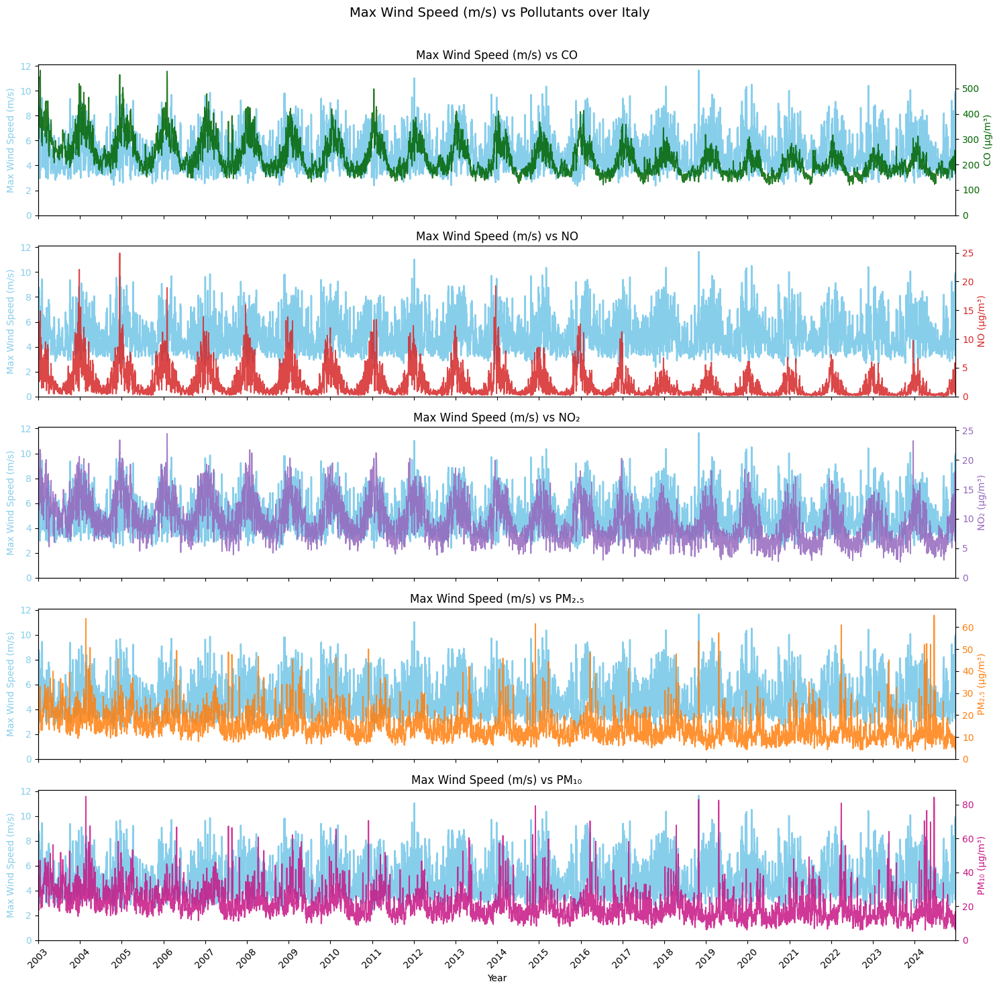

In [46]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Italy')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (mm) (mean)


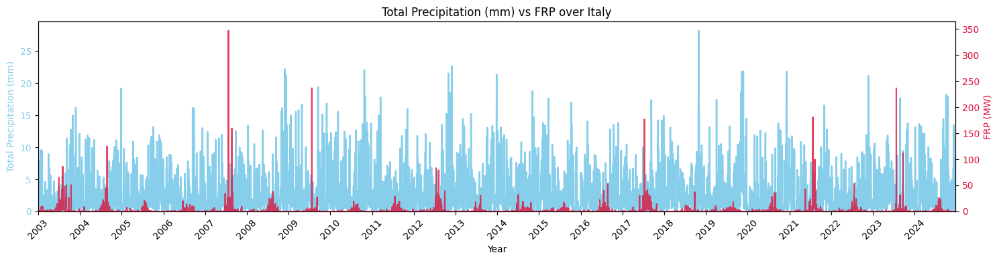


Plotting: Max Temperature (°C) (mean)


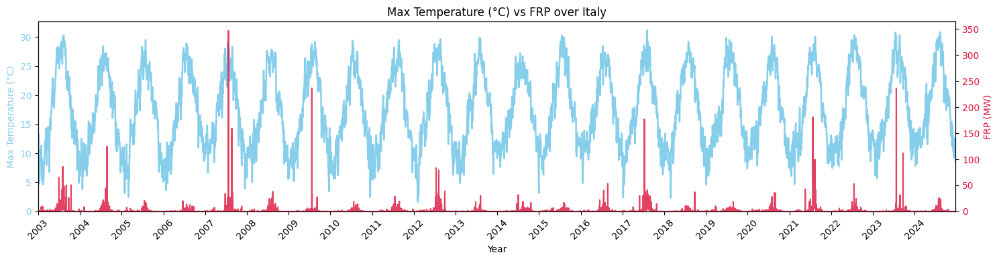


Plotting: Max Wind Speed (m/s) (mean)


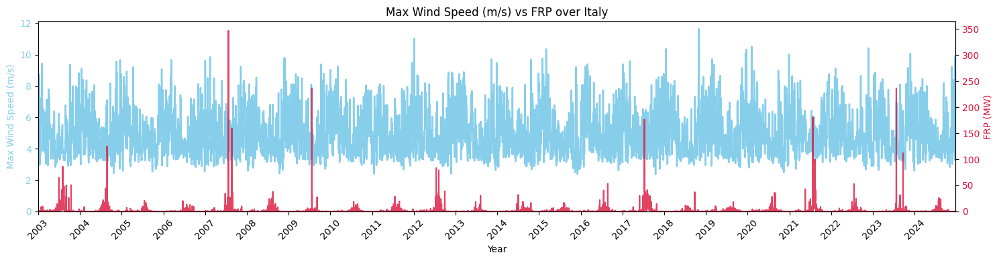

In [47]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Italy')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (mm) (mean) for 2007


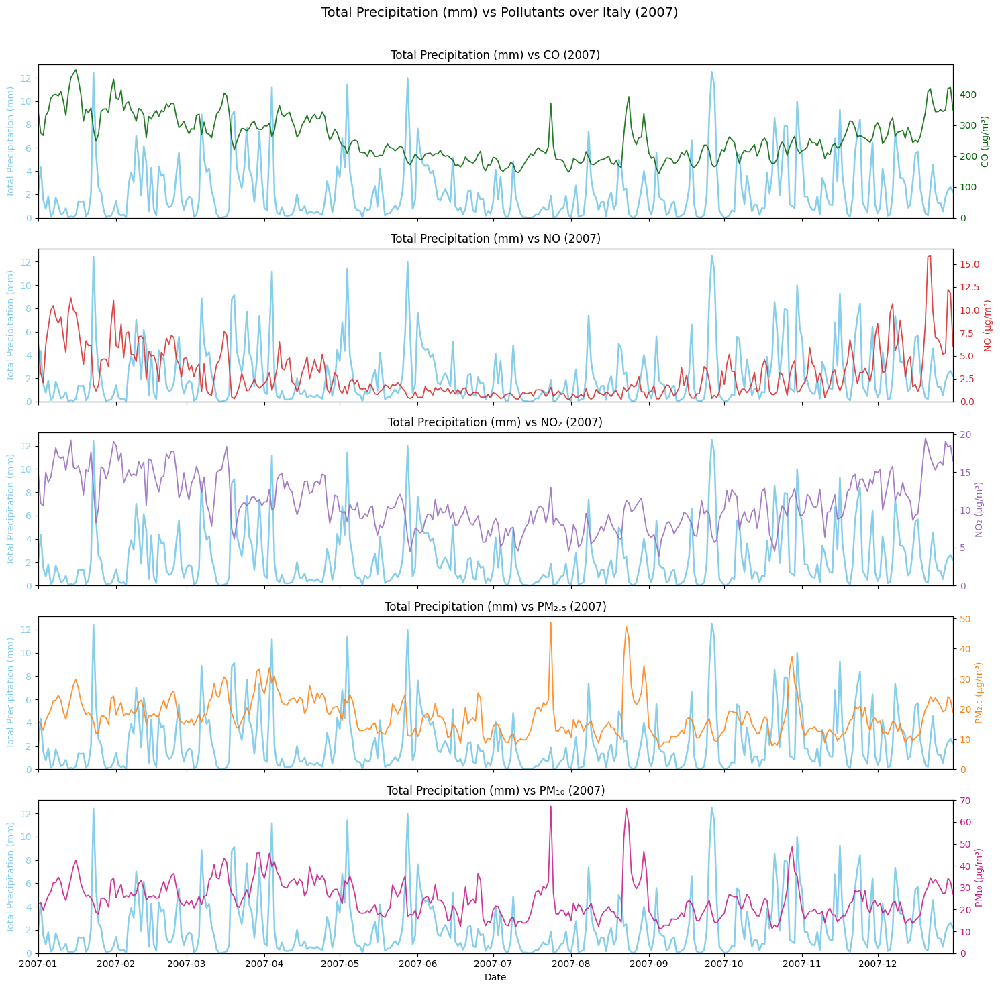


Plotting Max Temperature (°C) (mean) for 2007


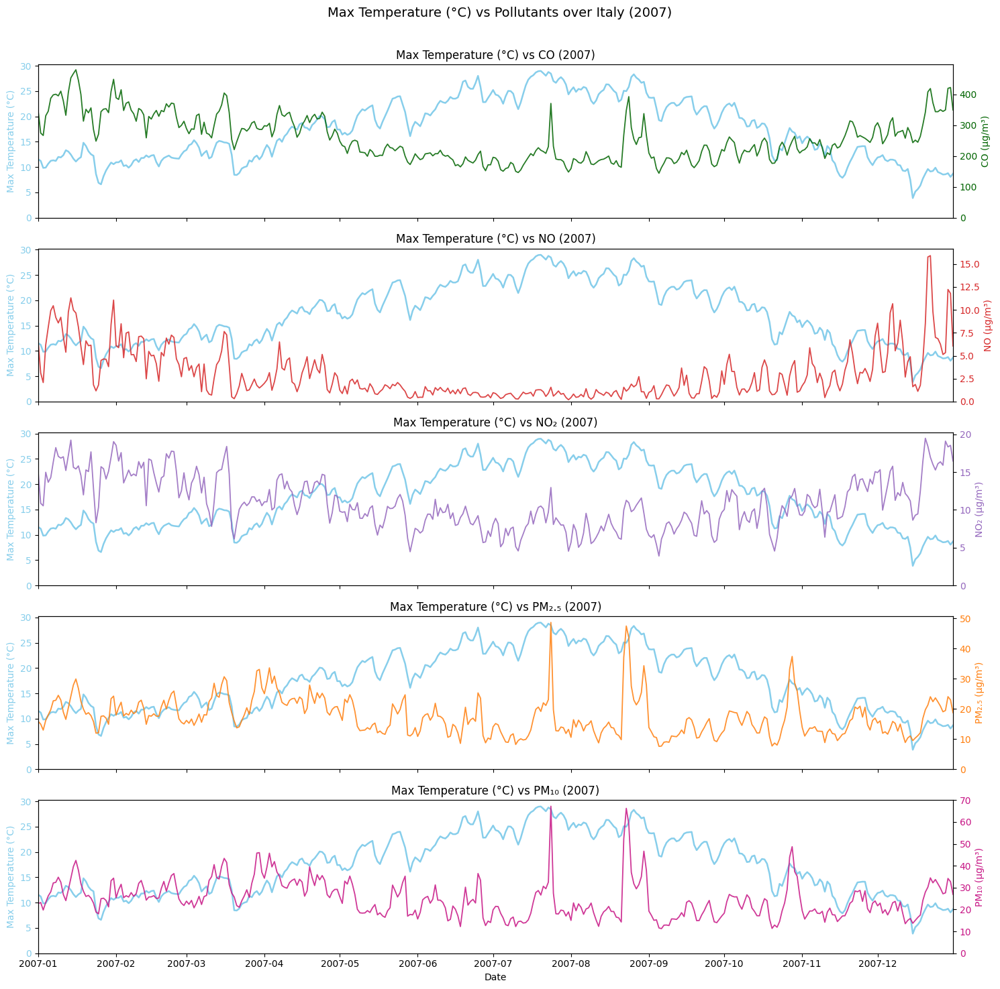


Plotting Max Wind Speed (m/s) (mean) for 2007


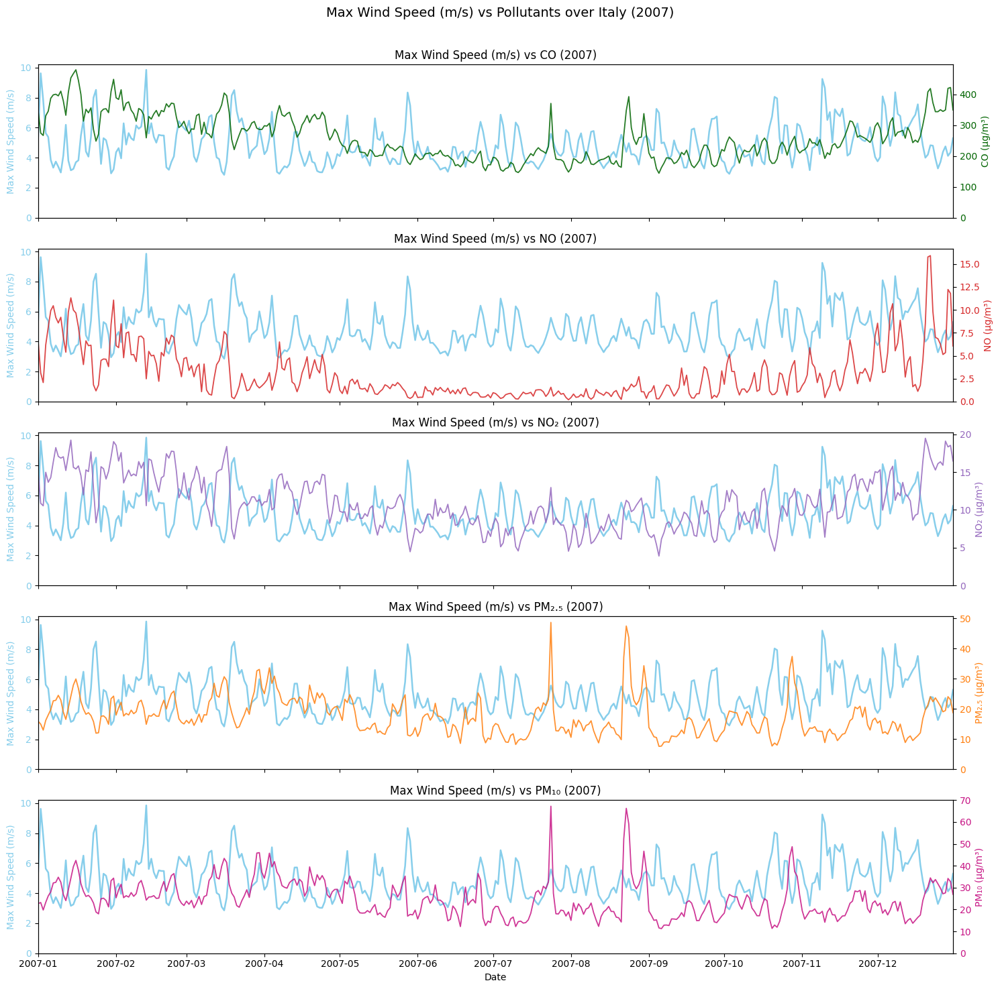

In [48]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2007  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Italy ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (mm) (mean) for 2007


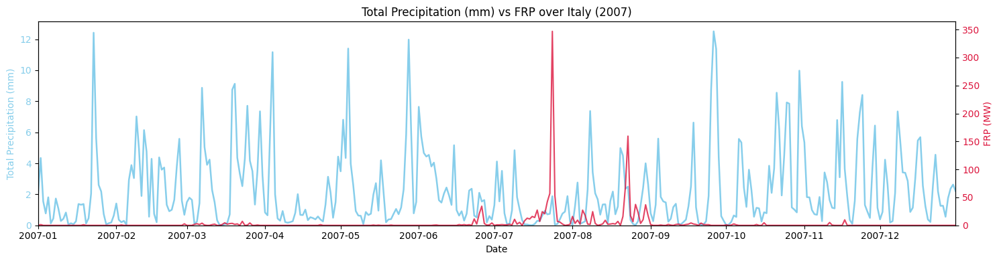


Plotting Max Temperature (°C) (mean) for 2007


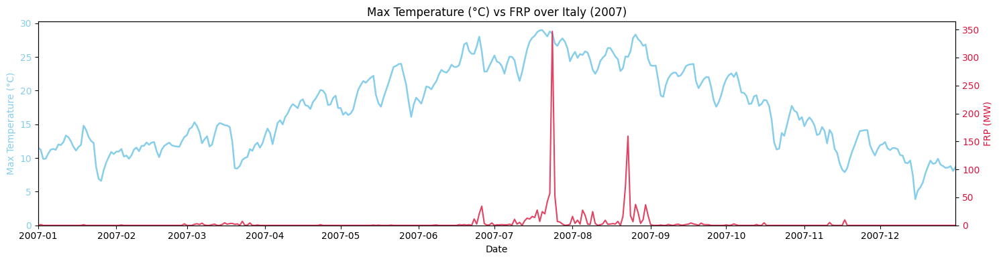


Plotting Max Wind Speed (m/s) (mean) for 2007


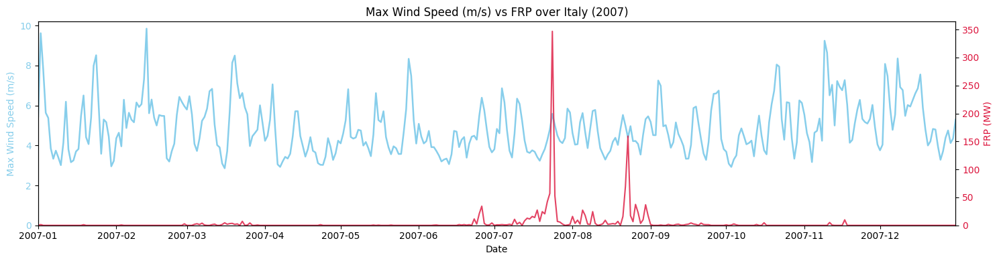

In [49]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2007  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Italy ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Greece

#### All Years


Plotting: Total Precipitation (mm) (mean)


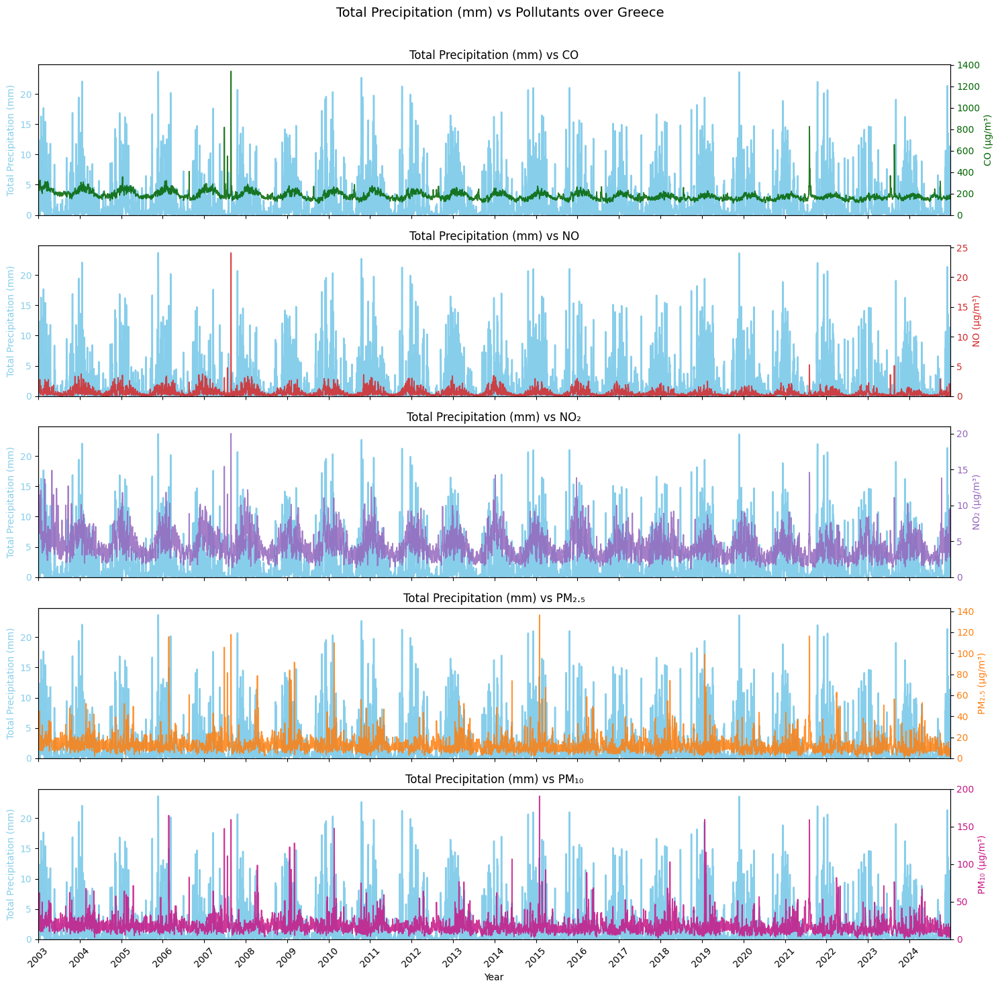


Plotting: Max Temperature (°C) (mean)


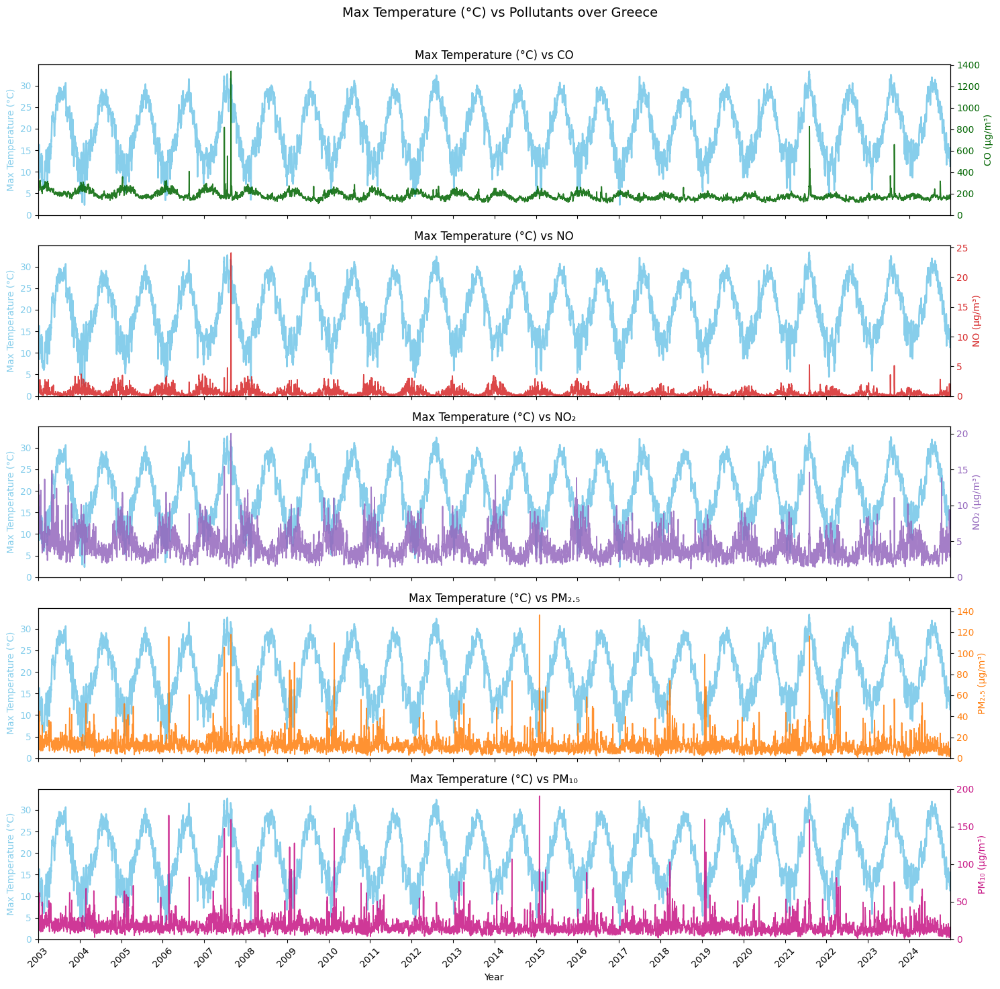


Plotting: Max Wind Speed (m/s) (mean)


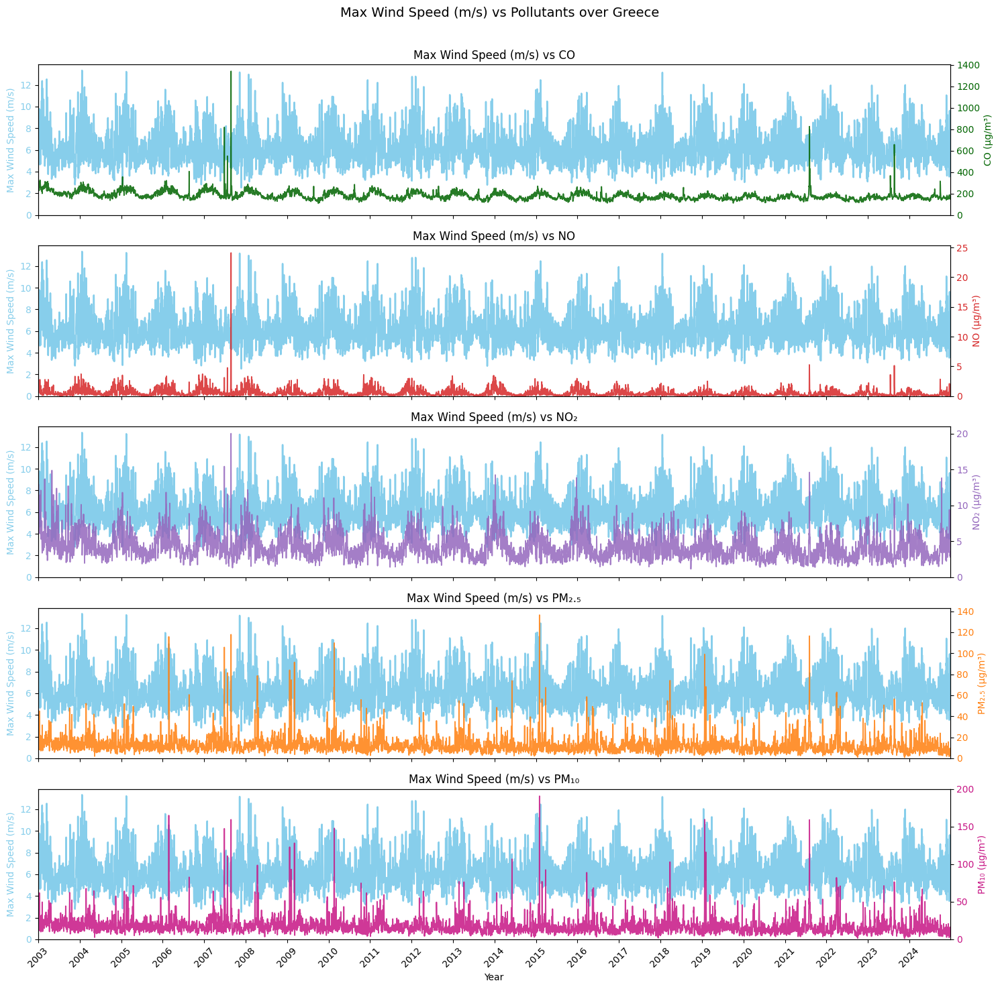

In [50]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Greece')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (mm) (mean)


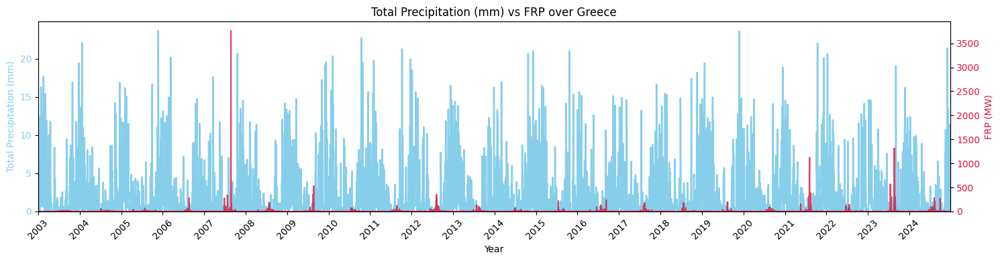


Plotting: Max Temperature (°C) (mean)


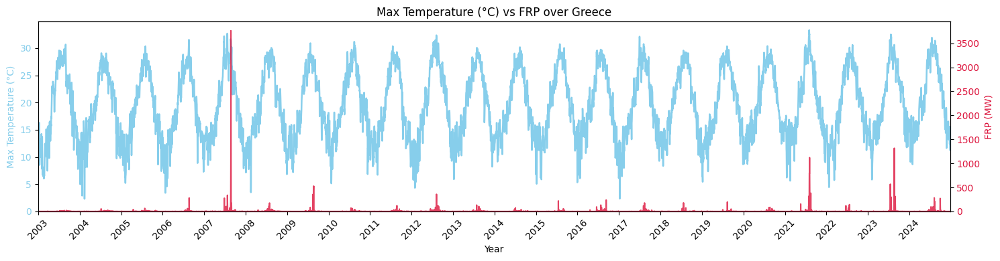


Plotting: Max Wind Speed (m/s) (mean)


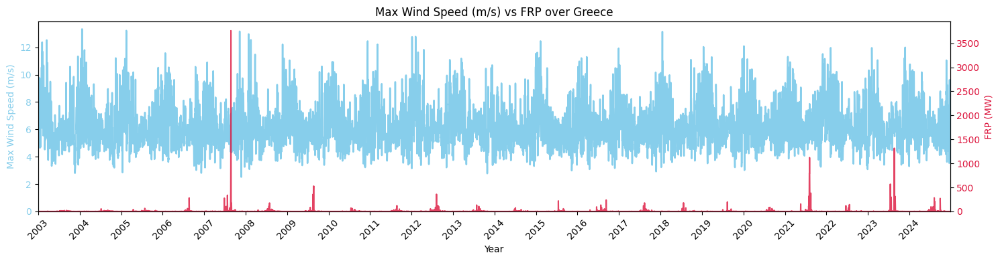

In [51]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Greece')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (mm) (mean) for 2023


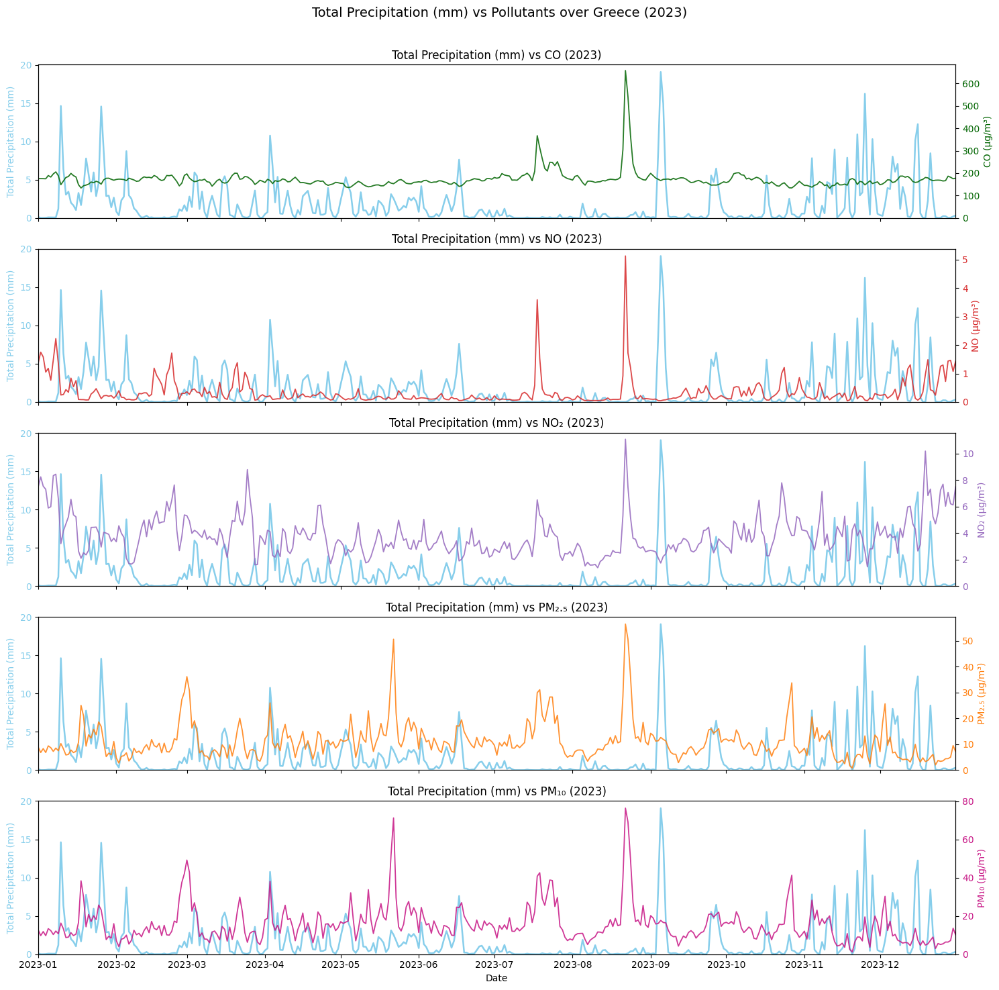


Plotting Max Temperature (°C) (mean) for 2023


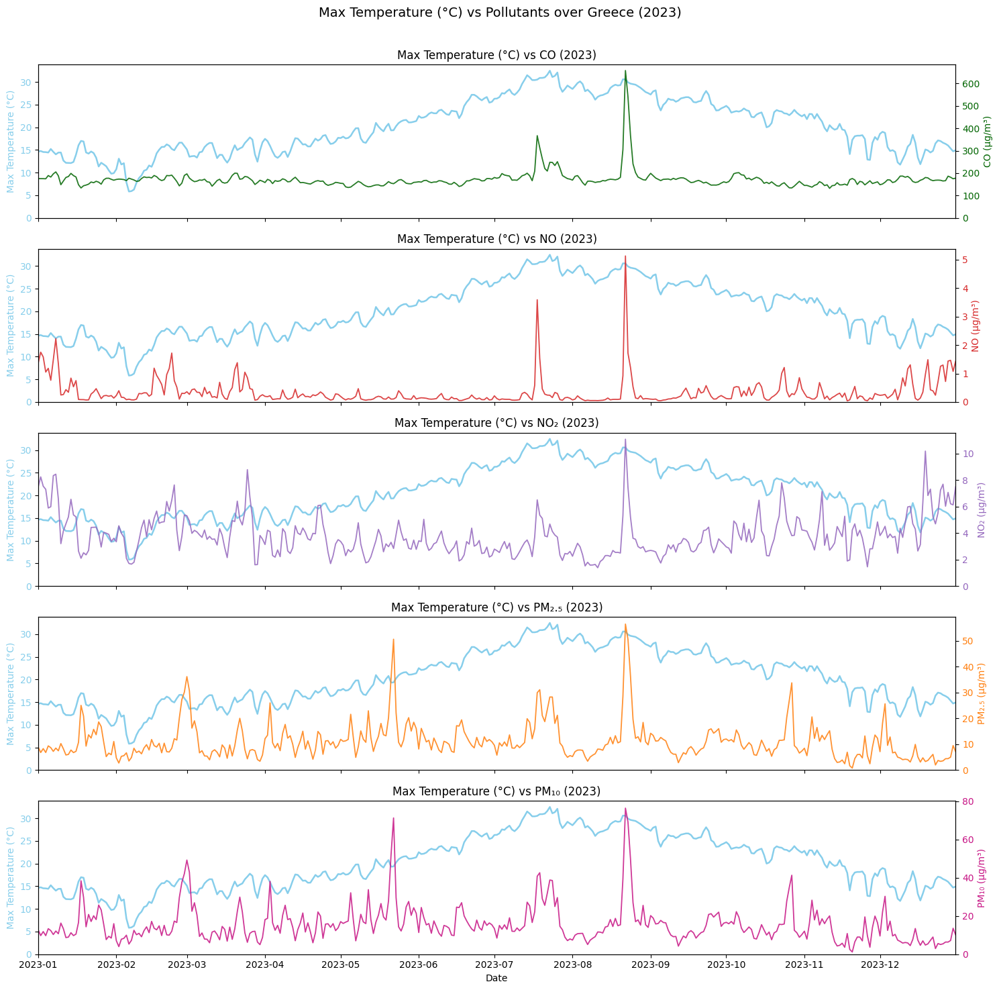


Plotting Max Wind Speed (m/s) (mean) for 2023


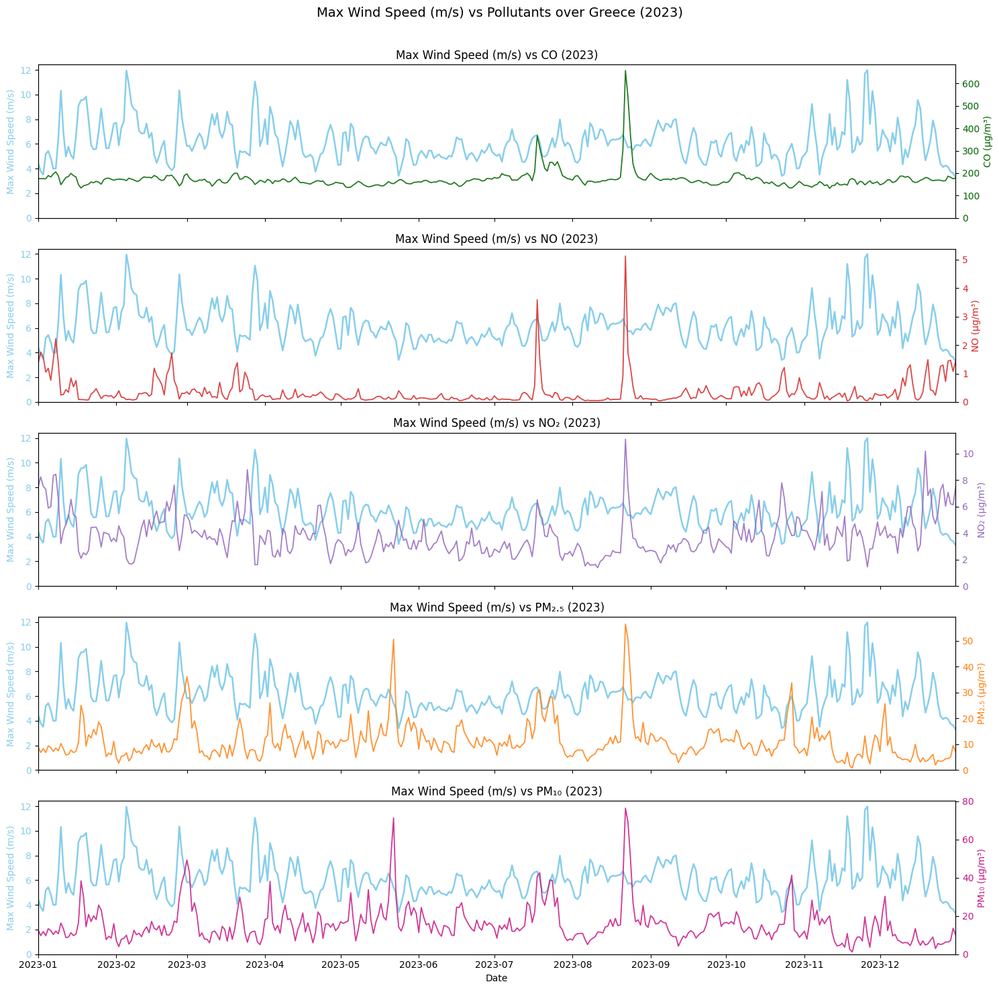

In [52]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2023  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Greece ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (mm) (mean) for 2023


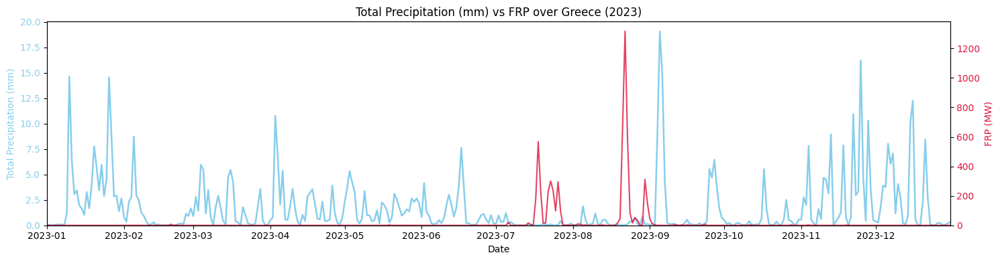


Plotting Max Temperature (°C) (mean) for 2023


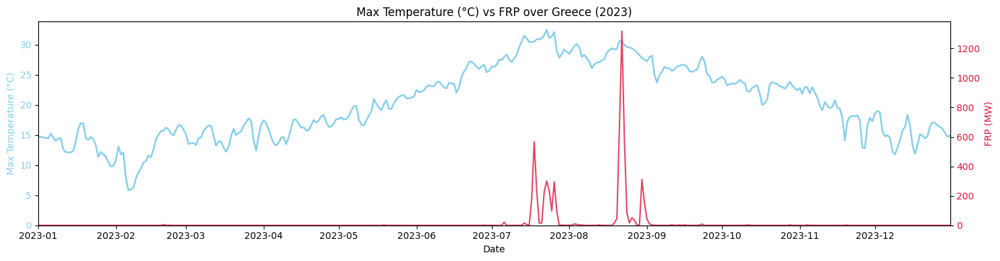


Plotting Max Wind Speed (m/s) (mean) for 2023


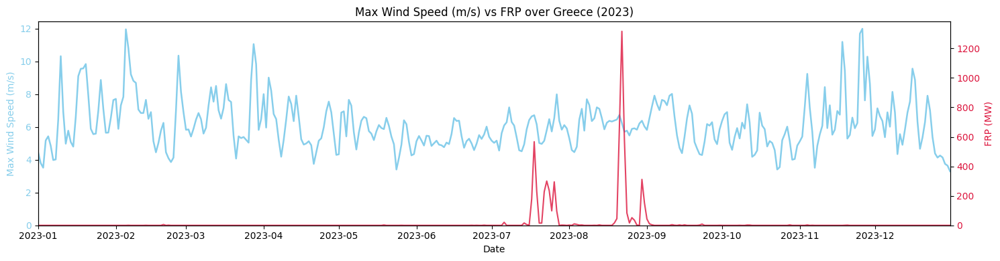

In [53]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2023  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Greece ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


## Crossover of Meteo and Pollutants - Scatterplot

In [52]:
            # # Linear regression line + R²
            # model = LinearRegression().fit(x, y)
            # y_pred = model.predict(x)
            # r2 = r2_score(y, y_pred)
            # ax.plot(x, y_pred, color='black', linestyle='--', linewidth=1.2,
            #         label=f'Fit (R² = {r2:.2f})')

### Portugal

#### All Years


Plotting correlations for: Total Precipitation (mm) (mean)


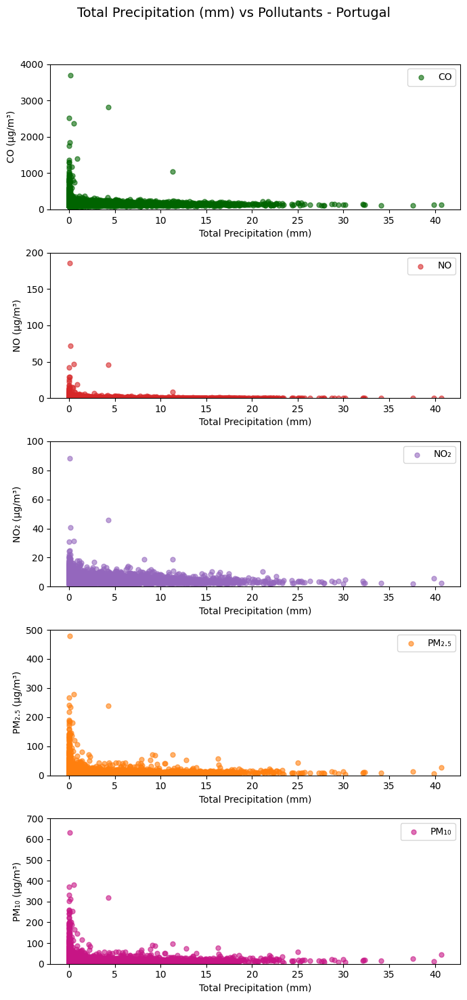


Plotting correlations for: Max Temperature (°C) (mean)


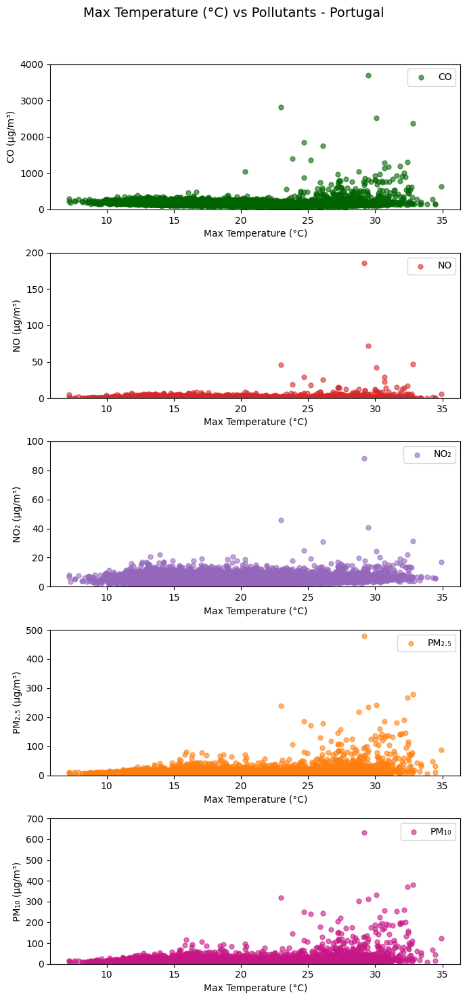


Plotting correlations for: Max Wind Speed (m/s) (mean)


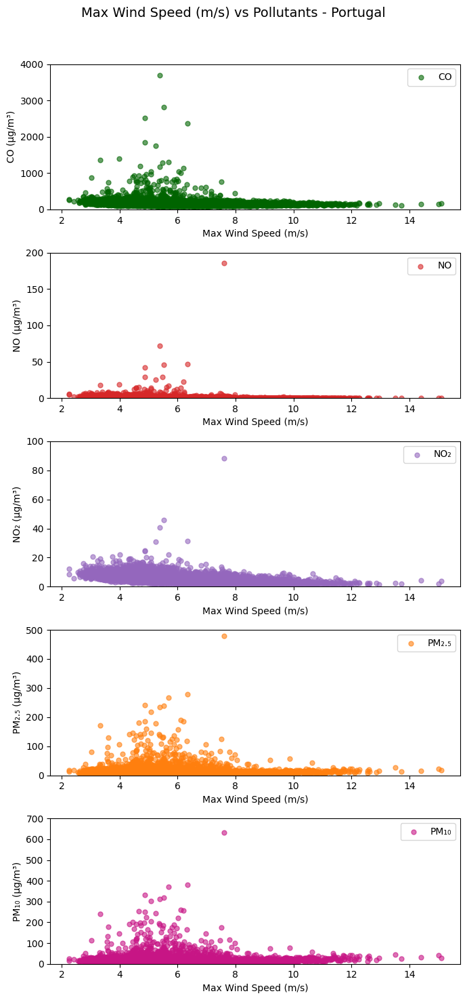

In [75]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - Portugal')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants - Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()



Plotting correlations for: Total Precipitation (mm) (mean)


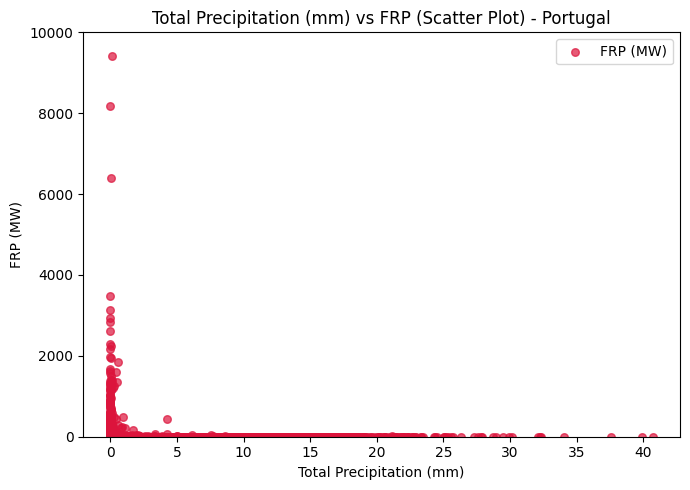


Plotting correlations for: Max Temperature (°C) (mean)


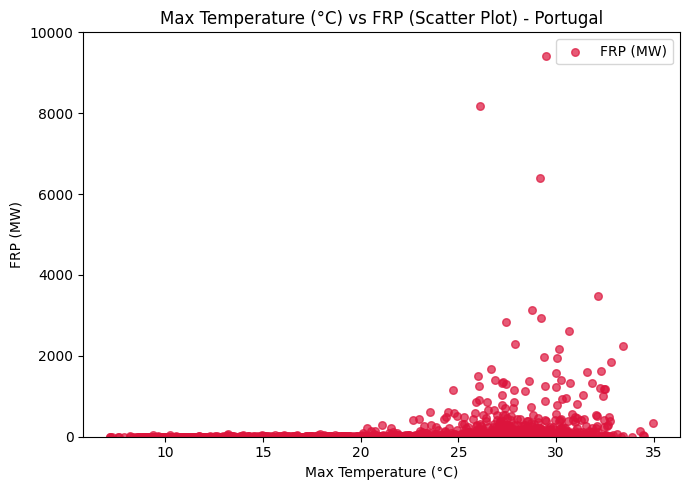


Plotting correlations for: Max Wind Speed (m/s) (mean)


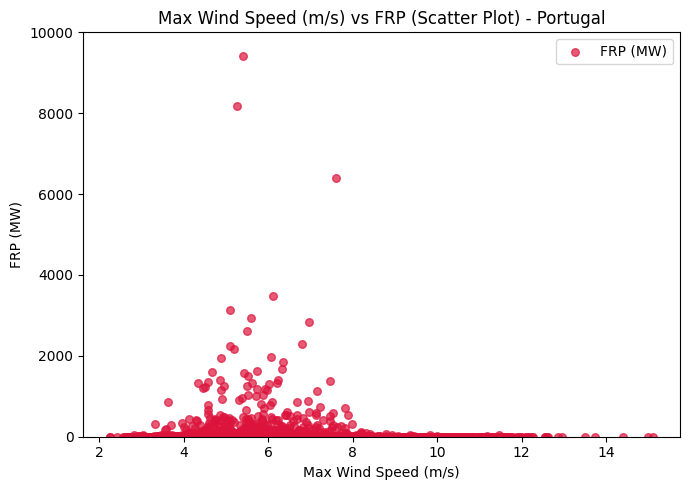

In [74]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - Portugal')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants - Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Year


Plotting correlations for: Total Precipitation (mm) (mean)


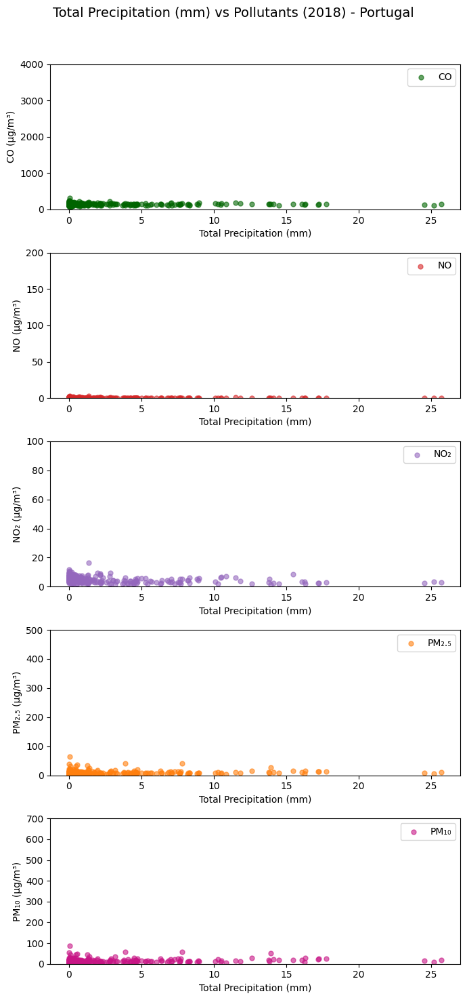


Plotting correlations for: Max Temperature (°C) (mean)


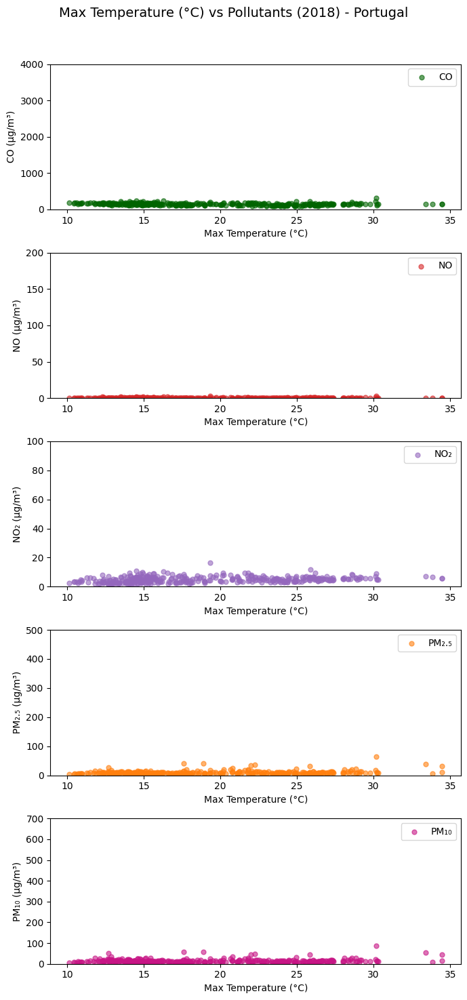


Plotting correlations for: Max Wind Speed (m/s) (mean)


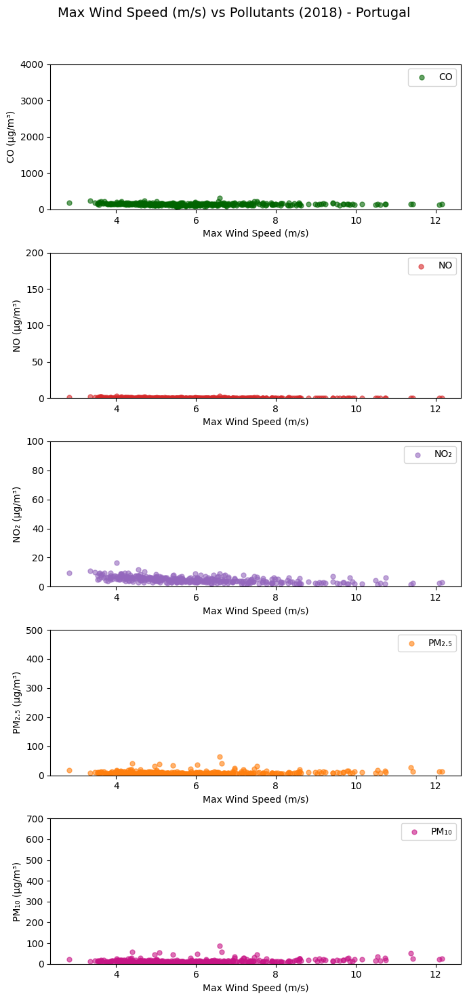

In [73]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2018  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year} - Portugal')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year}) - Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Spain

#### All Years


Plotting correlations for: Total Precipitation (mm) (mean)


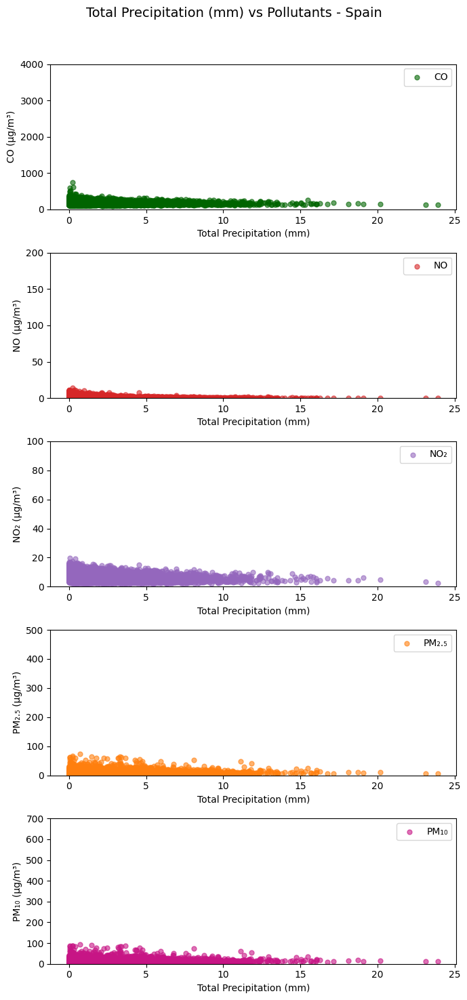


Plotting correlations for: Max Temperature (°C) (mean)


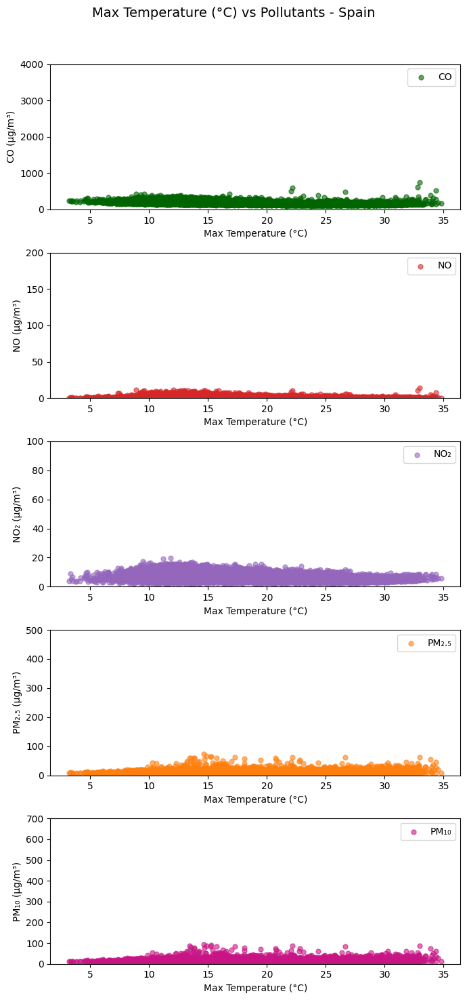


Plotting correlations for: Max Wind Speed (m/s) (mean)


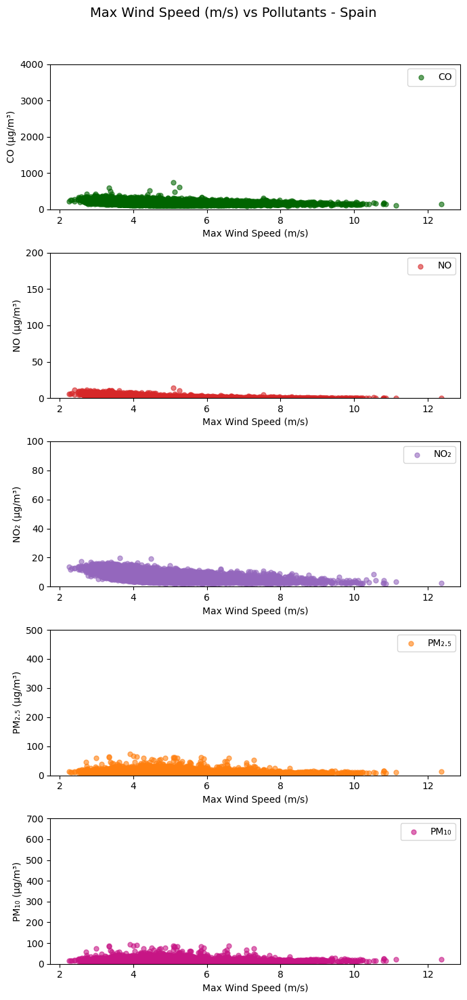

In [72]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - Spain')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants - Spain', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (mm) (mean)


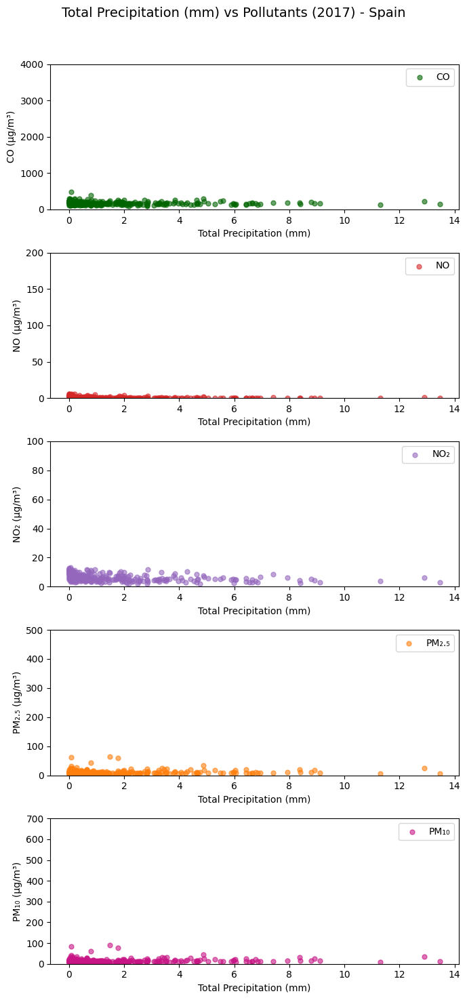


Plotting correlations for: Max Temperature (°C) (mean)


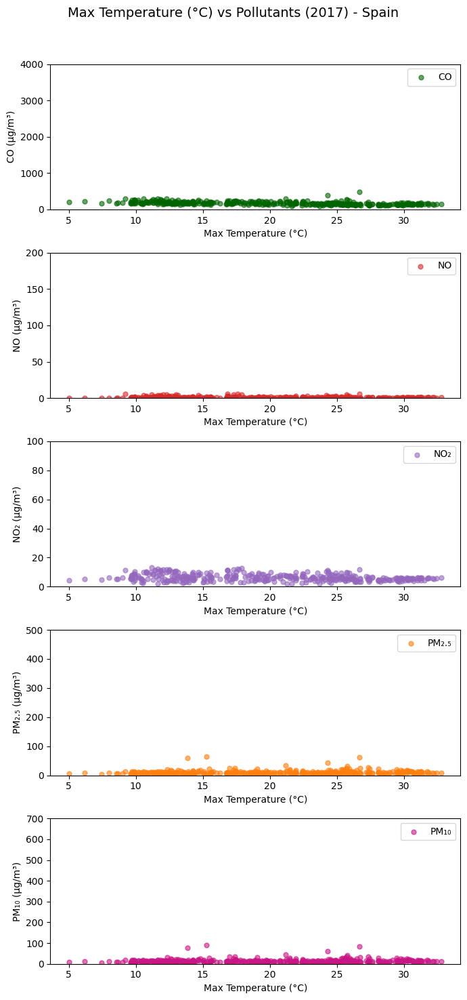


Plotting correlations for: Max Wind Speed (m/s) (mean)


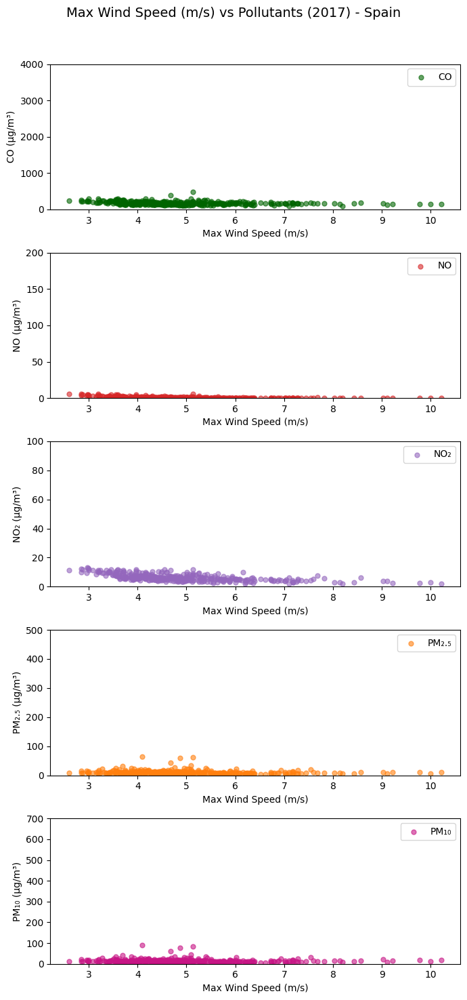

In [71]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year} - Spain')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year}) - Spain', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Iberia

#### All Years


Plotting correlations for: Total Precipitation (mm) (mean)


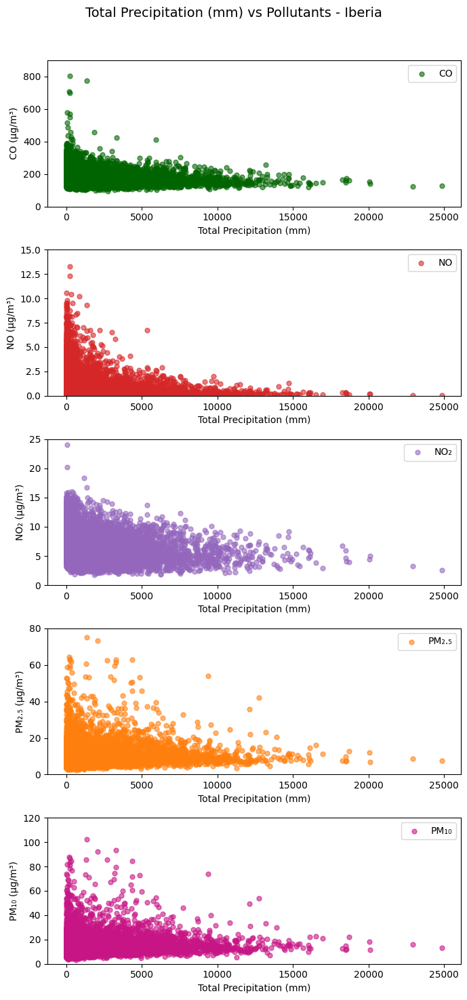


Plotting correlations for: Max Temperature (°C) (mean)


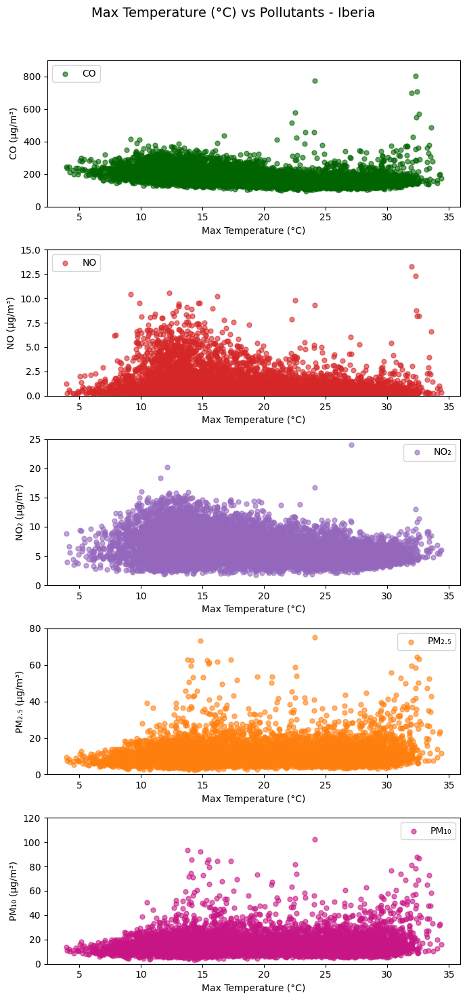


Plotting correlations for: Max Wind Speed (m/s) (mean)


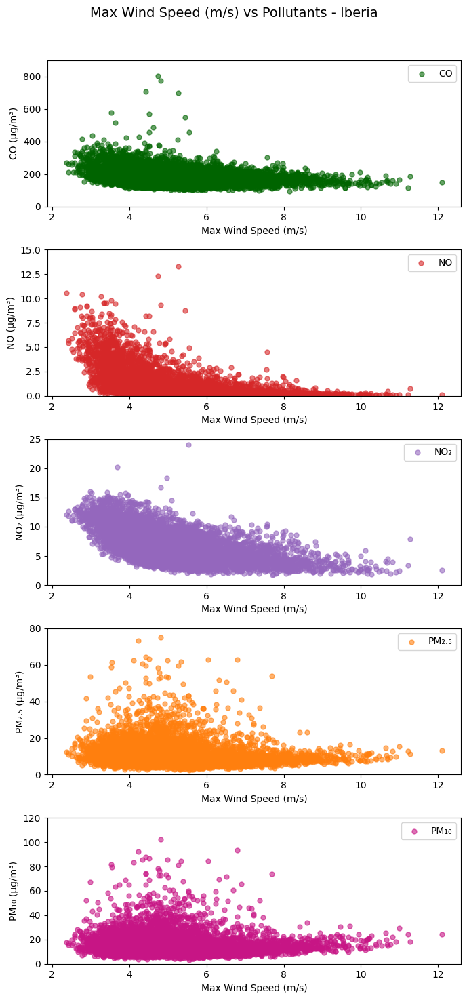

In [4]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - Iberia')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants - Iberia', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 900)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 15)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 25)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 80)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 120)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (mm) (mean)


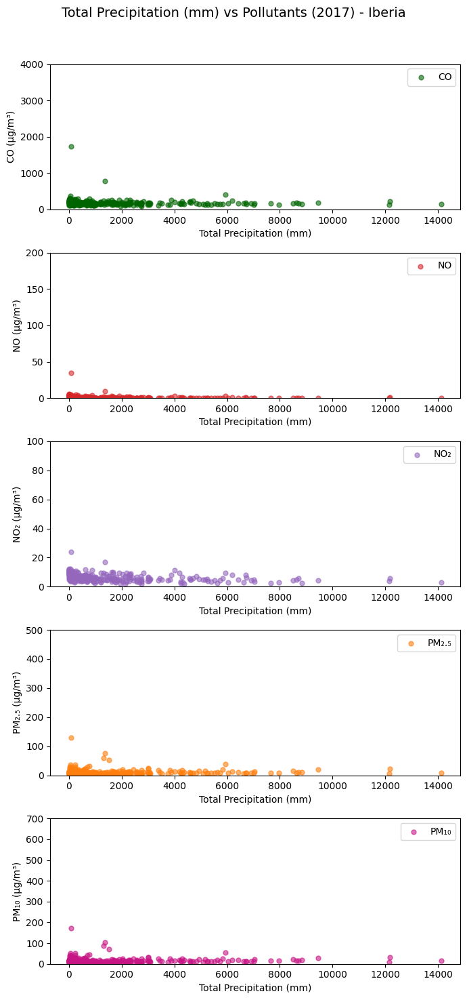


Plotting correlations for: Max Temperature (°C) (mean)


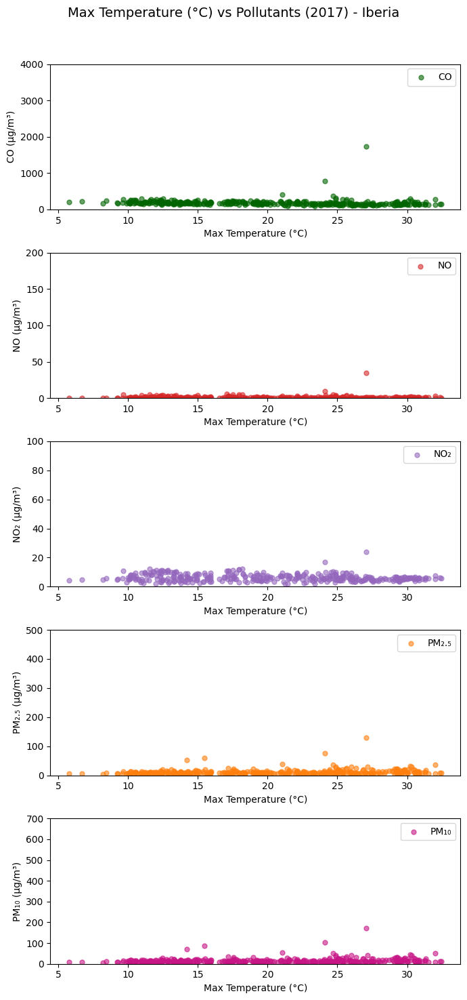


Plotting correlations for: Max Wind Speed (m/s) (mean)


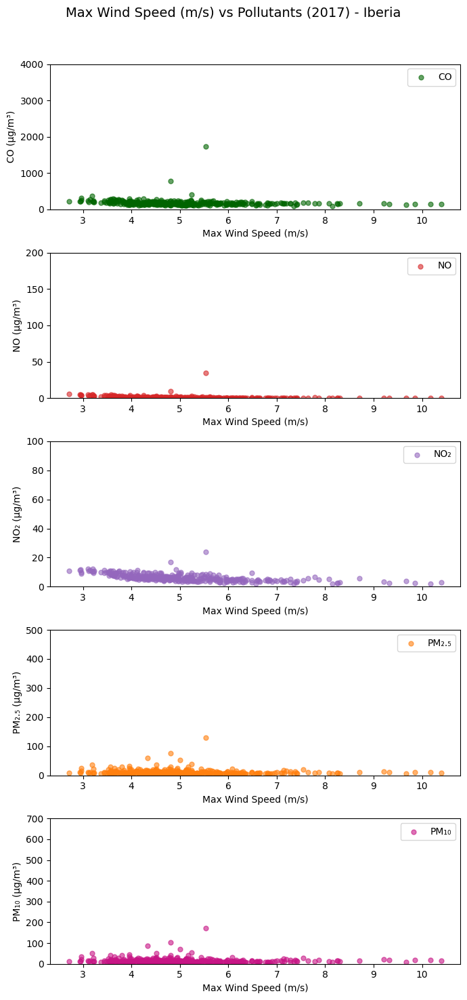

In [69]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year} - Iberia')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year}) - Iberia', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Italy

#### All Years


Plotting correlations for: Total Precipitation (mm) (mean)


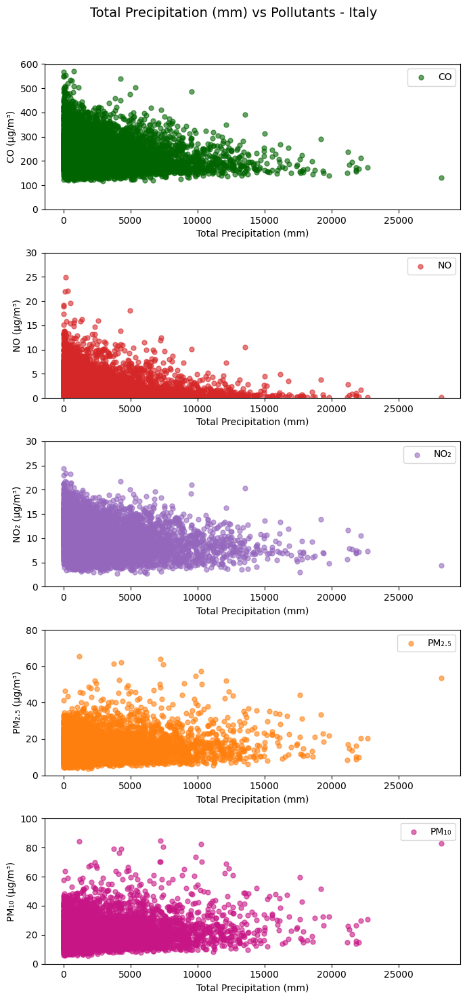


Plotting correlations for: Max Temperature (°C) (mean)


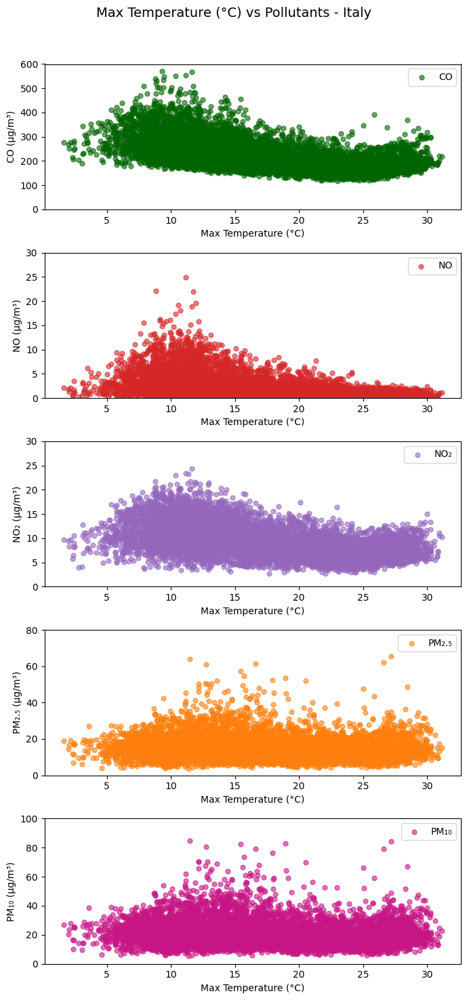


Plotting correlations for: Max Wind Speed (m/s) (mean)


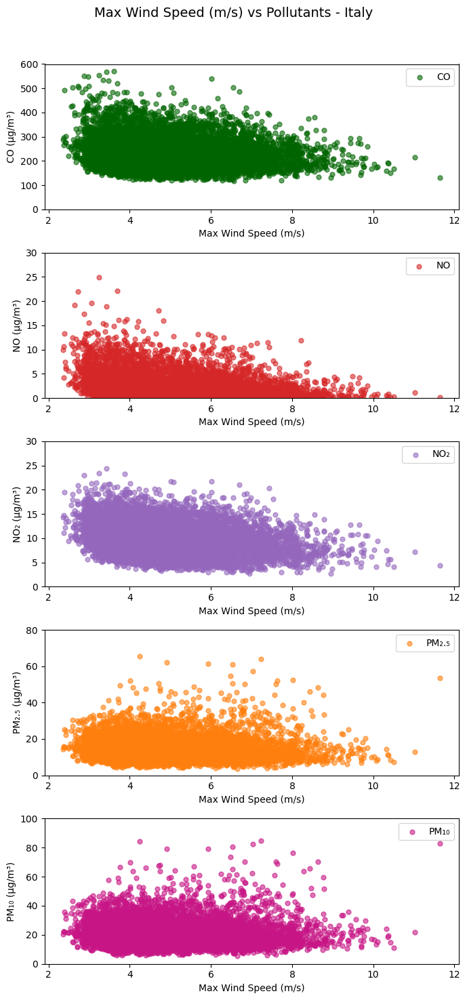

In [5]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000

    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - Italy')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants - Italy', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 600)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 30)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 30)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 80)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 100)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (mm) (mean)


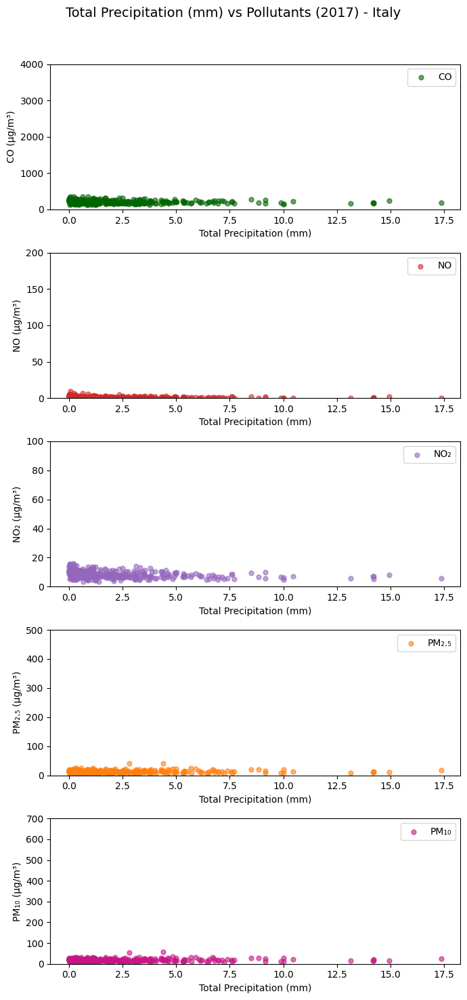


Plotting correlations for: Max Temperature (°C) (mean)


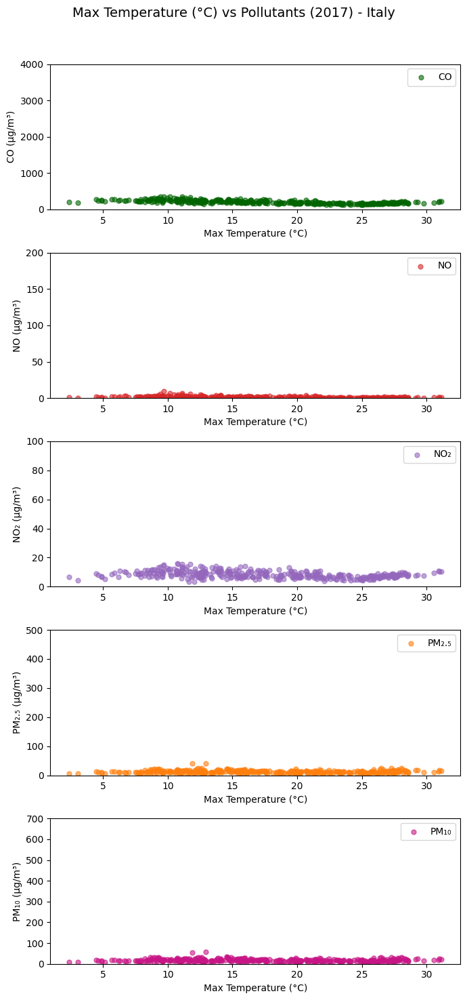


Plotting correlations for: Max Wind Speed (m/s) (mean)


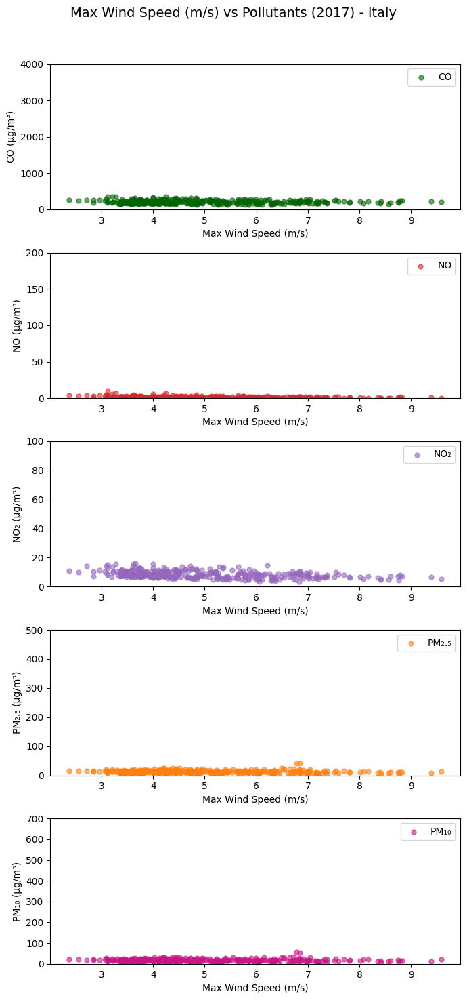

In [67]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year} - Italy')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year}) - Italy', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Greece

#### All Years


Plotting correlations for: Total Precipitation (mm) (mean)


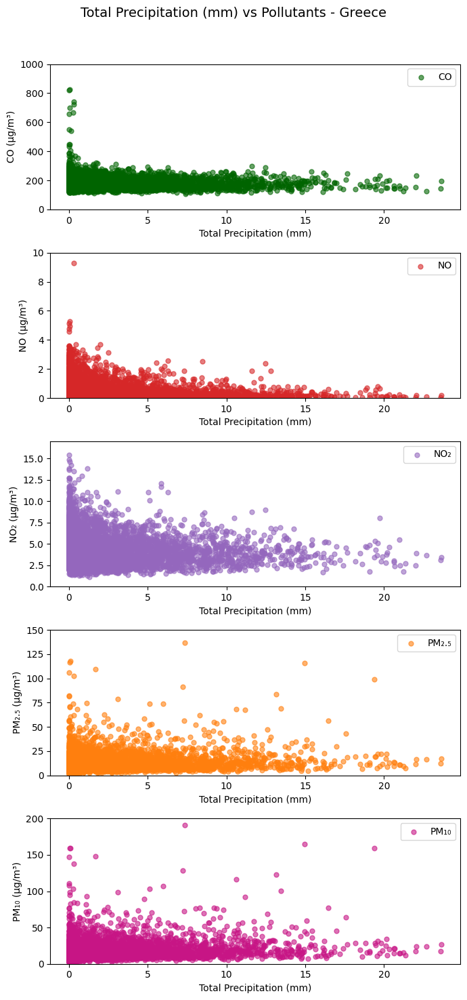


Plotting correlations for: Max Temperature (°C) (mean)


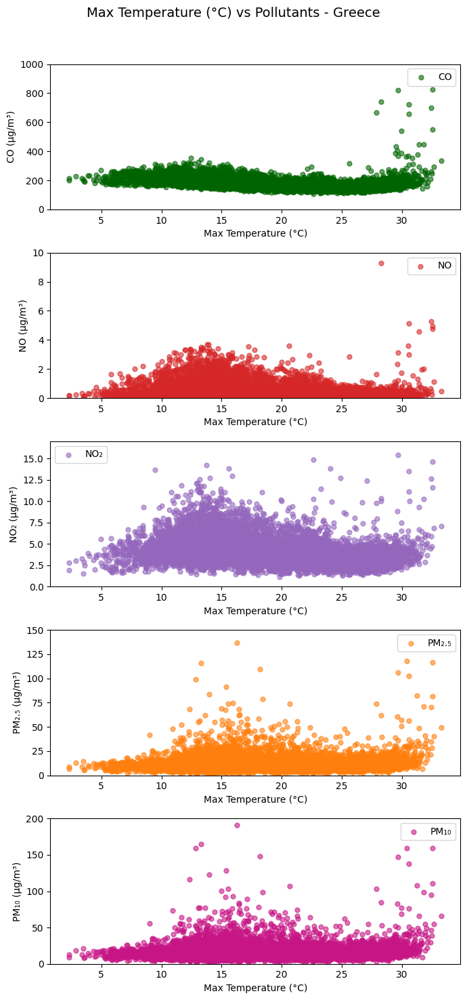


Plotting correlations for: Max Wind Speed (m/s) (mean)


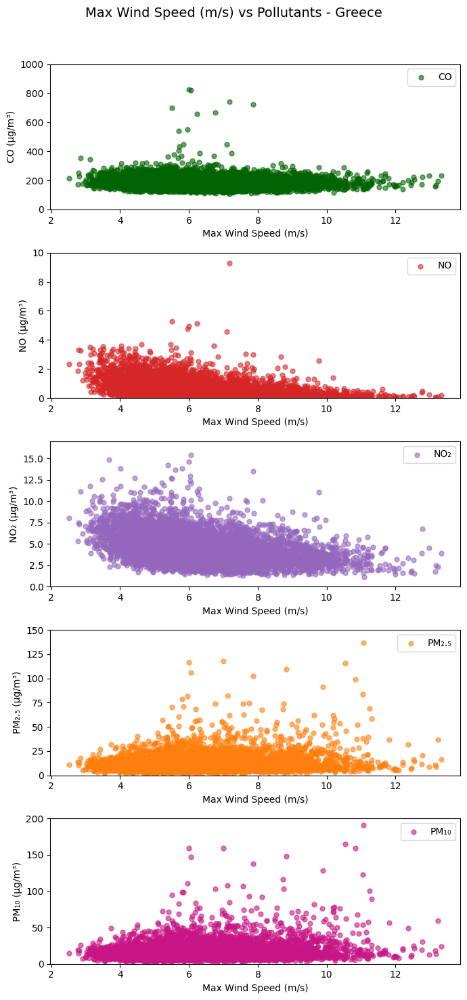

In [6]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - Greece')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants - Greece', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 1000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 10)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 17)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 150)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 200)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (mm) (mean)


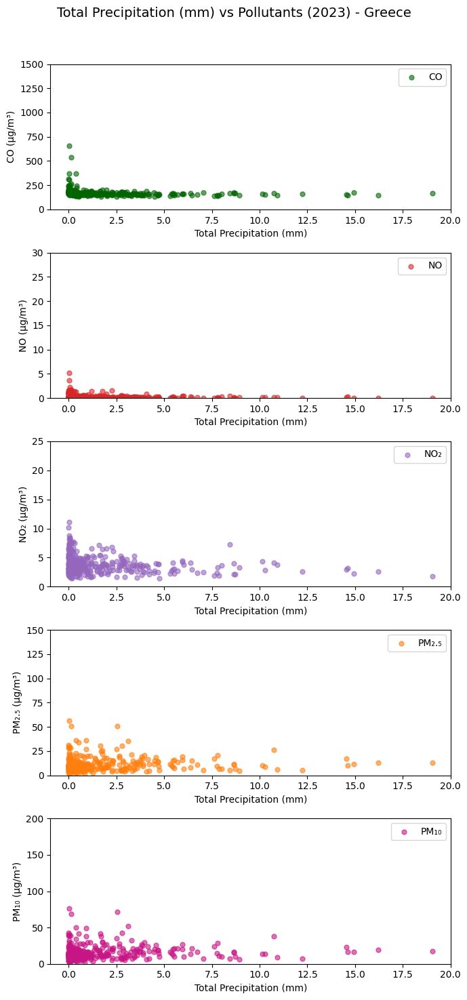


Plotting correlations for: Max Temperature (°C) (mean)


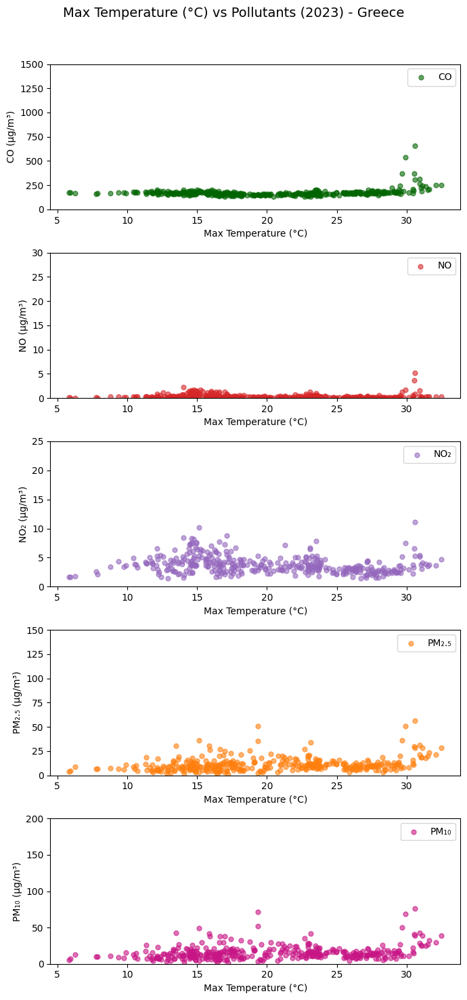


Plotting correlations for: Max Wind Speed (m/s) (mean)


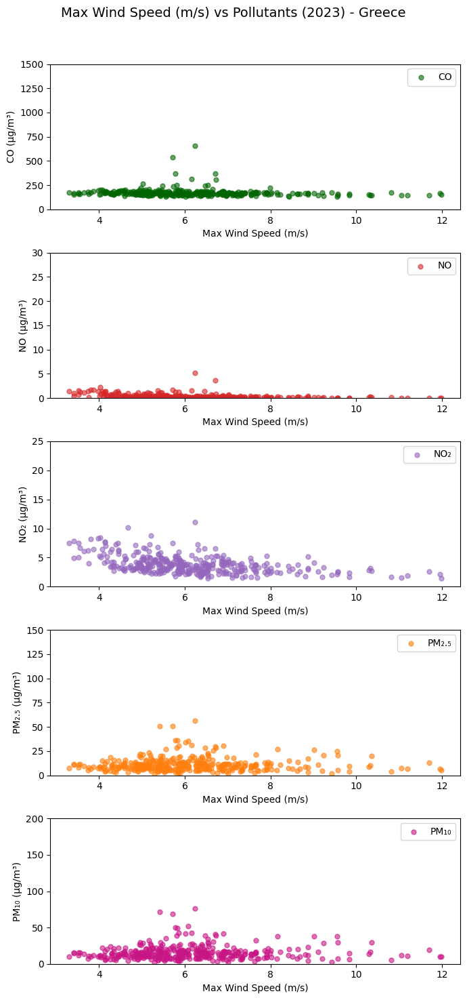

In [66]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (mm)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2023  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")
    
    # ========================================================
    # Convert precipitation from meters to millimeters
    # ========================================================
    if var_name == 'precip_Total_Precipitation':
        meteo = meteo * 1000


    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year} - Greece')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year}) - Greece', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 1500)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 30)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 25)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 150)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 200)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


## Composites and Anomalies

### Global Mean

C:\Users\sofia\AppData\Local\Temp\ipykernel_11904\95066302.py:163: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.95])


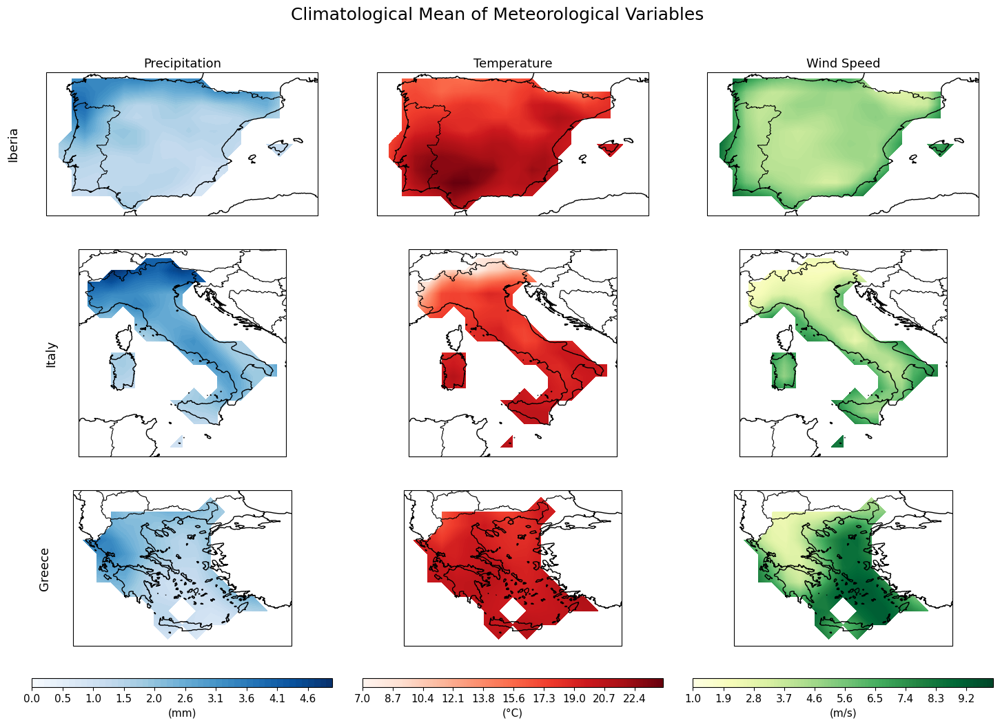

In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.ticker import FormatStrFormatter
import os

# ======================================================
# USER SETTINGS
# ======================================================

region_files = {
    "Iberia": r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    "Italy":  r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    "Greece": r"D:\IPMA\Results\co_fire_meteo_Greece.nc"
}

meteo_vars = {
    "precip_Total_Precipitation": ("mm", "Blues", "Precipitation"),
    "temp_Max": ("°C", "Reds", "Temperature"),
    "wind_Max": ("m/s", "YlGn", "Wind Speed")
}

CBAR_STEP = 1.0  # fixed step for spacing

TITLE_FONT_SIZE = 18
SUBTITLE_FONT_SIZE = 13
ROW_LABEL_FONT_SIZE = 13
CBAR_FONT_SIZE = 11

# ======================================================
# HELPER FUNCTIONS
# ======================================================

def apply_unit_conversions(ds):
    """Convert units if needed."""
    if "precip_Total_Precipitation" in ds:
        ds["precip_Total_Precipitation"] *= 1000
        ds["precip_Total_Precipitation"].attrs["units"] = "mm"
    return ds

def fixed_step_levels(data_arrays, step):
    """Compute min/max across multiple regions."""
    all_vals = np.concatenate([da.values.flatten() for da in data_arrays])
    all_vals = all_vals[np.isfinite(all_vals)]
    vmin = step * np.floor(all_vals.min() / step)
    vmax = step * np.ceil(all_vals.max() / step)
    return vmin, vmax

def data_extent(da):
    """Compute bounding box of valid data with padding."""
    mask = np.isfinite(da.values)
    if not mask.any(): return None
    lat = da.latitude.values
    lon = da.longitude.values
    iy, ix = np.where(mask)
    lat_min, lat_max = lat[iy.min()], lat[iy.max()]
    lon_min, lon_max = lon[ix.min()], lon[ix.max()]
    pad_lat = (lat_max - lat_min) * 0.05
    pad_lon = (lon_max - lon_min) * 0.05
    return [lon_min - pad_lon, lon_max + pad_lon, lat_min - pad_lat, lat_max + pad_lat]

# ======================================================
# PART 1 — COMPUTE CLIMATOLOGIES
# ======================================================

climatologies = {}
for region, file in region_files.items():
    if not os.path.exists(file):
        raise FileNotFoundError(f"File not found: {file}")
    ds = xr.open_dataset(file)
    ds = apply_unit_conversions(ds)
    climatologies[region] = {var: ds[var].mean(dim="time") for var in meteo_vars}

regions = list(region_files.keys())
variables = list(meteo_vars.keys())

# ======================================================
# PART 2 — MULTI-PANEL FIGURE (ITALY TALLER)
# ======================================================

nrows = len(regions)
ncols = len(variables)

# Set Italy row taller: height_ratios = [Iberia, Italy, Greece]
height_ratios = [1.1, 1.6, 1.2]  # adjust 2 → bigger Italy

fig = plt.figure(figsize=(6 * ncols, 4 * nrows))
gs = gridspec.GridSpec(nrows, ncols, figure=fig, hspace=0.2, wspace=0.1,
                       bottom=0.1, height_ratios=height_ratios)

mappables = {}
axes_array = np.empty((nrows, ncols), dtype=object)

for col, var_name in enumerate(variables):
    unit, cmap, display_name = meteo_vars[var_name]
    das = [climatologies[r][var_name] for r in regions]
    
    # Compute min/max across regions
    vmin, vmax = fixed_step_levels(das, CBAR_STEP)
    
    # Smooth gradient: increase levels
    n_levels = int((vmax - vmin) / CBAR_STEP * 10)  # 10x more levels
    levels = np.linspace(vmin, vmax, n_levels)

    for row, region in enumerate(regions):
        ax = fig.add_subplot(gs[row, col], projection=ccrs.PlateCarree())
        axes_array[row, col] = ax
        da = climatologies[region][var_name]

        lons, lats = np.meshgrid(da.longitude, da.latitude)
        cf = ax.contourf(
            lons, lats, da.values,
            levels=levels,
            cmap=cmap,
            transform=ccrs.PlateCarree()
        )

        extent = data_extent(da)
        if extent:
            ax.set_extent(extent)

        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linewidth=0.8)

        # Column titles
        if row == 0:
            ax.set_title(display_name, fontsize=SUBTITLE_FONT_SIZE)

        # Row labels
        if col == 0:
            ax.text(-0.10, 0.5, region,
                    va="center", ha="right", rotation=90,
                    transform=ax.transAxes, fontsize=ROW_LABEL_FONT_SIZE)

        # Store first row cf for colorbar
        if row == 0:
            mappables[col] = cf

# ======================================================
# PART 3 — COLORBARS ALIGNED BELOW EACH COLUMN
# ======================================================

for col, var_name in enumerate(variables):
    cbar = fig.colorbar(
        mappables[col],
        ax=axes_array[:, col].tolist(),  # align with all rows in column
        orientation='horizontal',
        fraction=0.06,  # slightly taller
        pad=0.05,       # closer to maps
        aspect=35
    )
    unit = meteo_vars[var_name][0]
    cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
    cbar.ax.xaxis.set_major_formatter(FormatStrFormatter("%.1f"))
    cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

fig.suptitle("Climatological Mean of Meteorological Variables",
             fontsize=TITLE_FONT_SIZE, y=0.96)

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_11904\431115245.py:166: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.08, 1, 0.95])


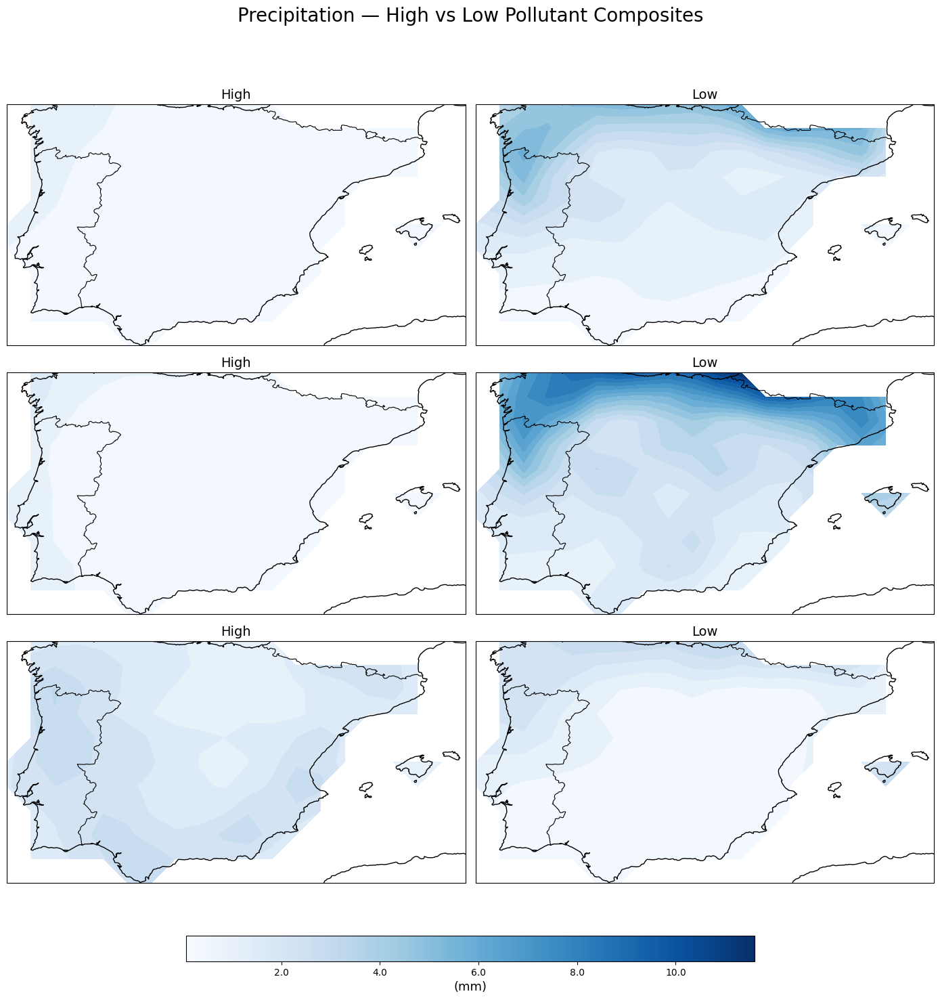

C:\Users\sofia\AppData\Local\Temp\ipykernel_11904\431115245.py:166: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.08, 1, 0.95])


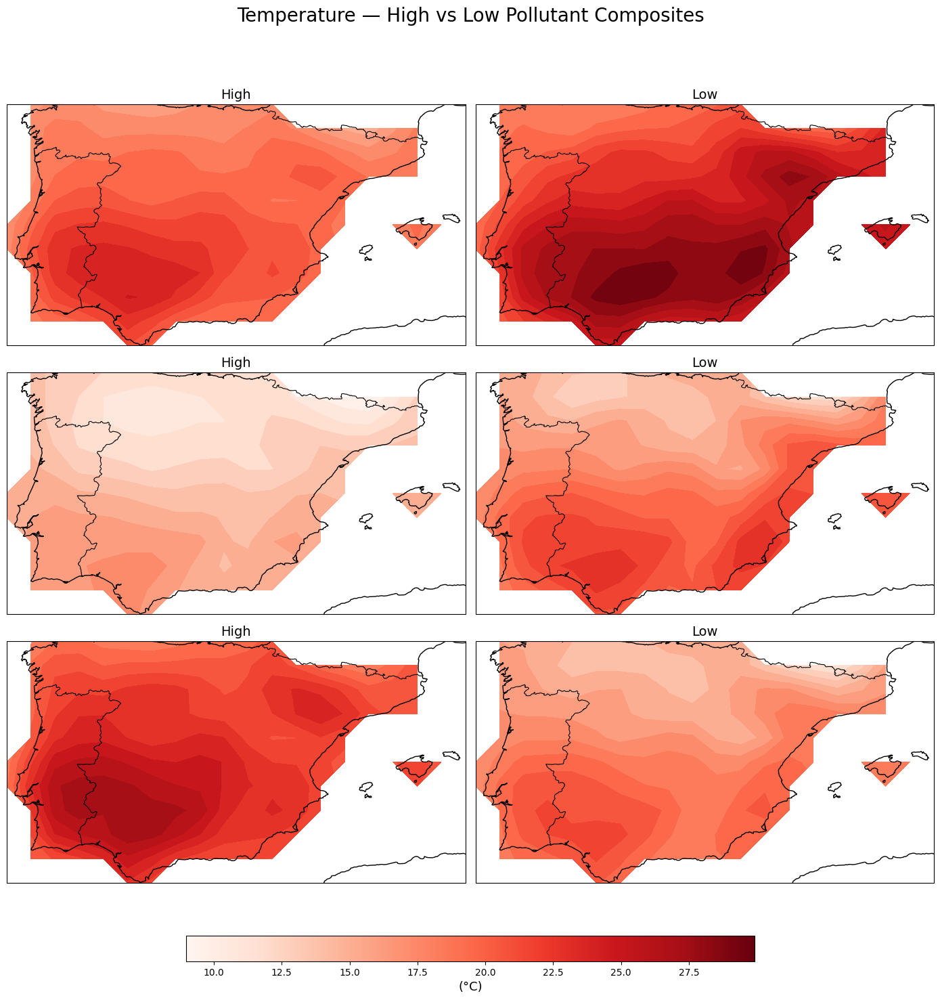

C:\Users\sofia\AppData\Local\Temp\ipykernel_11904\431115245.py:166: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.08, 1, 0.95])


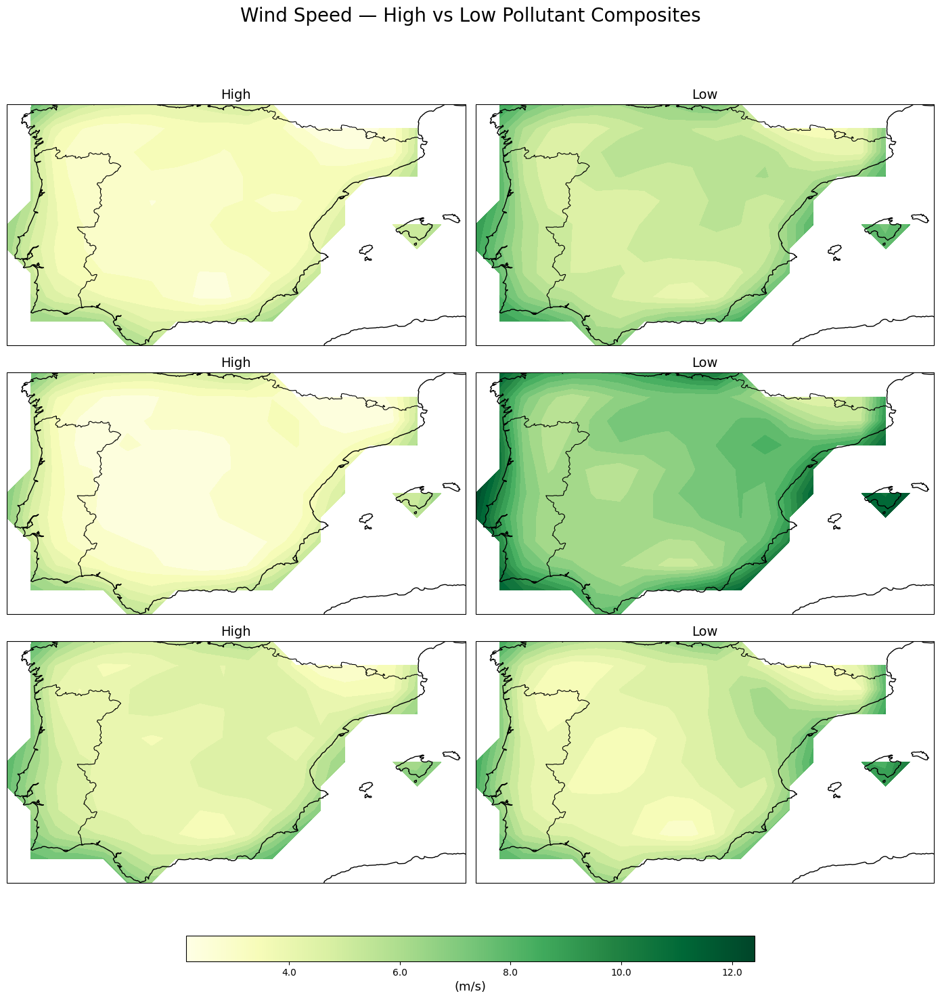

In [4]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import os
import matplotlib.colors as colors
import matplotlib.cm as cm
from matplotlib.ticker import FormatStrFormatter
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# ------------------------------
# USER INPUTS
# ------------------------------

pollutant_files = {
    'CO':    r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO2':   r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM2.5': r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc"
}

meteo_vars = {
    "precip_Total_Precipitation": ("mm", "Blues"),
    "temp_Max": ("°C", "Reds"),
    "wind_Max": ("m/s", "YlGn")
}

meteo_var_names = {
    "precip_Total_Precipitation": "Precipitation",
    "temp_Max": "Temperature",
    "wind_Max": "Wind Speed"
}

# ------------------------------
# HELPER FUNCTIONS
# ------------------------------

def apply_unit_conversions(ds, pollutant_name):
    if pollutant_name == 'CO' and 'Mean' in ds:
        ds['Mean'] = ds['Mean'] * 1000
        ds['Mean'].attrs['units'] = 'µg/m3'

    if "precip_Total_Precipitation" in ds:
        ds["precip_Total_Precipitation"] *= 1000
        ds["precip_Total_Precipitation"].attrs['units'] = 'mm'

    return ds


def calculate_dynamic_extent(da):
    mask = np.isfinite(da.values)
    if not mask.any():
        return None

    lat = da.latitude.values
    lon = da.longitude.values
    idx = np.where(mask)

    lat_min, lat_max = lat[idx[0]].min(), lat[idx[0]].max()
    lon_min, lon_max = lon[idx[1]].min(), lon[idx[1]].max()

    return [lon_min, lon_max, lat_min, lat_max]

# ------------------------------
# PART 1 — GLOBAL MEAN (COMPUTED ONLY)
# ------------------------------

reference_ds = xr.open_dataset(list(pollutant_files.values())[0])
global_means = {
    var: reference_ds[var].mean("time")
    for var in meteo_vars
}

# ------------------------------
# PART 2 — COMPOSITES
# ------------------------------

all_results = {}

for pollutant, file in pollutant_files.items():
    ds = apply_unit_conversions(xr.open_dataset(file), pollutant)

    N_days = max(1, int(np.ceil(0.01 * len(ds.time))))

    ts = ds['Mean'].mean(dim=['latitude', 'longitude'])
    ranked = ts.to_series().sort_values(ascending=False)

    high_days = ranked.index[:N_days]
    low_days  = ranked.index[-N_days:]

    all_results[pollutant] = {}

    for var in meteo_vars:
        all_results[pollutant][var] = {
            "High": ds[var].sel(time=high_days).mean("time"),
            "Low":  ds[var].sel(time=low_days).mean("time")
        }

# ------------------------------
# PART 3 — PLOTTING
# ------------------------------

TITLE_FONT = 20
SUB_FONT = 14
CBAR_FONT = 13
NUM_LEVELS = 20

for var, (unit, cmap) in meteo_vars.items():

    fig, axes = plt.subplots(
        nrows=3, ncols=2,
        figsize=(14, 15),
        subplot_kw={'projection': ccrs.PlateCarree()}
    )

    fig.suptitle(
        f"{meteo_var_names[var]} — High vs Low Pollutant Composites",
        fontsize=TITLE_FONT
    )

    # Shared color scale
    vals = []
    for p in pollutant_files:
        vals.append(all_results[p][var]["High"].values)
        vals.append(all_results[p][var]["Low"].values)

    vmin, vmax = np.nanmin(vals), np.nanmax(vals)
    levels = np.linspace(vmin, vmax, NUM_LEVELS)

    extent = calculate_dynamic_extent(all_results['CO'][var]["High"])

    for i, pollutant in enumerate(pollutant_files):

        for j, comp in enumerate(["High", "Low"]):
            ax = axes[i, j]
            da = all_results[pollutant][var][comp]

            lons, lats = np.meshgrid(da.longitude, da.latitude)

            im = ax.contourf(
                lons, lats, da,
                levels=levels,
                cmap=cmap,
                extend='both',
                transform=ccrs.PlateCarree()
            )

            ax.set_extent(extent)
            ax.coastlines()
            ax.add_feature(cfeature.BORDERS, linewidth=0.8)

            if j == 0:
                ax.set_ylabel(pollutant, fontsize=SUB_FONT)

            ax.set_title(f"{comp}", fontsize=SUB_FONT)

    # ---- Dedicated colorbar axis (fixes overlap) ----
    cax = fig.add_axes([0.2, 0.04, 0.6, 0.025])
    cbar = fig.colorbar(
        cm.ScalarMappable(norm=colors.Normalize(vmin=vmin, vmax=vmax), cmap=cmap),
        cax=cax,
        orientation='horizontal'
    )
    cbar.set_label(f"({unit})", fontsize=CBAR_FONT)
    cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))

    plt.tight_layout(rect=[0, 0.08, 1, 0.95])
    plt.show()


### Composites and Anomalies

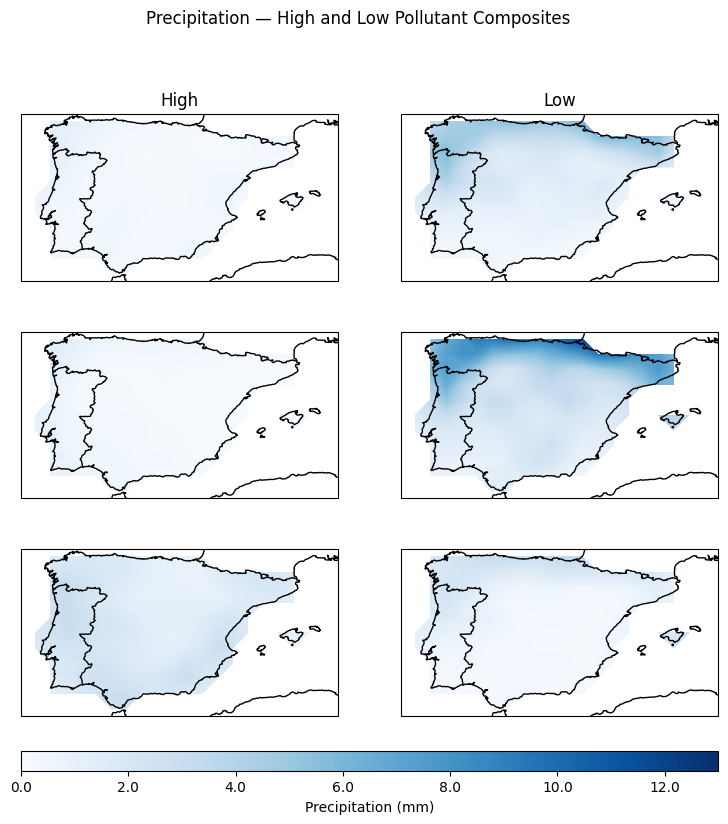

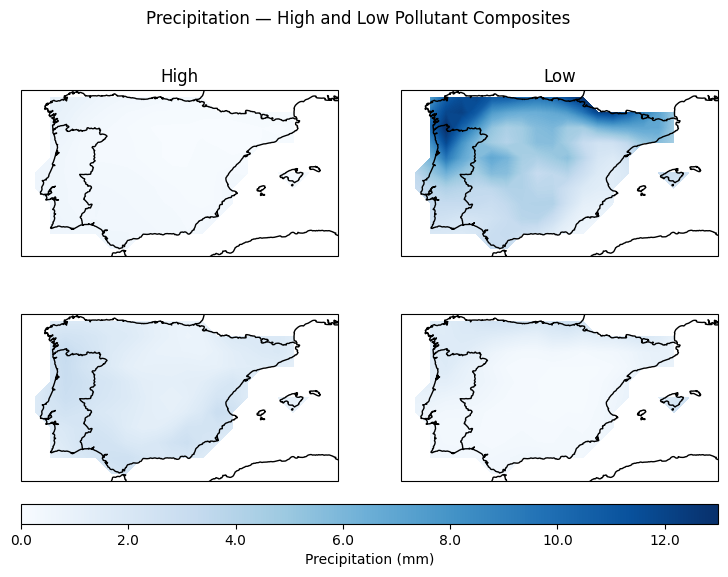

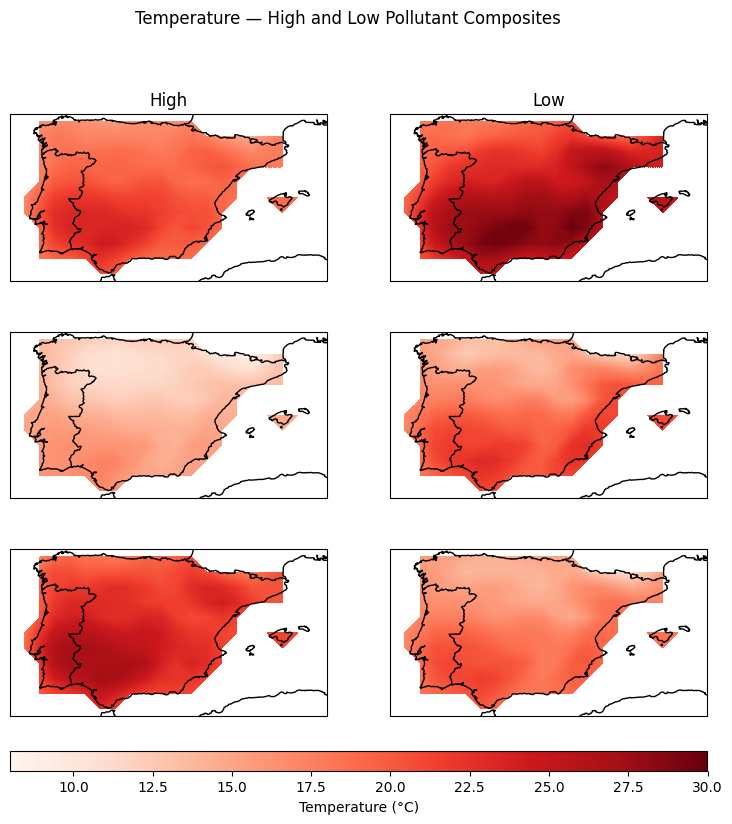

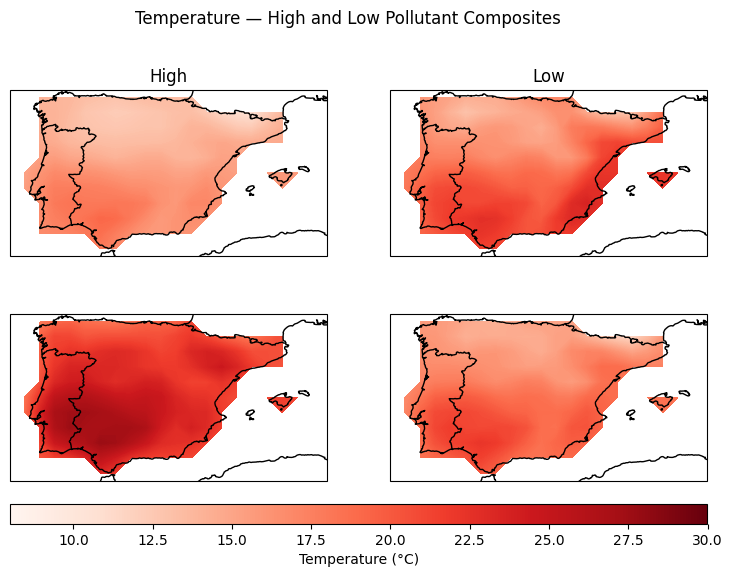

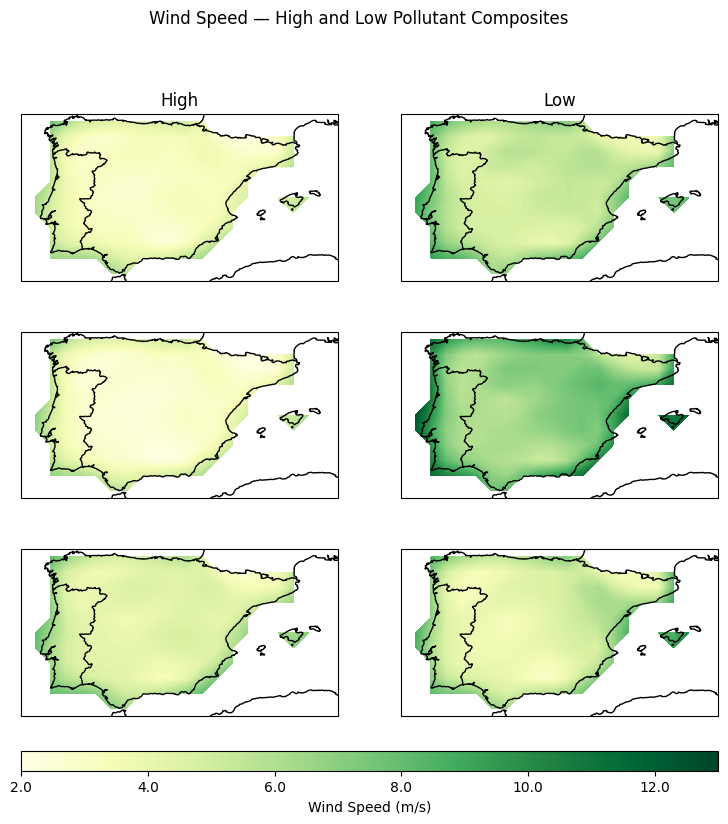

...

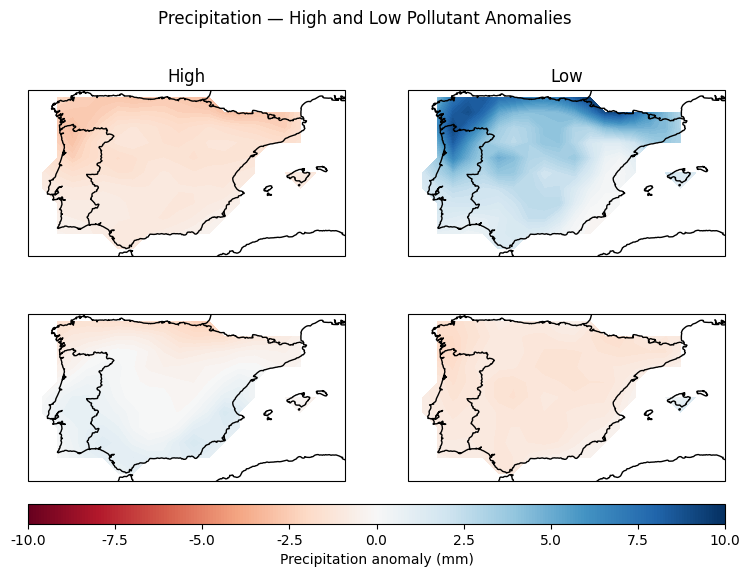

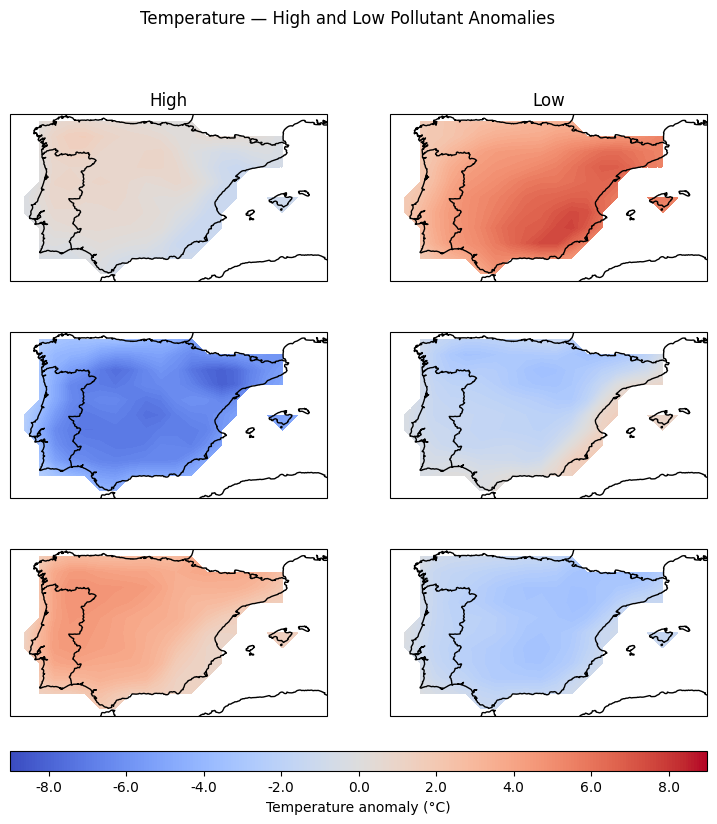

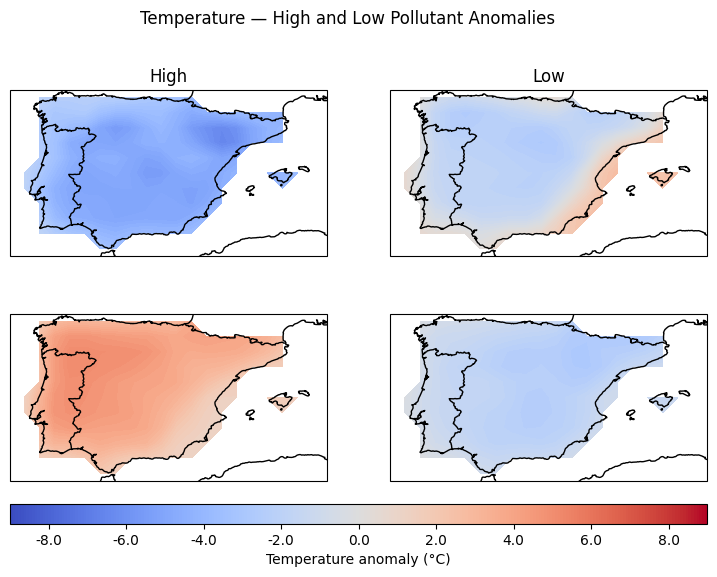

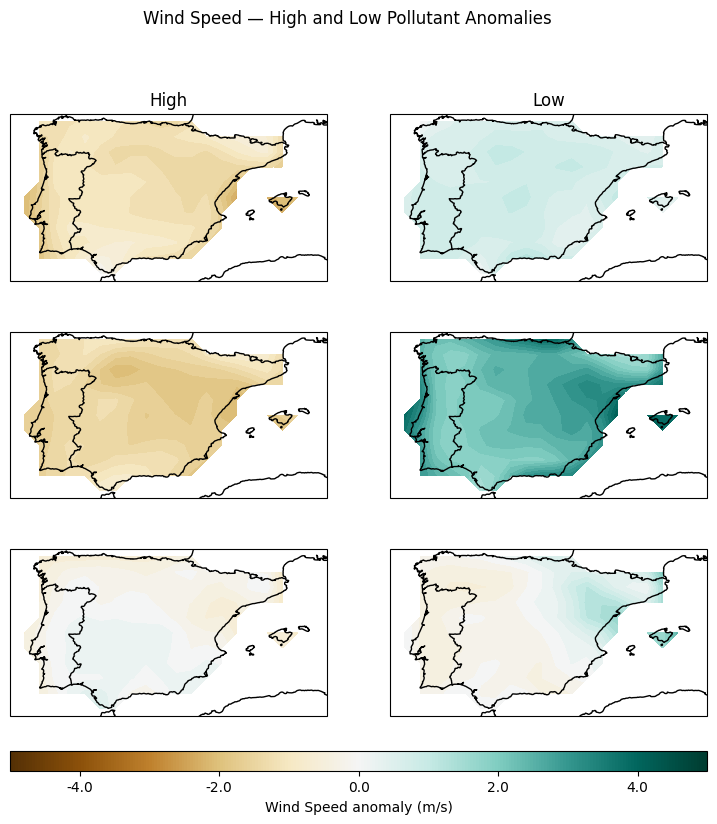

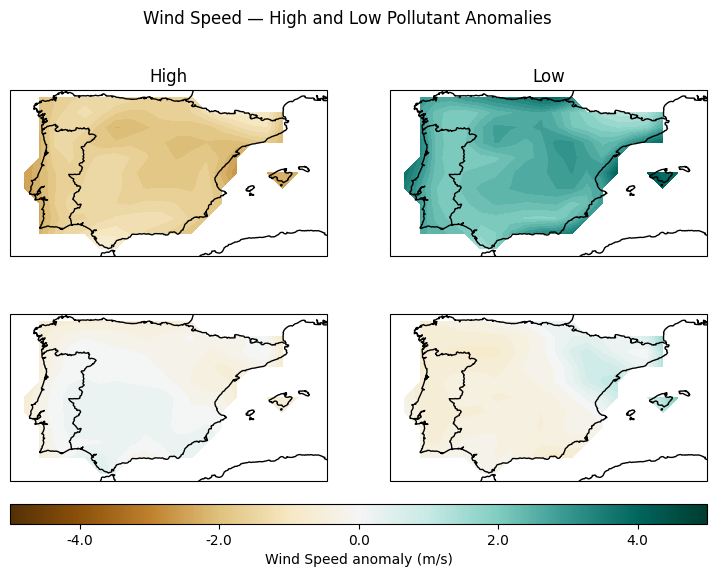

✔ Colorbar levels & spacing now MATCH reference script.


In [19]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import os
import matplotlib.colors as colors
import matplotlib.cm as cm
from matplotlib.ticker import FormatStrFormatter
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# ------------------------------
# USER INPUTS
# ------------------------------

pollutant_files = {
    'CO':    r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':    r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO2':   r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM2.5': r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM10':  r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

meteo_vars = {
    "precip_Total_Precipitation": ("mm", "Blues"),
    "temp_Max": ("°C", "Reds"),
    "wind_Max": ("m/s", "YlGn")
}

meteo_var_names = {
    "precip_Total_Precipitation": "Precipitation",
    "temp_Max": "Temperature",
    "wind_Max": "Wind Speed"
}

anomaly_cmaps = {
    "precip_Total_Precipitation": "RdBu",
    "temp_Max": "coolwarm",
    "wind_Max": "BrBG"
}

pollutant_groups = {
    "Group 1": ["CO", "NO2", "PM2.5"],
    "Group 2": ["NO", "PM10"]
}

# 🔑 MATCH REFERENCE SETTINGS
CBAR_STEP = 1.0
LEVELS_PER_STEP = 10

NUM_LEVELS_MIN = 20  # safety floor

# ------------------------------
# HELPER FUNCTIONS
# ------------------------------

def apply_unit_conversions(ds, pollutant):
    if pollutant == "CO" and "Mean" in ds:
        ds["Mean"] = ds["Mean"] * 1000
        ds["Mean"].attrs["units"] = "µg/m3"
    if "precip_Total_Precipitation" in ds:
        ds["precip_Total_Precipitation"] *= 1000
        ds["precip_Total_Precipitation"].attrs["units"] = "mm"
    return ds


def get_valid_data_extent(data_arrays, pad_frac=0.05):
    lats, lons = [], []
    for da in data_arrays:
        mask = np.isfinite(da.values)
        if not mask.any():
            continue
        lat = da.latitude.values
        lon = da.longitude.values
        iy, ix = np.where(mask)
        lats.append(lat[iy])
        lons.append(lon[ix])
    if not lats:
        return None
    lat_min, lat_max = np.min(np.concatenate(lats)), np.max(np.concatenate(lats))
    lon_min, lon_max = np.min(np.concatenate(lons)), np.max(np.concatenate(lons))
    pad_lat = (lat_max - lat_min) * pad_frac
    pad_lon = (lon_max - lon_min) * pad_frac
    return [lon_min - pad_lon, lon_max + pad_lon,
            lat_min - pad_lat, lat_max + pad_lat]


def fixed_step_levels(data_arrays, step):
    vals = np.concatenate([da.values.ravel() for da in data_arrays])
    vals = vals[np.isfinite(vals)]
    vmin = step * np.floor(vals.min() / step)
    vmax = step * np.ceil(vals.max() / step)
    n_levels = max(int((vmax - vmin) / step * LEVELS_PER_STEP), NUM_LEVELS_MIN)
    return vmin, vmax, np.linspace(vmin, vmax, n_levels)

# ------------------------------
# PART 1 — COMPOSITES & ANOMALIES
# ------------------------------

all_composite_results = {}

for pollutant, file in pollutant_files.items():
    ds = xr.open_dataset(file)
    ds = apply_unit_conversions(ds, pollutant)

    N = max(1, int(0.01 * len(ds.time)))
    ts = ds["Mean"].mean(dim=["latitude", "longitude"])
    ranked = ts.to_series().sort_values(ascending=False)

    high_days = ranked.index[:N]
    low_days  = ranked.index[-N:]

    composite_results = {}

    for var, (unit, cmap) in meteo_vars.items():
        high = ds[var].sel(time=high_days).mean(dim="time")
        low  = ds[var].sel(time=low_days).mean(dim="time")
        clim = ds[var].mean(dim="time")

        composite_results[var] = {
            "High_Comp": high,
            "Low_Comp": low,
            "High_Anomaly": high - clim,
            "Low_Anomaly": low - clim,
            "unit": unit,
            "cmap": cmap
        }

    all_composite_results[pollutant] = composite_results

# ------------------------------
# PART 2 — RAW COMPOSITES
# ------------------------------

for var in meteo_vars:
    unit, cmap = meteo_vars[var]
    name = meteo_var_names[var]

    all_fields = []
    for p in all_composite_results:
        all_fields.extend([
            all_composite_results[p][var]["High_Comp"],
            all_composite_results[p][var]["Low_Comp"]
        ])

    vmin, vmax, levels = fixed_step_levels(all_fields, CBAR_STEP)

    for group, pollutants in pollutant_groups.items():

        extent_fields = []
        for p in pollutants:
            extent_fields.extend([
                all_composite_results[p][var]["High_Comp"],
                all_composite_results[p][var]["Low_Comp"]
            ])
        zoom_extent = get_valid_data_extent(extent_fields)

        fig, axes = plt.subplots(
            len(pollutants), 2,
            figsize=(9, 3 * len(pollutants)),
            subplot_kw={"projection": ccrs.PlateCarree()},
            squeeze=False
        )

        for i, p in enumerate(pollutants):
            res = all_composite_results[p][var]
            for j, (label, field) in enumerate([
                ("High", res["High_Comp"]),
                ("Low",  res["Low_Comp"])
            ]):
                ax = axes[i, j]
                lons, lats = np.meshgrid(field.longitude, field.latitude)
                ax.contourf(
                    lons, lats, field,
                    levels=levels,
                    cmap=cmap,
                    transform=ccrs.PlateCarree()
                )
                if i == 0: ax.set_title(label)
                if j == 0: ax.set_ylabel(p)
                if zoom_extent:
                    ax.set_extent(zoom_extent, crs=ccrs.PlateCarree())
                ax.coastlines()
                ax.add_feature(cfeature.BORDERS)

        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin, vmax), cmap=cmap),
            ax=axes,
            orientation="horizontal",
            fraction=0.06,
            pad=0.05,
            aspect=35
        )
        cbar.set_label(f"{name} ({unit})")
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter("%.1f"))

        fig.suptitle(f"{name} — High and Low Pollutant Composites")
        plt.show()

# ------------------------------
# PART 3 — ANOMALIES
# ------------------------------

for var in meteo_vars:
    unit = meteo_vars[var][0]
    cmap = anomaly_cmaps[var]
    name = meteo_var_names[var]

    all_fields = []
    for p in all_composite_results:
        all_fields.extend([
            all_composite_results[p][var]["High_Anomaly"],
            all_composite_results[p][var]["Low_Anomaly"]
        ])

    vmax = max(abs(fixed_step_levels(all_fields, CBAR_STEP)[1]),
               abs(fixed_step_levels(all_fields, CBAR_STEP)[0]))
    vmin = -vmax
    levels = np.linspace(vmin, vmax, LEVELS_PER_STEP * int(vmax / CBAR_STEP))

    for group, pollutants in pollutant_groups.items():

        extent_fields = []
        for p in pollutants:
            extent_fields.extend([
                all_composite_results[p][var]["High_Anomaly"],
                all_composite_results[p][var]["Low_Anomaly"]
            ])
        zoom_extent = get_valid_data_extent(extent_fields)

        fig, axes = plt.subplots(
            len(pollutants), 2,
            figsize=(9, 3 * len(pollutants)),
            subplot_kw={"projection": ccrs.PlateCarree()},
            squeeze=False
        )

        for i, p in enumerate(pollutants):
            res = all_composite_results[p][var]
            for j, (label, field) in enumerate([
                ("High", res["High_Anomaly"]),
                ("Low",  res["Low_Anomaly"])
            ]):
                ax = axes[i, j]
                lons, lats = np.meshgrid(field.longitude, field.latitude)
                ax.contourf(
                    lons, lats, field,
                    levels=levels,
                    cmap=cmap,
                    transform=ccrs.PlateCarree()
                )
                if i == 0: ax.set_title(label)
                if j == 0: ax.set_ylabel(p)
                if zoom_extent:
                    ax.set_extent(zoom_extent, crs=ccrs.PlateCarree())
                ax.coastlines()
                ax.add_feature(cfeature.BORDERS)

        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin, vmax), cmap=cmap),
            ax=axes,
            orientation="horizontal",
            fraction=0.06,
            pad=0.05,
            aspect=35
        )
        cbar.set_label(f"{name} anomaly ({unit})")
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter("%.1f"))

        fig.suptitle(f"{name} — High and Low Pollutant Anomalies")
        plt.show()

print("✔ Colorbar levels & spacing now MATCH reference script.")


### Old Way but correct

#### Iberia

--- Part 1: Calculating & Saving Global Mean (Climatology) ---
Global Mean data successfully saved to D:\IPMA\Results\global_mean_meteo_Iberia.nc.

--- Part 2: Compositing Analysis and Saving Composites ---

[CO] Selecting 81 days

[CO] Pollutant concentration ranges (N=81)
  High days: min = 326.85, max = 1739.84 (unknown)
  Low  days: min = 96.12, max = 113.50 (unknown)

[NO] Selecting 81 days

[NO] Pollutant concentration ranges (N=81)
  High days: min = 6.47, max = 34.60 (unknown)
  Low  days: min = 0.05, max = 0.09 (unknown)

[NO2] Selecting 81 days

[NO2] Pollutant concentration ranges (N=81)
  High days: min = 13.87, max = 24.08 (unknown)
  Low  days: min = 1.76, max = 2.52 (unknown)

[PM2.5] Selecting 81 days

[PM2.5] Pollutant concentration ranges (N=81)
  High days: min = 36.03, max = 128.79 (unknown)
  Low  days: min = 2.22, max = 3.94 (unknown)

[PM10] Selecting 81 days

[PM10] Pollutant concentration ranges (N=81)
  High days: min = 49.74, max = 172.57 (unknown)
  Low  day

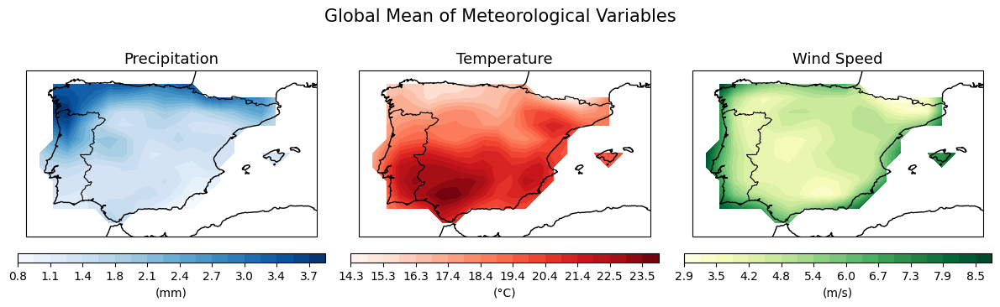

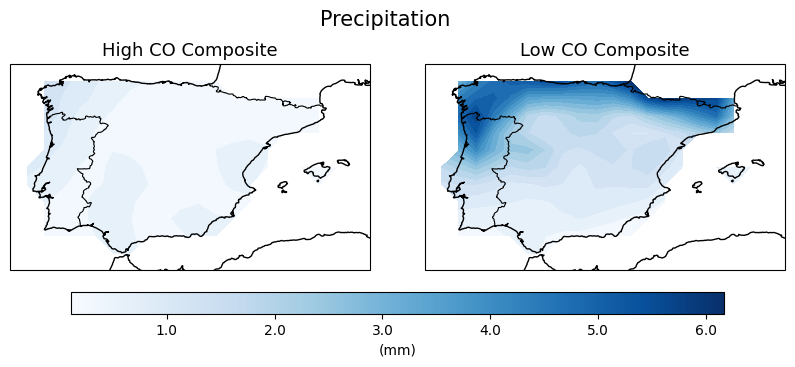

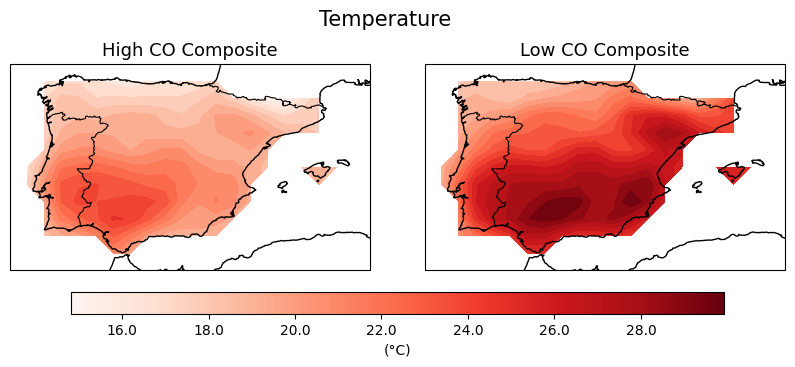

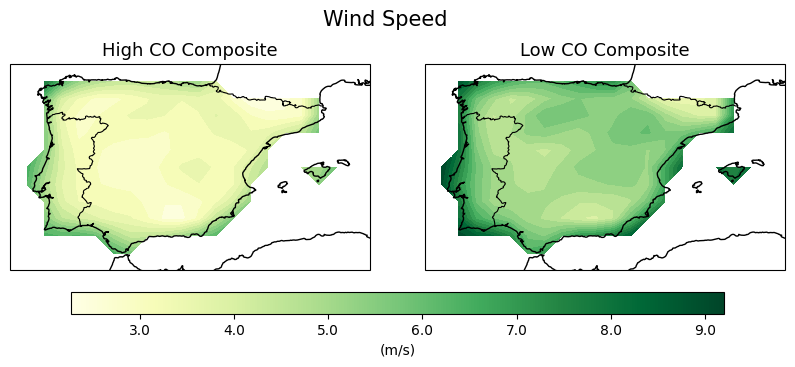

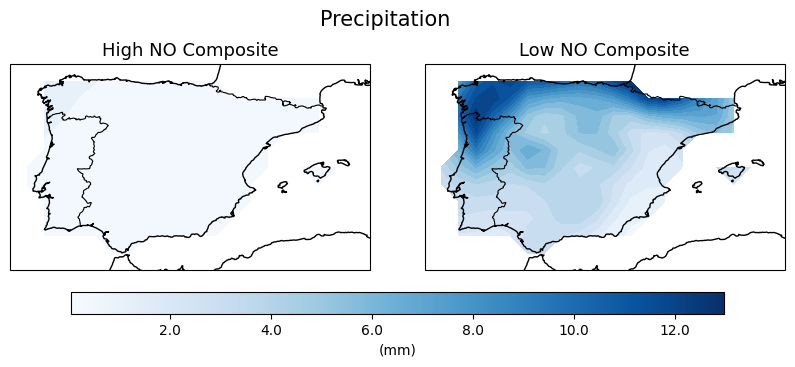

...

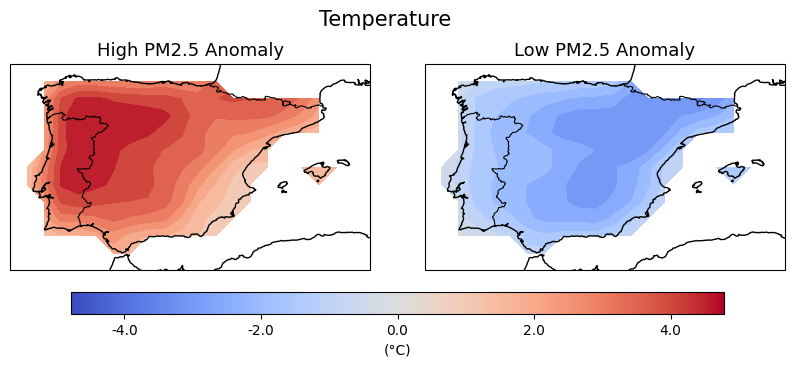

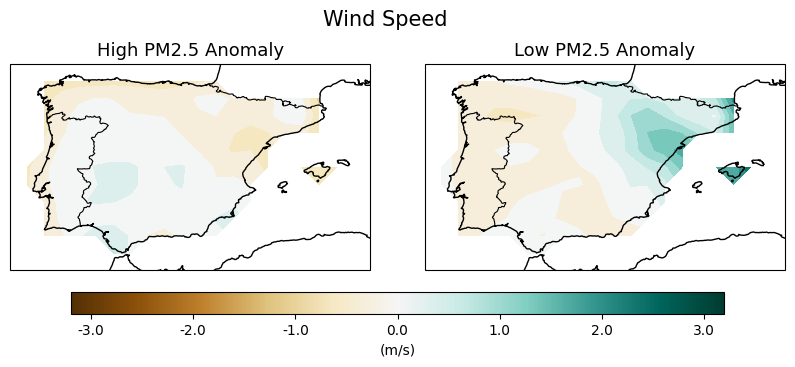

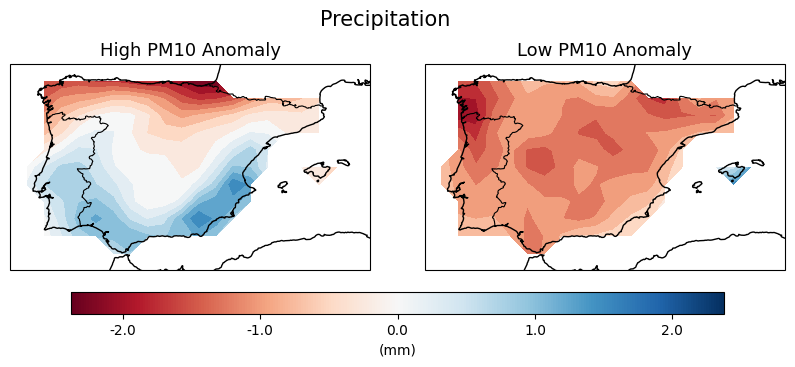

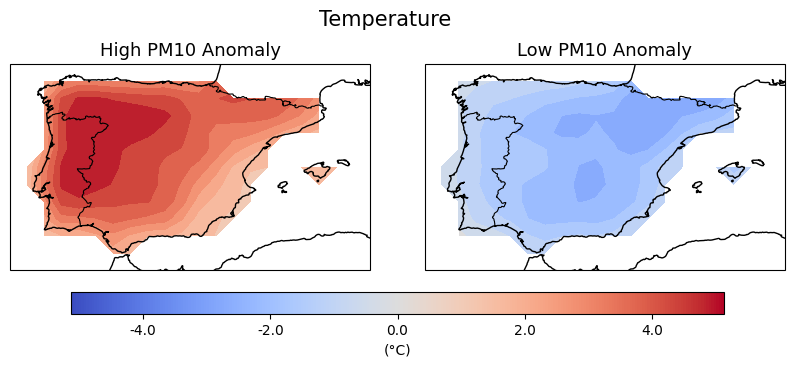

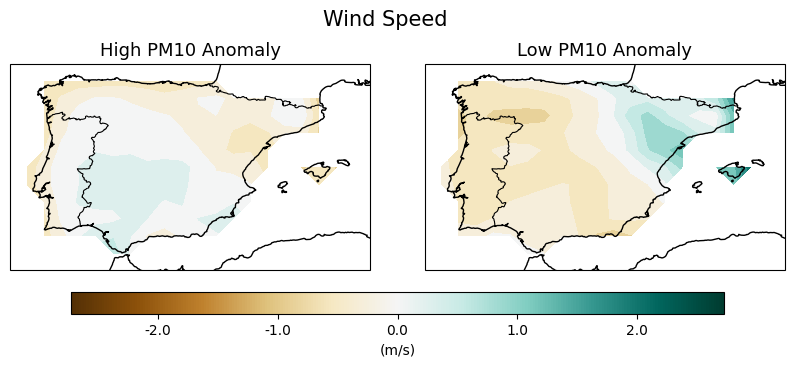


Code execution finished. Composites and Anomalies now plotted without difference fields.


In [7]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import matplotlib.colors as colors
import matplotlib.cm as cm
from matplotlib.ticker import FormatStrFormatter, MaxNLocator
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.colors as mcolors

# ------------------------------
# USER INPUTS
# ------------------------------

pollutant_files = {
    'CO':    r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':    r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO2':   r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM2.5': r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM10':  r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

meteo_vars = {
    "precip_Total_Precipitation": ("mm", "Blues"),
    "temp_Max": ("°C", "Reds"),
    "wind_Max": ("m/s", "YlGn")
}

meteo_var_names = {
    "precip_Total_Precipitation": "Precipitation",
    "temp_Max": "Temperature",
    "wind_Max": "Wind Speed"
}

# Colormaps for anomaly plots (diverging)
anomaly_cmaps = {
    "precip_Total_Precipitation": "RdBu",
    "temp_Max": "coolwarm",
    "wind_Max": "BrBG"
}

global_mean_output_file = r"D:\IPMA\Results\global_mean_meteo_Iberia.nc" 
composite_output_dir = r"D:\IPMA\Results"

# --- Helper functions ---
def apply_unit_conversions(ds, pollutant_name):
    if pollutant_name == 'CO' and 'Mean' in ds:
        ds['Mean'] = ds['Mean'] * 1000
        if 'units' in ds['Mean'].attrs and ds['Mean'].attrs['units'] == 'mg/m3':
            ds['Mean'].attrs['units'] = 'µg/m3'
    
    precip_var = "precip_Total_Precipitation"
    if precip_var in ds:
        ds[precip_var] = ds[precip_var] * 1000
        if 'units' in ds[precip_var].attrs and ds[precip_var].attrs['units'] == 'm':
            ds[precip_var].attrs['units'] = 'mm'

    return ds

def set_composite_attrs(da, comp_type, var_name, pollutant, unit, N_days):
    da.name = f'{var_name}_{comp_type}'
    da.attrs['units'] = unit
    da.attrs['long_name'] = f'{comp_type} Composite of {meteo_var_names[var_name]} based on {pollutant} extremes'
    da.attrs['N_days'] = N_days
    return da

def calculate_dynamic_extent(data_array):
    mask = np.isfinite(data_array.values)
    if not mask.any(): return None

    lat_vals = data_array["latitude"].values
    lon_vals = data_array["longitude"].values

    valid_idx = np.where(mask)
    unique_lat_idx = np.unique(valid_idx[0])
    unique_lon_idx = np.unique(valid_idx[1])

    lat_step = lat_vals[1] - lat_vals[0] if len(lat_vals) > 1 else 0.5
    lon_step = lon_vals[1] - lon_vals[0] if len(lon_vals) > 1 else 0.5

    lat_min_ext = max(lat_vals[unique_lat_idx].min() - lat_step, lat_vals.min())
    lat_max_ext = min(lat_vals[unique_lat_idx].max() + lat_step, lat_vals.max())
    lon_min_ext = max(lon_vals[unique_lon_idx].min() - lon_step, lon_vals.min())
    lon_max_ext = min(lon_vals[unique_lon_idx].max() + lon_step, lon_vals.max())
    
    return [lon_min_ext, lon_max_ext, lat_min_ext, lat_max_ext]

# ------------------------------
# PART 1: GLOBAL MEAN CALCULATION
# ------------------------------

print("--- Part 1: Calculating & Saving Global Mean (Climatology) ---")
reference_pollutant = 'CO'
reference_file = pollutant_files[reference_pollutant]

try:
    ds_ref = xr.open_dataset(reference_file)
except FileNotFoundError:
    print(f"ERROR: Reference file not found at {reference_file}. Exiting.")
    exit()

ds_ref = apply_unit_conversions(ds_ref, reference_pollutant)
global_means = {}
for var_name, (unit, cmap) in meteo_vars.items():
    mean_da = ds_ref[var_name].mean(dim='time')
    mean_da.attrs['units'] = unit
    mean_da.attrs['long_name'] = f'Time-Mean of {meteo_var_names[var_name]}'
    global_means[var_name] = mean_da

ds_global_mean = xr.Dataset(global_means)
output_dir = os.path.dirname(global_mean_output_file)
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
ds_global_mean.to_netcdf(global_mean_output_file, mode='w')
print(f"Global Mean data successfully saved to {global_mean_output_file}.")

# ------------------------------
# PART 2: COMPOSITING & ANOMALY CALCULATION
# ------------------------------

print("\n--- Part 2: Compositing Analysis and Saving Composites ---")
if not os.path.exists(composite_output_dir):
    os.makedirs(composite_output_dir)

all_composite_results = {}

for target_pollutant, target_file in pollutant_files.items():
    
    try:
        ds = xr.open_dataset(target_file)
    except FileNotFoundError:
        print(f"Skipping {target_pollutant}: File not found at {target_file}")
        continue
        
    ds = apply_unit_conversions(ds, target_pollutant)

    # --- NEW: Compute N_days as 1% of total days ---
    total_days = len(ds['time'])
    N_days = max(1, int(np.ceil(0.01 * total_days)))
    print(f"\n[{target_pollutant}] Selecting {N_days} days")
        
    pollutant_time_series = ds['Mean'].mean(dim=['latitude', 'longitude'])
    ranked_series = pollutant_time_series.to_series().sort_values(ascending=False)
    high_days_time_stamps = ranked_series.index[:N_days]
    low_days_time_stamps = ranked_series.index[-N_days:]

    # --------------------------------------------------
    # PRINT RANGE OF POLLUTANT CONCENTRATIONS (High / Low)
    # --------------------------------------------------

    # Extract pollutant concentrations for selected days
    high_vals = ds['Mean'].sel(time=high_days_time_stamps)
    low_vals  = ds['Mean'].sel(time=low_days_time_stamps)

    # Spatial mean for each selected day
    high_vals_mean = high_vals.mean(dim=['latitude', 'longitude'])
    low_vals_mean  = low_vals.mean(dim=['latitude', 'longitude'])

    # Compute ranges
    high_min = float(high_vals_mean.min().values)
    high_max = float(high_vals_mean.max().values)
    low_min  = float(low_vals_mean.min().values)
    low_max  = float(low_vals_mean.max().values)

    units = ds['Mean'].attrs.get('units', 'unknown')

    print(f"\n[{target_pollutant}] Pollutant concentration ranges (N={N_days})")
    print(f"  High days: min = {high_min:.2f}, max = {high_max:.2f} ({units})")
    print(f"  Low  days: min = {low_min:.2f}, max = {low_max:.2f} ({units})")

    composite_data_vars = {} 
    composite_results_pollutant = {}

    for var_name, (unit, cmap) in meteo_vars.items():
        
        # Composites
        high_composite = ds[var_name].sel(time=high_days_time_stamps).mean(dim='time')
        low_composite = ds[var_name].sel(time=low_days_time_stamps).mean(dim='time')
        
        # Anomalies
        global_mean_data = global_means[var_name]
        high_anomaly = high_composite - global_mean_data 
        low_anomaly = low_composite - global_mean_data  

        # Store results for plotting
        composite_results_pollutant[var_name] = {
            'High_Comp': high_composite, 
            'Low_Comp': low_composite,   
            'High_Anomaly': high_anomaly,
            'Low_Anomaly': low_anomaly,
            'unit': unit,
            'cmap': cmap
        }

        # Store all generated fields for NetCDF saving
        composite_data_vars[f'{var_name}_High_Comp'] = set_composite_attrs(high_composite.copy(), 'High_Comp', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_Low_Comp'] = set_composite_attrs(low_composite.copy(), 'Low_Comp', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_High_Anom'] = set_composite_attrs(high_anomaly.copy(), 'High_Anom', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_Low_Anom'] = set_composite_attrs(low_anomaly.copy(), 'Low_Anom', var_name, target_pollutant, unit, N_days)

    all_composite_results[target_pollutant] = composite_results_pollutant
    
    # Save composites to NetCDF
    composite_file_name = f"{target_pollutant}_composite_meteo_Iberia.nc"
    output_path = os.path.join(composite_output_dir, composite_file_name)
    ds_composite = xr.Dataset(
        composite_data_vars,
        coords={'latitude': high_composite['latitude'], 'longitude': high_composite['longitude']}
    )
    ds_composite.attrs['title'] = f'Composite Analysis for {target_pollutant} Extremes (N={N_days})'
    ds_composite.to_netcdf(output_path, mode='w')
    
print("Data processing complete. Starting visualizations.")

# ------------------------------
# PART 3: VISUALIZATION (contourf)
# ------------------------------

print("\n--- Part 3: Generating Visualization Plots (contourf, single colorbar, 1 decimal) ---")
num_cols = len(meteo_vars)
meteo_list = list(meteo_vars.keys())

reference_data_for_extent = ds_global_mean[meteo_list[0]]
global_extent = calculate_dynamic_extent(reference_data_for_extent)
if global_extent is None:
    global_extent = [ds_global_mean.longitude.min().item(), ds_global_mean.longitude.max().item(), 
                     ds_global_mean.latitude.min().item(), ds_global_mean.latitude.max().item()]

TITLE_FONT_SIZE = 15
SUBTITLE_FONT_SIZE = 13
AXIS_FONT_SIZE = 11
CBAR_FONT_SIZE = 10
NUM_LEVELS = 20  # number of contour levels

# --- Global Mean Climatologies ---
fig1, axes1 = plt.subplots(
    1, num_cols, figsize=(4 * num_cols, 3.5),
    subplot_kw={'projection': ccrs.PlateCarree()}
)
if num_cols == 1: axes1 = [axes1]

for i, var_name in enumerate(meteo_list):
    ax = axes1[i]
    mean_data = global_means[var_name]
    unit, cmap = meteo_vars[var_name]
    var_display_name = meteo_var_names[var_name]

    lons, lats = np.meshgrid(mean_data['longitude'], mean_data['latitude'])
    levels = np.linspace(np.nanmin(mean_data.values), np.nanmax(mean_data.values), NUM_LEVELS)
    
    plot = ax.contourf(
        lons, lats, mean_data.values,
        levels=levels, cmap=cmap, transform=ccrs.PlateCarree()
    )
    ax.set_extent(global_extent, crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linewidth=0.8)
    ax.set_title(f"{var_display_name}", fontsize=SUBTITLE_FONT_SIZE)
    ax.set_xlabel("Longitude", fontsize=AXIS_FONT_SIZE)
    ax.set_ylabel("Latitude", fontsize=AXIS_FONT_SIZE)

    cbar = fig1.colorbar(plot, ax=ax, orientation='horizontal', pad=0.08, aspect=35)
    cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
    cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

fig1.suptitle("Global Mean of Meteorological Variables", fontsize=TITLE_FONT_SIZE, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# --- Raw Composites ---
for pollutant in pollutant_files.keys():
    if pollutant not in all_composite_results:
        continue

    for var_name in meteo_list:
        result = all_composite_results[pollutant][var_name]

        high_comp = result['High_Comp']
        low_comp = result['Low_Comp']
        unit, cmap = result['unit'], result['cmap']
        var_display_name = meteo_var_names[var_name]

        vmin = np.nanmin([high_comp.values, low_comp.values])
        vmax = np.nanmax([high_comp.values, low_comp.values])
        levels = np.linspace(vmin, vmax, NUM_LEVELS)

        fig, axes = plt.subplots(
            1, 2, figsize=(10, 4),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )

        # --- High composite ---
        lons, lats = np.meshgrid(high_comp.longitude, high_comp.latitude)
        axes[0].contourf(
            lons, lats, high_comp,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[0].set_title(f"High {pollutant} Composite", fontsize=SUBTITLE_FONT_SIZE)
        axes[0].set_extent(global_extent)
        axes[0].coastlines()
        axes[0].add_feature(cfeature.BORDERS, linewidth=0.8)
        axes[0].set_ylabel("Latitude")

        # --- Low composite ---
        lons, lats = np.meshgrid(low_comp.longitude, low_comp.latitude)
        axes[1].contourf(
            lons, lats, low_comp,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[1].set_title(f"Low {pollutant} Composite", fontsize=SUBTITLE_FONT_SIZE)
        axes[1].set_extent(global_extent)
        axes[1].coastlines()
        axes[1].add_feature(cfeature.BORDERS, linewidth=0.8)

        # 🔑 Reserve space BEFORE colorbar
        fig.subplots_adjust(bottom=0.22, top=0.90, wspace=0.15)

        # --- Shared colorbar (always below maps) ---
        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin=vmin, vmax=vmax), cmap=cmap),
            ax=axes,
            orientation='horizontal',
            fraction=0.08,
            pad=0.08,
            aspect=30
        )
        cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
        cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

        fig.suptitle( f"{var_display_name}", fontsize=TITLE_FONT_SIZE )

        plt.show()


# --- Composite Anomalies ---
for pollutant in pollutant_files.keys():
    if pollutant not in all_composite_results:
        continue

    for var_name in meteo_list:
        result = all_composite_results[pollutant][var_name]

        high_anom = result['High_Anomaly']
        low_anom = result['Low_Anomaly']
        unit = result['unit']
        cmap = anomaly_cmaps.get(var_name, 'RdBu_r')
        var_display_name = meteo_var_names[var_name]

        vmax = np.nanmax(np.abs([high_anom.values, low_anom.values]))
        levels = np.linspace(-vmax, vmax, NUM_LEVELS)

        fig, axes = plt.subplots(
            1, 2, figsize=(10, 4),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )

        # --- High anomaly ---
        lons, lats = np.meshgrid(high_anom.longitude, high_anom.latitude)
        axes[0].contourf(
            lons, lats, high_anom,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[0].set_title(f"High {pollutant} Anomaly", fontsize=SUBTITLE_FONT_SIZE)
        axes[0].set_extent(global_extent)
        axes[0].coastlines()
        axes[0].add_feature(cfeature.BORDERS, linewidth=0.8)
        axes[0].set_ylabel("Latitude")

        # --- Low anomaly ---
        lons, lats = np.meshgrid(low_anom.longitude, low_anom.latitude)
        axes[1].contourf(
            lons, lats, low_anom,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[1].set_title(f"Low {pollutant} Anomaly", fontsize=SUBTITLE_FONT_SIZE)
        axes[1].set_extent(global_extent)
        axes[1].coastlines()
        axes[1].add_feature(cfeature.BORDERS, linewidth=0.8)

        # 🔑 Reserve space BEFORE colorbar
        fig.subplots_adjust(bottom=0.22, top=0.90, wspace=0.15)

        # --- Shared anomaly colorbar ---
        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin=-vmax, vmax=vmax), cmap=cmap),
            ax=axes,
            orientation='horizontal',
            fraction=0.08,
            pad=0.08,
            aspect=30
        )
        cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
        cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)
        fig.suptitle( f"{var_display_name}", fontsize=TITLE_FONT_SIZE )

        plt.show()


print("\nCode execution finished. Composites and Anomalies now plotted without difference fields.")


#### Italy

--- Part 1: Calculating & Saving Global Mean (Climatology) ---
Global Mean data successfully saved to D:\IPMA\Results\global_mean_meteo_Italy.nc.

--- Part 2: Compositing Analysis and Saving Composites ---

[CO] Selecting 81 days

[CO] Pollutant concentration ranges (N=81)
  High days: min = 419.05, max = 571.50 (unknown)
  Low  days: min = 118.46, max = 133.77 (unknown)

[NO] Selecting 81 days

[NO] Pollutant concentration ranges (N=81)
  High days: min = 11.09, max = 24.94 (unknown)
  Low  days: min = 0.08, max = 0.17 (unknown)

[NO2] Selecting 81 days

[NO2] Pollutant concentration ranges (N=81)
  High days: min = 18.39, max = 24.45 (unknown)
  Low  days: min = 2.66, max = 4.01 (unknown)

[PM2.5] Selecting 81 days

[PM2.5] Pollutant concentration ranges (N=81)
  High days: min = 35.60, max = 65.38 (unknown)
  Low  days: min = 3.51, max = 5.72 (unknown)

[PM10] Selecting 81 days

[PM10] Pollutant concentration ranges (N=81)
  High days: min = 49.73, max = 84.68 (unknown)
  Low  days:

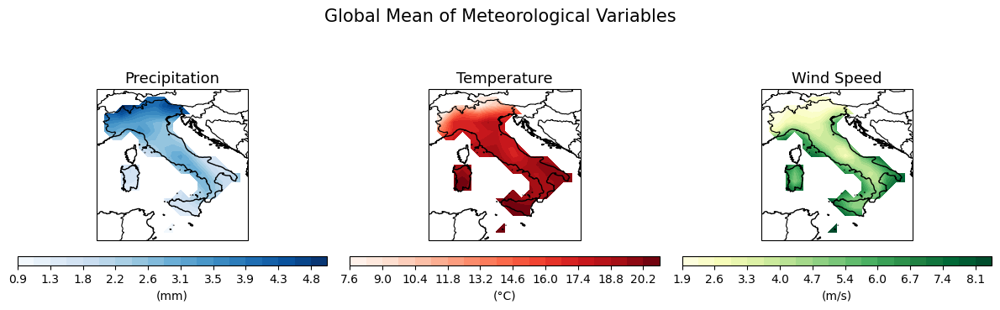

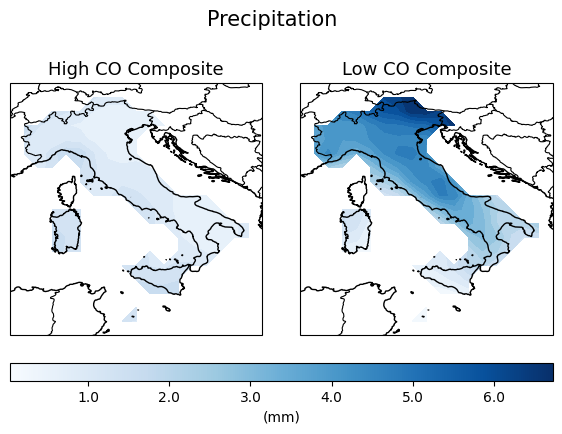

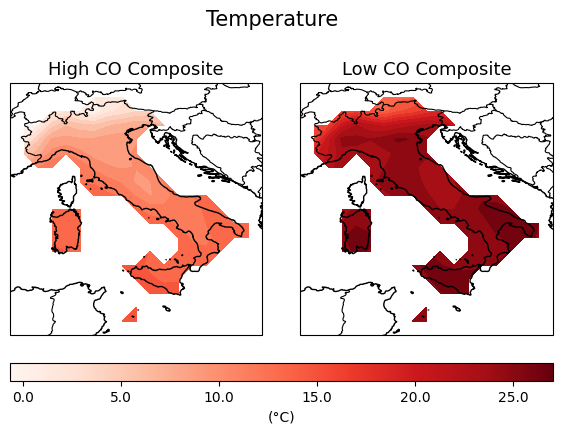

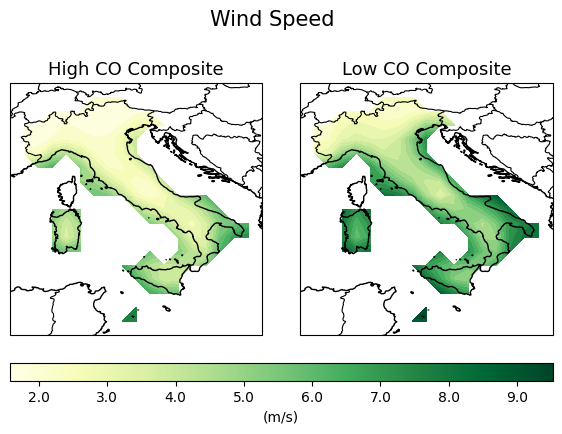

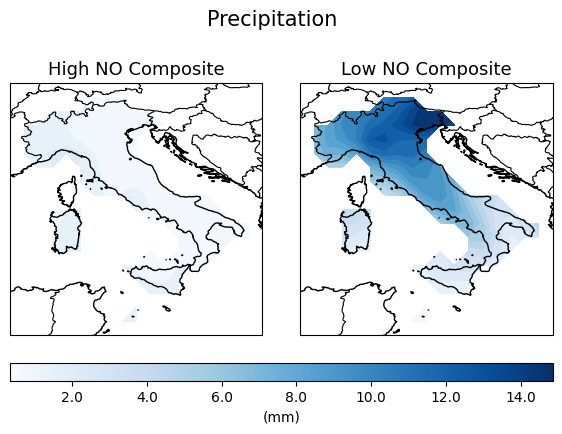

...

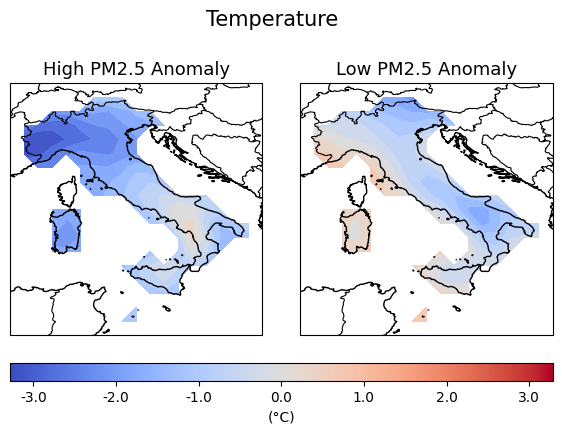

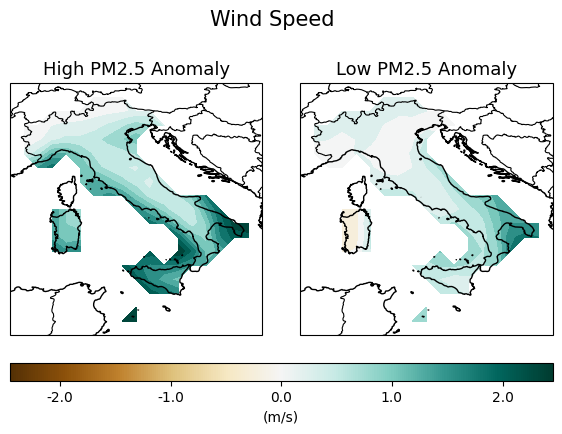

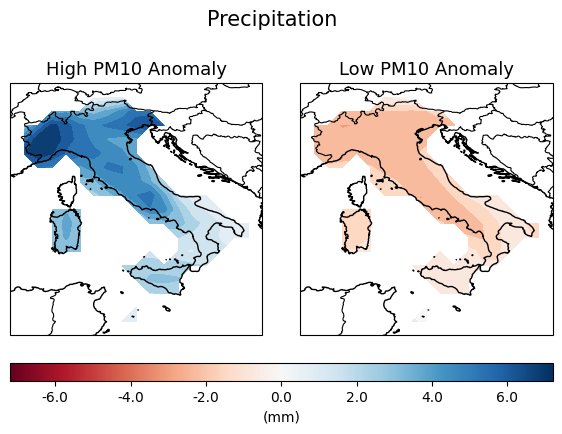

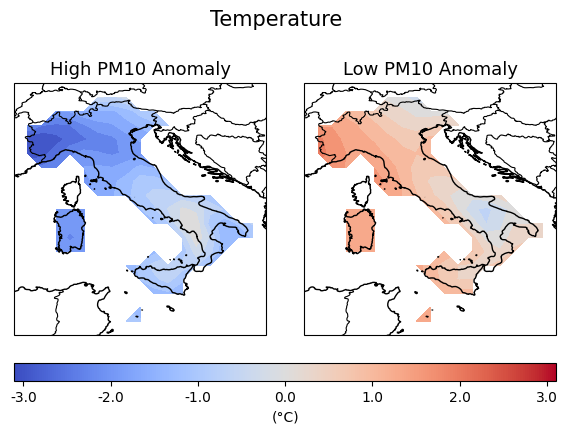

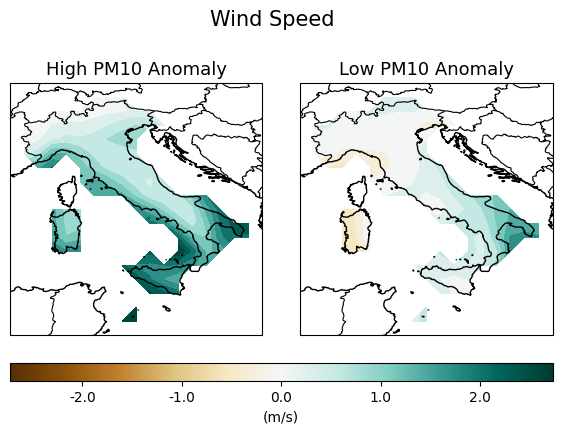


Code execution finished. Composites and Anomalies now plotted without difference fields.


In [8]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import matplotlib.colors as colors
import matplotlib.cm as cm
from matplotlib.ticker import FormatStrFormatter, MaxNLocator
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.colors as mcolors

# ------------------------------
# USER INPUTS
# ------------------------------

pollutant_files = {
    'CO':    r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':    r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO2':   r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM2.5': r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM10':  r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

meteo_vars = {
    "precip_Total_Precipitation": ("mm", "Blues"),
    "temp_Max": ("°C", "Reds"),
    "wind_Max": ("m/s", "YlGn")
}

meteo_var_names = {
    "precip_Total_Precipitation": "Precipitation",
    "temp_Max": "Temperature",
    "wind_Max": "Wind Speed"
}

# Colormaps for anomaly plots (diverging)
anomaly_cmaps = {
    "precip_Total_Precipitation": "RdBu",
    "temp_Max": "coolwarm",
    "wind_Max": "BrBG"
}

global_mean_output_file = r"D:\IPMA\Results\global_mean_meteo_Italy.nc" 
composite_output_dir = r"D:\IPMA\Results"

# --- Helper functions ---
def apply_unit_conversions(ds, pollutant_name):
    if pollutant_name == 'CO' and 'Mean' in ds:
        ds['Mean'] = ds['Mean'] * 1000
        if 'units' in ds['Mean'].attrs and ds['Mean'].attrs['units'] == 'mg/m3':
            ds['Mean'].attrs['units'] = 'µg/m3'
    
    precip_var = "precip_Total_Precipitation"
    if precip_var in ds:
        ds[precip_var] = ds[precip_var] * 1000
        if 'units' in ds[precip_var].attrs and ds[precip_var].attrs['units'] == 'm':
            ds[precip_var].attrs['units'] = 'mm'

    return ds

def set_composite_attrs(da, comp_type, var_name, pollutant, unit, N_days):
    da.name = f'{var_name}_{comp_type}'
    da.attrs['units'] = unit
    da.attrs['long_name'] = f'{comp_type} Composite of {meteo_var_names[var_name]} based on {pollutant} extremes'
    da.attrs['N_days'] = N_days
    return da

def calculate_dynamic_extent(data_array):
    mask = np.isfinite(data_array.values)
    if not mask.any(): return None

    lat_vals = data_array["latitude"].values
    lon_vals = data_array["longitude"].values

    valid_idx = np.where(mask)
    unique_lat_idx = np.unique(valid_idx[0])
    unique_lon_idx = np.unique(valid_idx[1])

    lat_step = lat_vals[1] - lat_vals[0] if len(lat_vals) > 1 else 0.5
    lon_step = lon_vals[1] - lon_vals[0] if len(lon_vals) > 1 else 0.5

    lat_min_ext = max(lat_vals[unique_lat_idx].min() - lat_step, lat_vals.min())
    lat_max_ext = min(lat_vals[unique_lat_idx].max() + lat_step, lat_vals.max())
    lon_min_ext = max(lon_vals[unique_lon_idx].min() - lon_step, lon_vals.min())
    lon_max_ext = min(lon_vals[unique_lon_idx].max() + lon_step, lon_vals.max())
    
    return [lon_min_ext, lon_max_ext, lat_min_ext, lat_max_ext]

# ------------------------------
# PART 1: GLOBAL MEAN CALCULATION
# ------------------------------

print("--- Part 1: Calculating & Saving Global Mean (Climatology) ---")
reference_pollutant = 'CO'
reference_file = pollutant_files[reference_pollutant]

try:
    ds_ref = xr.open_dataset(reference_file)
except FileNotFoundError:
    print(f"ERROR: Reference file not found at {reference_file}. Exiting.")
    exit()

ds_ref = apply_unit_conversions(ds_ref, reference_pollutant)
global_means = {}
for var_name, (unit, cmap) in meteo_vars.items():
    mean_da = ds_ref[var_name].mean(dim='time')
    mean_da.attrs['units'] = unit
    mean_da.attrs['long_name'] = f'Time-Mean of {meteo_var_names[var_name]}'
    global_means[var_name] = mean_da

ds_global_mean = xr.Dataset(global_means)
output_dir = os.path.dirname(global_mean_output_file)
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
ds_global_mean.to_netcdf(global_mean_output_file, mode='w')
print(f"Global Mean data successfully saved to {global_mean_output_file}.")

# ------------------------------
# PART 2: COMPOSITING & ANOMALY CALCULATION
# ------------------------------

print("\n--- Part 2: Compositing Analysis and Saving Composites ---")
if not os.path.exists(composite_output_dir):
    os.makedirs(composite_output_dir)

all_composite_results = {}

for target_pollutant, target_file in pollutant_files.items():
    
    try:
        ds = xr.open_dataset(target_file)
    except FileNotFoundError:
        print(f"Skipping {target_pollutant}: File not found at {target_file}")
        continue
        
    ds = apply_unit_conversions(ds, target_pollutant)

    # --- NEW: Compute N_days as 1% of total days ---
    total_days = len(ds['time'])
    N_days = max(1, int(np.ceil(0.01 * total_days)))
    print(f"\n[{target_pollutant}] Selecting {N_days} days")
        
    pollutant_time_series = ds['Mean'].mean(dim=['latitude', 'longitude'])
    ranked_series = pollutant_time_series.to_series().sort_values(ascending=False)
    high_days_time_stamps = ranked_series.index[:N_days]
    low_days_time_stamps = ranked_series.index[-N_days:]

    # --------------------------------------------------
    # PRINT RANGE OF POLLUTANT CONCENTRATIONS (High / Low)
    # --------------------------------------------------

    # Extract pollutant concentrations for selected days
    high_vals = ds['Mean'].sel(time=high_days_time_stamps)
    low_vals  = ds['Mean'].sel(time=low_days_time_stamps)

    # Spatial mean for each selected day
    high_vals_mean = high_vals.mean(dim=['latitude', 'longitude'])
    low_vals_mean  = low_vals.mean(dim=['latitude', 'longitude'])

    # Compute ranges
    high_min = float(high_vals_mean.min().values)
    high_max = float(high_vals_mean.max().values)
    low_min  = float(low_vals_mean.min().values)
    low_max  = float(low_vals_mean.max().values)

    units = ds['Mean'].attrs.get('units', 'unknown')

    print(f"\n[{target_pollutant}] Pollutant concentration ranges (N={N_days})")
    print(f"  High days: min = {high_min:.2f}, max = {high_max:.2f} ({units})")
    print(f"  Low  days: min = {low_min:.2f}, max = {low_max:.2f} ({units})")

    composite_data_vars = {} 
    composite_results_pollutant = {}

    for var_name, (unit, cmap) in meteo_vars.items():
        
        # Composites
        high_composite = ds[var_name].sel(time=high_days_time_stamps).mean(dim='time')
        low_composite = ds[var_name].sel(time=low_days_time_stamps).mean(dim='time')
        
        # Anomalies
        global_mean_data = global_means[var_name]
        high_anomaly = high_composite - global_mean_data 
        low_anomaly = low_composite - global_mean_data  

        # Store results for plotting
        composite_results_pollutant[var_name] = {
            'High_Comp': high_composite, 
            'Low_Comp': low_composite,   
            'High_Anomaly': high_anomaly,
            'Low_Anomaly': low_anomaly,
            'unit': unit,
            'cmap': cmap
        }

        # Store all generated fields for NetCDF saving
        composite_data_vars[f'{var_name}_High_Comp'] = set_composite_attrs(high_composite.copy(), 'High_Comp', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_Low_Comp'] = set_composite_attrs(low_composite.copy(), 'Low_Comp', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_High_Anom'] = set_composite_attrs(high_anomaly.copy(), 'High_Anom', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_Low_Anom'] = set_composite_attrs(low_anomaly.copy(), 'Low_Anom', var_name, target_pollutant, unit, N_days)

    all_composite_results[target_pollutant] = composite_results_pollutant
    
    # Save composites to NetCDF
    composite_file_name = f"{target_pollutant}_composite_meteo_Italy.nc"
    output_path = os.path.join(composite_output_dir, composite_file_name)
    ds_composite = xr.Dataset(
        composite_data_vars,
        coords={'latitude': high_composite['latitude'], 'longitude': high_composite['longitude']}
    )
    ds_composite.attrs['title'] = f'Composite Analysis for {target_pollutant} Extremes (N={N_days})'
    ds_composite.to_netcdf(output_path, mode='w')
    
print("Data processing complete. Starting visualizations.")

# ------------------------------
# PART 3: VISUALIZATION (contourf)
# ------------------------------

print("\n--- Part 3: Generating Visualization Plots (contourf, single colorbar, 1 decimal) ---")
num_cols = len(meteo_vars)
meteo_list = list(meteo_vars.keys())

reference_data_for_extent = ds_global_mean[meteo_list[0]]
global_extent = calculate_dynamic_extent(reference_data_for_extent)
if global_extent is None:
    global_extent = [ds_global_mean.longitude.min().item(), ds_global_mean.longitude.max().item(), 
                     ds_global_mean.latitude.min().item(), ds_global_mean.latitude.max().item()]

TITLE_FONT_SIZE = 15
SUBTITLE_FONT_SIZE = 13
AXIS_FONT_SIZE = 11
CBAR_FONT_SIZE = 10
NUM_LEVELS = 20  # number of contour levels

# --- Global Mean Climatologies ---
fig1, axes1 = plt.subplots(
    1, num_cols, figsize=(4 * num_cols, 3.5),
    subplot_kw={'projection': ccrs.PlateCarree()}
)
if num_cols == 1: axes1 = [axes1]

for i, var_name in enumerate(meteo_list):
    ax = axes1[i]
    mean_data = global_means[var_name]
    unit, cmap = meteo_vars[var_name]
    var_display_name = meteo_var_names[var_name]

    lons, lats = np.meshgrid(mean_data['longitude'], mean_data['latitude'])
    levels = np.linspace(np.nanmin(mean_data.values), np.nanmax(mean_data.values), NUM_LEVELS)
    
    plot = ax.contourf(
        lons, lats, mean_data.values,
        levels=levels, cmap=cmap, transform=ccrs.PlateCarree()
    )
    ax.set_extent(global_extent, crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linewidth=0.8)
    ax.set_title(f"{var_display_name}", fontsize=SUBTITLE_FONT_SIZE)
    ax.set_xlabel("Longitude", fontsize=AXIS_FONT_SIZE)
    ax.set_ylabel("Latitude", fontsize=AXIS_FONT_SIZE)

    cbar = fig1.colorbar(plot, ax=ax, orientation='horizontal', pad=0.08, aspect=35)
    cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
    cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

fig1.suptitle("Global Mean of Meteorological Variables", fontsize=TITLE_FONT_SIZE, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# --- Raw Composites ---
for pollutant in pollutant_files.keys():
    if pollutant not in all_composite_results:
        continue

    for var_name in meteo_list:
        result = all_composite_results[pollutant][var_name]

        high_comp = result['High_Comp']
        low_comp = result['Low_Comp']
        unit, cmap = result['unit'], result['cmap']
        var_display_name = meteo_var_names[var_name]

        vmin = np.nanmin([high_comp.values, low_comp.values])
        vmax = np.nanmax([high_comp.values, low_comp.values])
        levels = np.linspace(vmin, vmax, NUM_LEVELS)

        fig, axes = plt.subplots(
            1, 2, figsize=(7, 5),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )

        # --- High composite ---
        lons, lats = np.meshgrid(high_comp.longitude, high_comp.latitude)
        axes[0].contourf(
            lons, lats, high_comp,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[0].set_title(f"High {pollutant} Composite", fontsize=SUBTITLE_FONT_SIZE)
        axes[0].set_extent(global_extent)
        axes[0].coastlines()
        axes[0].add_feature(cfeature.BORDERS, linewidth=0.8)
        axes[0].set_ylabel("Latitude")

        # --- Low composite ---
        lons, lats = np.meshgrid(low_comp.longitude, low_comp.latitude)
        axes[1].contourf(
            lons, lats, low_comp,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[1].set_title(f"Low {pollutant} Composite", fontsize=SUBTITLE_FONT_SIZE)
        axes[1].set_extent(global_extent)
        axes[1].coastlines()
        axes[1].add_feature(cfeature.BORDERS, linewidth=0.8)

        # 🔑 Reserve space BEFORE colorbar
        fig.subplots_adjust(bottom=0.22, top=0.90, wspace=0.15)

        # --- Shared colorbar (always below maps) ---
        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin=vmin, vmax=vmax), cmap=cmap),
            ax=axes,
            orientation='horizontal',
            fraction=0.08,
            pad=0.08,
            aspect=30
        )
        cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
        cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

        fig.suptitle( f"{var_display_name}", fontsize=TITLE_FONT_SIZE )

        plt.show()


# --- Composite Anomalies ---
for pollutant in pollutant_files.keys():
    if pollutant not in all_composite_results:
        continue

    for var_name in meteo_list:
        result = all_composite_results[pollutant][var_name]

        high_anom = result['High_Anomaly']
        low_anom = result['Low_Anomaly']
        unit = result['unit']
        cmap = anomaly_cmaps.get(var_name, 'RdBu_r')
        var_display_name = meteo_var_names[var_name]

        vmax = np.nanmax(np.abs([high_anom.values, low_anom.values]))
        levels = np.linspace(-vmax, vmax, NUM_LEVELS)

        fig, axes = plt.subplots(
            1, 2, figsize=(7, 5),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )

        # --- High anomaly ---
        lons, lats = np.meshgrid(high_anom.longitude, high_anom.latitude)
        axes[0].contourf(
            lons, lats, high_anom,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[0].set_title(f"High {pollutant} Anomaly", fontsize=SUBTITLE_FONT_SIZE)
        axes[0].set_extent(global_extent)
        axes[0].coastlines()
        axes[0].add_feature(cfeature.BORDERS, linewidth=0.8)
        axes[0].set_ylabel("Latitude")

        # --- Low anomaly ---
        lons, lats = np.meshgrid(low_anom.longitude, low_anom.latitude)
        axes[1].contourf(
            lons, lats, low_anom,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[1].set_title(f"Low {pollutant} Anomaly", fontsize=SUBTITLE_FONT_SIZE)
        axes[1].set_extent(global_extent)
        axes[1].coastlines()
        axes[1].add_feature(cfeature.BORDERS, linewidth=0.8)

        # 🔑 Reserve space BEFORE colorbar
        fig.subplots_adjust(bottom=0.22, top=0.90, wspace=0.15)

        # --- Shared anomaly colorbar ---
        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin=-vmax, vmax=vmax), cmap=cmap),
            ax=axes,
            orientation='horizontal',
            fraction=0.08,
            pad=0.08,
            aspect=30
        )
        cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
        cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)
        fig.suptitle( f"{var_display_name}", fontsize=TITLE_FONT_SIZE )

        plt.show()


print("\nCode execution finished. Composites and Anomalies now plotted without difference fields.")


#### Greece

--- Part 1: Calculating & Saving Global Mean (Climatology) ---
Global Mean data successfully saved to D:\IPMA\Results\global_mean_meteo_Greece.nc.

--- Part 2: Compositing Analysis and Saving Composites ---

[CO] Selecting 81 days

[CO] Pollutant concentration ranges (N=81)
  High days: min = 284.77, max = 1342.44 (unknown)
  Low  days: min = 108.21, max = 126.43 (unknown)

[NO] Selecting 81 days

[NO] Pollutant concentration ranges (N=81)
  High days: min = 2.63, max = 24.11 (unknown)
  Low  days: min = 0.04, max = 0.06 (unknown)

[NO2] Selecting 81 days

[NO2] Pollutant concentration ranges (N=81)
  High days: min = 9.69, max = 19.99 (unknown)
  Low  days: min = 1.13, max = 1.73 (unknown)

[PM2.5] Selecting 81 days

[PM2.5] Pollutant concentration ranges (N=81)
  High days: min = 42.46, max = 136.46 (unknown)
  Low  days: min = 0.82, max = 3.40 (unknown)

[PM10] Selecting 81 days

[PM10] Pollutant concentration ranges (N=81)
  High days: min = 56.82, max = 190.62 (unknown)
  Low  day

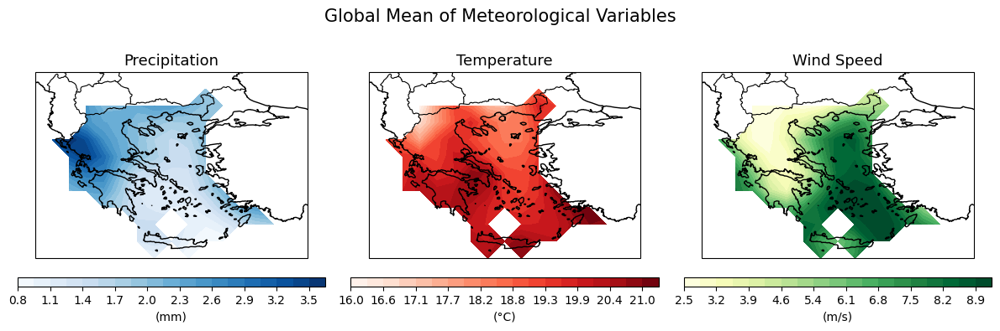

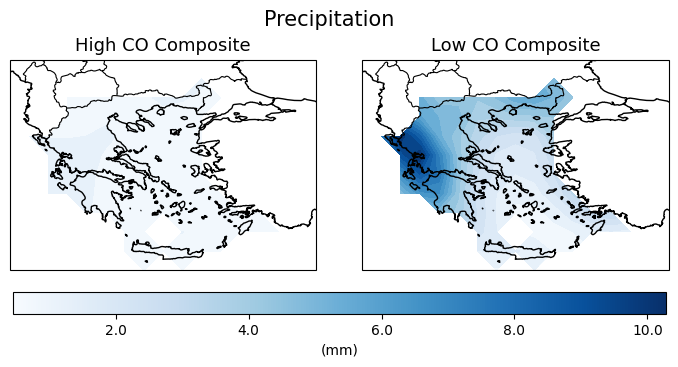

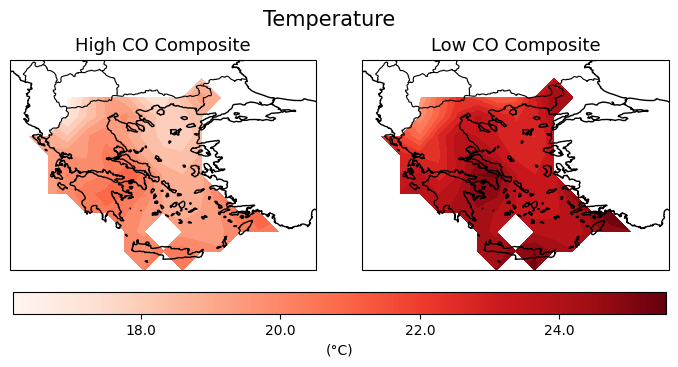

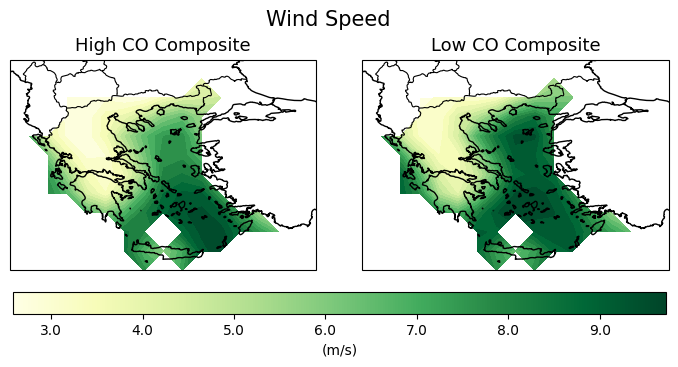

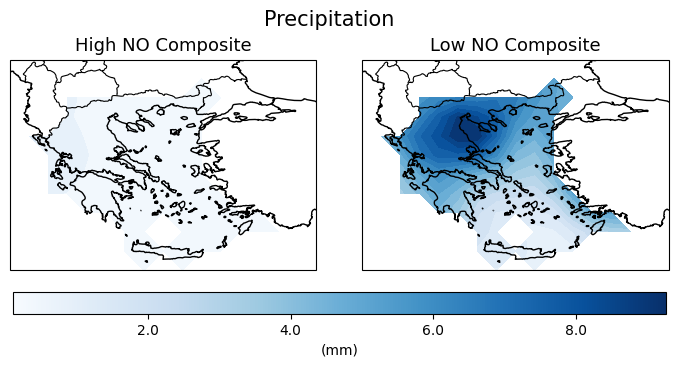

...

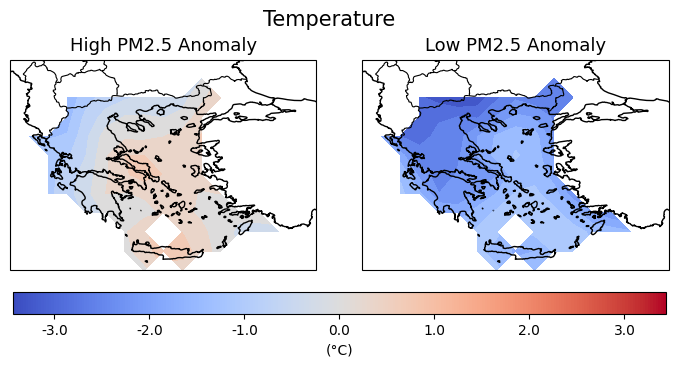

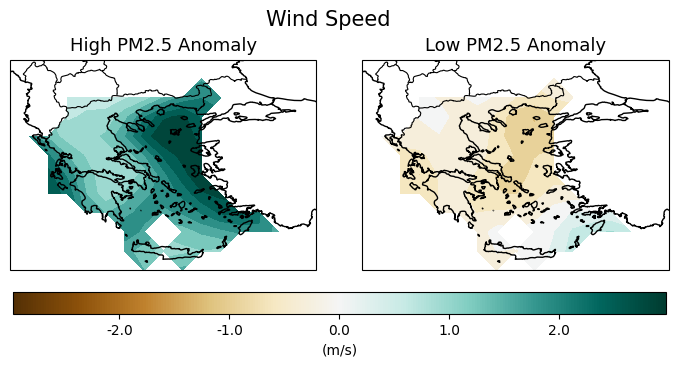

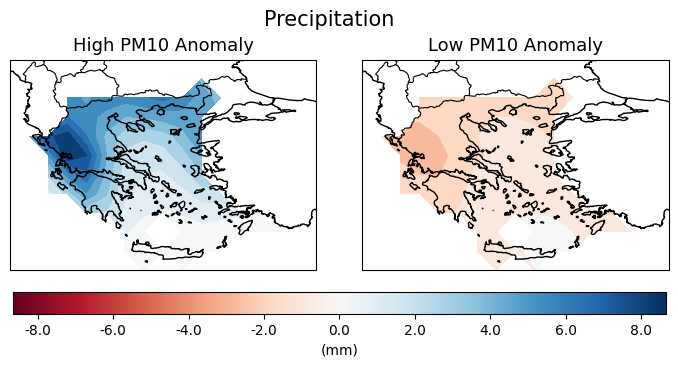

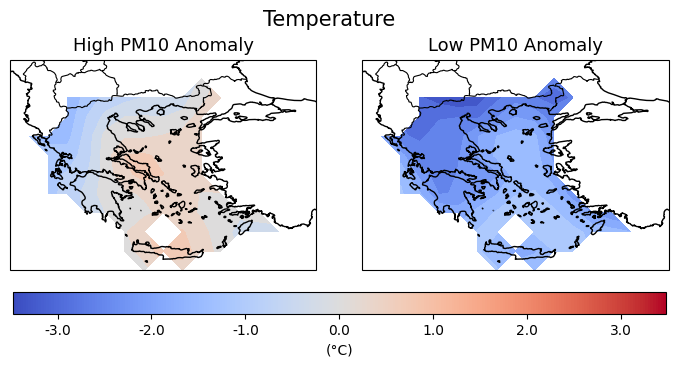

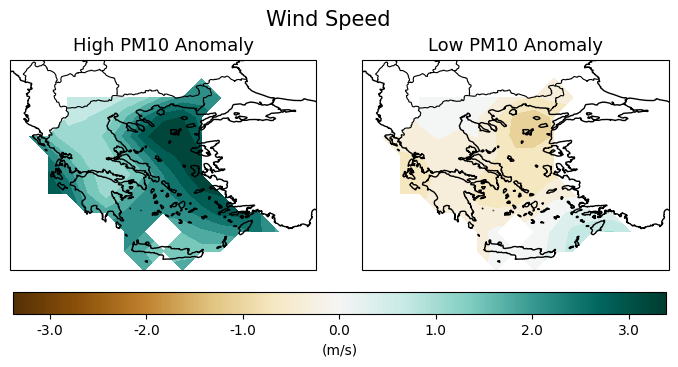


Code execution finished. Composites and Anomalies now plotted without difference fields.


In [9]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import matplotlib.colors as colors
import matplotlib.cm as cm
from matplotlib.ticker import FormatStrFormatter, MaxNLocator
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.colors as mcolors

# ------------------------------
# USER INPUTS
# ------------------------------

pollutant_files = {
    'CO':    r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':    r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO2':   r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM2.5': r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM10':  r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

meteo_vars = {
    "precip_Total_Precipitation": ("mm", "Blues"),
    "temp_Max": ("°C", "Reds"),
    "wind_Max": ("m/s", "YlGn")
}

meteo_var_names = {
    "precip_Total_Precipitation": "Precipitation",
    "temp_Max": "Temperature",
    "wind_Max": "Wind Speed"
}

# Colormaps for anomaly plots (diverging)
anomaly_cmaps = {
    "precip_Total_Precipitation": "RdBu",
    "temp_Max": "coolwarm",
    "wind_Max": "BrBG"
}

global_mean_output_file = r"D:\IPMA\Results\global_mean_meteo_Greece.nc" 
composite_output_dir = r"D:\IPMA\Results"

# --- Helper functions ---
def apply_unit_conversions(ds, pollutant_name):
    if pollutant_name == 'CO' and 'Mean' in ds:
        ds['Mean'] = ds['Mean'] * 1000
        if 'units' in ds['Mean'].attrs and ds['Mean'].attrs['units'] == 'mg/m3':
            ds['Mean'].attrs['units'] = 'µg/m3'
    
    precip_var = "precip_Total_Precipitation"
    if precip_var in ds:
        ds[precip_var] = ds[precip_var] * 1000
        if 'units' in ds[precip_var].attrs and ds[precip_var].attrs['units'] == 'm':
            ds[precip_var].attrs['units'] = 'mm'

    return ds

def set_composite_attrs(da, comp_type, var_name, pollutant, unit, N_days):
    da.name = f'{var_name}_{comp_type}'
    da.attrs['units'] = unit
    da.attrs['long_name'] = f'{comp_type} Composite of {meteo_var_names[var_name]} based on {pollutant} extremes'
    da.attrs['N_days'] = N_days
    return da

def calculate_dynamic_extent(data_array):
    mask = np.isfinite(data_array.values)
    if not mask.any(): return None

    lat_vals = data_array["latitude"].values
    lon_vals = data_array["longitude"].values

    valid_idx = np.where(mask)
    unique_lat_idx = np.unique(valid_idx[0])
    unique_lon_idx = np.unique(valid_idx[1])

    lat_step = lat_vals[1] - lat_vals[0] if len(lat_vals) > 1 else 0.5
    lon_step = lon_vals[1] - lon_vals[0] if len(lon_vals) > 1 else 0.5

    lat_min_ext = max(lat_vals[unique_lat_idx].min() - lat_step, lat_vals.min())
    lat_max_ext = min(lat_vals[unique_lat_idx].max() + lat_step, lat_vals.max())
    lon_min_ext = max(lon_vals[unique_lon_idx].min() - lon_step, lon_vals.min())
    lon_max_ext = min(lon_vals[unique_lon_idx].max() + lon_step, lon_vals.max())
    
    return [lon_min_ext, lon_max_ext, lat_min_ext, lat_max_ext]

# ------------------------------
# PART 1: GLOBAL MEAN CALCULATION
# ------------------------------

print("--- Part 1: Calculating & Saving Global Mean (Climatology) ---")
reference_pollutant = 'CO'
reference_file = pollutant_files[reference_pollutant]

try:
    ds_ref = xr.open_dataset(reference_file)
except FileNotFoundError:
    print(f"ERROR: Reference file not found at {reference_file}. Exiting.")
    exit()

ds_ref = apply_unit_conversions(ds_ref, reference_pollutant)
global_means = {}
for var_name, (unit, cmap) in meteo_vars.items():
    mean_da = ds_ref[var_name].mean(dim='time')
    mean_da.attrs['units'] = unit
    mean_da.attrs['long_name'] = f'Time-Mean of {meteo_var_names[var_name]}'
    global_means[var_name] = mean_da

ds_global_mean = xr.Dataset(global_means)
output_dir = os.path.dirname(global_mean_output_file)
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
ds_global_mean.to_netcdf(global_mean_output_file, mode='w')
print(f"Global Mean data successfully saved to {global_mean_output_file}.")

# ------------------------------
# PART 2: COMPOSITING & ANOMALY CALCULATION
# ------------------------------

print("\n--- Part 2: Compositing Analysis and Saving Composites ---")
if not os.path.exists(composite_output_dir):
    os.makedirs(composite_output_dir)

all_composite_results = {}

for target_pollutant, target_file in pollutant_files.items():
    
    try:
        ds = xr.open_dataset(target_file)
    except FileNotFoundError:
        print(f"Skipping {target_pollutant}: File not found at {target_file}")
        continue
        
    ds = apply_unit_conversions(ds, target_pollutant)

    # --- NEW: Compute N_days as 1% of total days ---
    total_days = len(ds['time'])
    N_days = max(1, int(np.ceil(0.01 * total_days)))
    print(f"\n[{target_pollutant}] Selecting {N_days} days")
        
    pollutant_time_series = ds['Mean'].mean(dim=['latitude', 'longitude'])
    ranked_series = pollutant_time_series.to_series().sort_values(ascending=False)
    high_days_time_stamps = ranked_series.index[:N_days]
    low_days_time_stamps = ranked_series.index[-N_days:]

    # --------------------------------------------------
    # PRINT RANGE OF POLLUTANT CONCENTRATIONS (High / Low)
    # --------------------------------------------------

    # Extract pollutant concentrations for selected days
    high_vals = ds['Mean'].sel(time=high_days_time_stamps)
    low_vals  = ds['Mean'].sel(time=low_days_time_stamps)

    # Spatial mean for each selected day
    high_vals_mean = high_vals.mean(dim=['latitude', 'longitude'])
    low_vals_mean  = low_vals.mean(dim=['latitude', 'longitude'])

    # Compute ranges
    high_min = float(high_vals_mean.min().values)
    high_max = float(high_vals_mean.max().values)
    low_min  = float(low_vals_mean.min().values)
    low_max  = float(low_vals_mean.max().values)

    units = ds['Mean'].attrs.get('units', 'unknown')

    print(f"\n[{target_pollutant}] Pollutant concentration ranges (N={N_days})")
    print(f"  High days: min = {high_min:.2f}, max = {high_max:.2f} ({units})")
    print(f"  Low  days: min = {low_min:.2f}, max = {low_max:.2f} ({units})")

    composite_data_vars = {} 
    composite_results_pollutant = {}

    for var_name, (unit, cmap) in meteo_vars.items():
        
        # Composites
        high_composite = ds[var_name].sel(time=high_days_time_stamps).mean(dim='time')
        low_composite = ds[var_name].sel(time=low_days_time_stamps).mean(dim='time')
        
        # Anomalies
        global_mean_data = global_means[var_name]
        high_anomaly = high_composite - global_mean_data 
        low_anomaly = low_composite - global_mean_data  

        # Store results for plotting
        composite_results_pollutant[var_name] = {
            'High_Comp': high_composite, 
            'Low_Comp': low_composite,   
            'High_Anomaly': high_anomaly,
            'Low_Anomaly': low_anomaly,
            'unit': unit,
            'cmap': cmap
        }

        # Store all generated fields for NetCDF saving
        composite_data_vars[f'{var_name}_High_Comp'] = set_composite_attrs(high_composite.copy(), 'High_Comp', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_Low_Comp'] = set_composite_attrs(low_composite.copy(), 'Low_Comp', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_High_Anom'] = set_composite_attrs(high_anomaly.copy(), 'High_Anom', var_name, target_pollutant, unit, N_days)
        composite_data_vars[f'{var_name}_Low_Anom'] = set_composite_attrs(low_anomaly.copy(), 'Low_Anom', var_name, target_pollutant, unit, N_days)

    all_composite_results[target_pollutant] = composite_results_pollutant
    
    # Save composites to NetCDF
    composite_file_name = f"{target_pollutant}_composite_meteo_Greece.nc"
    output_path = os.path.join(composite_output_dir, composite_file_name)
    ds_composite = xr.Dataset(
        composite_data_vars,
        coords={'latitude': high_composite['latitude'], 'longitude': high_composite['longitude']}
    )
    ds_composite.attrs['title'] = f'Composite Analysis for {target_pollutant} Extremes (N={N_days})'
    ds_composite.to_netcdf(output_path, mode='w')
    
print("Data processing complete. Starting visualizations.")

# ------------------------------
# PART 3: VISUALIZATION (contourf)
# ------------------------------

print("\n--- Part 3: Generating Visualization Plots (contourf, single colorbar, 1 decimal) ---")
num_cols = len(meteo_vars)
meteo_list = list(meteo_vars.keys())

reference_data_for_extent = ds_global_mean[meteo_list[0]]
global_extent = calculate_dynamic_extent(reference_data_for_extent)
if global_extent is None:
    global_extent = [ds_global_mean.longitude.min().item(), ds_global_mean.longitude.max().item(), 
                     ds_global_mean.latitude.min().item(), ds_global_mean.latitude.max().item()]

TITLE_FONT_SIZE = 15
SUBTITLE_FONT_SIZE = 13
AXIS_FONT_SIZE = 11
CBAR_FONT_SIZE = 10
NUM_LEVELS = 20  # number of contour levels

# --- Global Mean Climatologies ---
fig1, axes1 = plt.subplots(
    1, num_cols, figsize=(4 * num_cols, 3.8),
    subplot_kw={'projection': ccrs.PlateCarree()}
)
if num_cols == 1: axes1 = [axes1]

for i, var_name in enumerate(meteo_list):
    ax = axes1[i]
    mean_data = global_means[var_name]
    unit, cmap = meteo_vars[var_name]
    var_display_name = meteo_var_names[var_name]

    lons, lats = np.meshgrid(mean_data['longitude'], mean_data['latitude'])
    levels = np.linspace(np.nanmin(mean_data.values), np.nanmax(mean_data.values), NUM_LEVELS)
    
    plot = ax.contourf(
        lons, lats, mean_data.values,
        levels=levels, cmap=cmap, transform=ccrs.PlateCarree()
    )
    ax.set_extent(global_extent, crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linewidth=0.8)
    ax.set_title(f"{var_display_name}", fontsize=SUBTITLE_FONT_SIZE)
    ax.set_xlabel("Longitude", fontsize=AXIS_FONT_SIZE)
    ax.set_ylabel("Latitude", fontsize=AXIS_FONT_SIZE)

    cbar = fig1.colorbar(plot, ax=ax, orientation='horizontal', pad=0.08, aspect=35)
    cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
    cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

fig1.suptitle("Global Mean of Meteorological Variables", fontsize=TITLE_FONT_SIZE, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# --- Raw Composites ---
for pollutant in pollutant_files.keys():
    if pollutant not in all_composite_results:
        continue

    for var_name in meteo_list:
        result = all_composite_results[pollutant][var_name]

        high_comp = result['High_Comp']
        low_comp = result['Low_Comp']
        unit, cmap = result['unit'], result['cmap']
        var_display_name = meteo_var_names[var_name]

        vmin = np.nanmin([high_comp.values, low_comp.values])
        vmax = np.nanmax([high_comp.values, low_comp.values])
        levels = np.linspace(vmin, vmax, NUM_LEVELS)

        fig, axes = plt.subplots(
            1, 2, figsize=(8.5, 4),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )

        # --- High composite ---
        lons, lats = np.meshgrid(high_comp.longitude, high_comp.latitude)
        axes[0].contourf(
            lons, lats, high_comp,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[0].set_title(f"High {pollutant} Composite", fontsize=SUBTITLE_FONT_SIZE)
        axes[0].set_extent(global_extent)
        axes[0].coastlines()
        axes[0].add_feature(cfeature.BORDERS, linewidth=0.8)
        axes[0].set_ylabel("Latitude")

        # --- Low composite ---
        lons, lats = np.meshgrid(low_comp.longitude, low_comp.latitude)
        axes[1].contourf(
            lons, lats, low_comp,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[1].set_title(f"Low {pollutant} Composite", fontsize=SUBTITLE_FONT_SIZE)
        axes[1].set_extent(global_extent)
        axes[1].coastlines()
        axes[1].add_feature(cfeature.BORDERS, linewidth=0.8)

        # 🔑 Reserve space BEFORE colorbar
        fig.subplots_adjust(bottom=0.22, top=0.90, wspace=0.15)

        # --- Shared colorbar (always below maps) ---
        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin=vmin, vmax=vmax), cmap=cmap),
            ax=axes,
            orientation='horizontal',
            fraction=0.08,
            pad=0.08,
            aspect=30
        )
        cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
        cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)

        fig.suptitle( f"{var_display_name}", fontsize=TITLE_FONT_SIZE )

        plt.show()


# --- Composite Anomalies ---
for pollutant in pollutant_files.keys():
    if pollutant not in all_composite_results:
        continue

    for var_name in meteo_list:
        result = all_composite_results[pollutant][var_name]

        high_anom = result['High_Anomaly']
        low_anom = result['Low_Anomaly']
        unit = result['unit']
        cmap = anomaly_cmaps.get(var_name, 'RdBu_r')
        var_display_name = meteo_var_names[var_name]

        vmax = np.nanmax(np.abs([high_anom.values, low_anom.values]))
        levels = np.linspace(-vmax, vmax, NUM_LEVELS)

        fig, axes = plt.subplots(
            1, 2, figsize=(8.5, 4),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )

        # --- High anomaly ---
        lons, lats = np.meshgrid(high_anom.longitude, high_anom.latitude)
        axes[0].contourf(
            lons, lats, high_anom,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[0].set_title(f"High {pollutant} Anomaly", fontsize=SUBTITLE_FONT_SIZE)
        axes[0].set_extent(global_extent)
        axes[0].coastlines()
        axes[0].add_feature(cfeature.BORDERS, linewidth=0.8)
        axes[0].set_ylabel("Latitude")

        # --- Low anomaly ---
        lons, lats = np.meshgrid(low_anom.longitude, low_anom.latitude)
        axes[1].contourf(
            lons, lats, low_anom,
            levels=levels, cmap=cmap, extend='both',
            transform=ccrs.PlateCarree()
        )
        axes[1].set_title(f"Low {pollutant} Anomaly", fontsize=SUBTITLE_FONT_SIZE)
        axes[1].set_extent(global_extent)
        axes[1].coastlines()
        axes[1].add_feature(cfeature.BORDERS, linewidth=0.8)

        # 🔑 Reserve space BEFORE colorbar
        fig.subplots_adjust(bottom=0.22, top=0.90, wspace=0.15)

        # --- Shared anomaly colorbar ---
        cbar = fig.colorbar(
            cm.ScalarMappable(norm=colors.Normalize(vmin=-vmax, vmax=vmax), cmap=cmap),
            ax=axes,
            orientation='horizontal',
            fraction=0.08,
            pad=0.08,
            aspect=30
        )
        cbar.set_label(f"({unit})", fontsize=CBAR_FONT_SIZE)
        cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
        cbar.ax.tick_params(labelsize=CBAR_FONT_SIZE)
        fig.suptitle( f"{var_display_name}", fontsize=TITLE_FONT_SIZE )

        plt.show()


print("\nCode execution finished. Composites and Anomalies now plotted without difference fields.")
